In [23]:
import numpy as np 
import pandas as pd
from glob import glob 
import matplotlib.pyplot as plt
from tensorflow import keras
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
import tensorflow as tf
import cv2
import uuid

In [2]:
# Path for train, validation and test datasets
train1_path = 'final_dataset/train1'
train2_path = 'final_dataset/train2'
test_path = 'final_dataset/test'
val_path = 'final_dataset/val'

IMAGE_SIZE = [224, 224] #Default image size for VGG16 

folders = glob('final_dataset/train1/*') #Get number of classes


# ImageDataGenerator to perform augmentation
train_datagen = ImageDataGenerator(rescale = 1./255, shear_range = 0.2, zoom_range = 0.2, horizontal_flip = True)
test_datagen = ImageDataGenerator(rescale = 1./255)
val_datagen = ImageDataGenerator(rescale = 1./255)


#We create an array of images that can be used for training. 
training_set1 = train_datagen.flow_from_directory('final_dataset/train1',
                                                 target_size = (224, 224),
                                                 batch_size = 32,
                                                 class_mode = 'categorical')

training_set2 = train_datagen.flow_from_directory('final_dataset/train2',
                                                 target_size = (224, 224),
                                                 batch_size = 32,
                                                 class_mode = 'categorical')

test_set = test_datagen.flow_from_directory('final_dataset/test',
                                            target_size = (224, 224),
                                            batch_size = 32,
                                            class_mode = 'categorical')

validation_set = val_datagen.flow_from_directory('final_dataset/val',
                                            target_size = (224, 224),
                                            batch_size = 32,
                                            class_mode = 'categorical')

Found 830 images belonging to 2 classes.
Found 830 images belonging to 2 classes.
Found 209 images belonging to 2 classes.
Found 207 images belonging to 2 classes.


In [3]:
# Creating a VGG19 model. We are not including the dense layers as we don't to classify the images to 1000 classes.
vgg = VGG19(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False) 

# Freezing the base layers 
for layer in vgg.layers:
  layer.trainable = False

x = Flatten()(vgg.output) #Output obtained on vgg16 is now flattened.

# Adding fully connected layers. We use dropout to avoid overfitting
fc1 = Dense(4096, activation='relu')(x)
drp1 = Dropout(0.5)(fc1)
fc2 = Dense(4096, activation='relu')(drp1)
drp2 = Dropout(0.5)(fc2)

prediction = Dense(len(folders), activation='softmax')(drp2) # We have 2 classes, and so, the prediction is being done on len(folders)

#Creating model object 
model = Model(inputs=vgg.input, outputs=prediction)

model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

optimizer = tf.keras.optimizers.experimental.SGD(
    learning_rate=0.001,
    momentum=0.0,
    nesterov=False,
    amsgrad=False,
    weight_decay=None,
    clipnorm=None,
    clipvalue=None,
    global_clipnorm=None,
    use_ema=False,
    ema_momentum=0.99,
    ema_overwrite_frequency=None,
    jit_compile=True,
    name='SGD'
)


In [4]:
#Compile the model 

model.compile(loss='categorical_crossentropy', optimizer=keras.optimizers.Adam(1e-3), metrics=['accuracy']) 
history = model.fit(training_set1, validation_data=validation_set, epochs=20, batch_size=32)

Epoch 1/20
26/26 [==============================] - 24s 787ms/step - loss: 6.6252 - accuracy: 0.5687 - val_loss: 0.6708 - val_accuracy: 0.6667
Epoch 2/20
26/26 [==============================] - 15s 587ms/step - loss: 0.5143 - accuracy: 0.7747 - val_loss: 0.3314 - val_accuracy: 0.8309
Epoch 3/20
26/26 [==============================] - 15s 576ms/step - loss: 0.4903 - accuracy: 0.8024 - val_loss: 0.5549 - val_accuracy: 0.7585
Epoch 4/20
26/26 [==============================] - 15s 581ms/step - loss: 0.3895 - accuracy: 0.8289 - val_loss: 0.3610 - val_accuracy: 0.8309
Epoch 5/20
26/26 [==============================] - 15s 585ms/step - loss: 0.3711 - accuracy: 0.8627 - val_loss: 0.3715 - val_accuracy: 0.8551
Epoch 6/20
26/26 [==============================] - 15s 590ms/step - loss: 0.3179 - accuracy: 0.8831 - val_loss: 0.4259 - val_accuracy: 0.8116
Epoch 7/20
26/26 [==============================] - 15s 591ms/step - loss: 0.2756 - accuracy: 0.8964 - val_loss: 0.3198 - val_accuracy: 0.8551

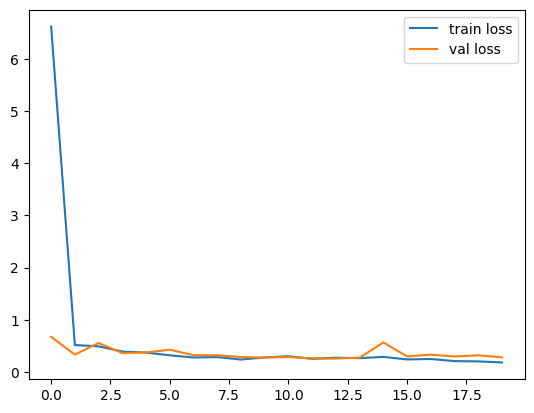

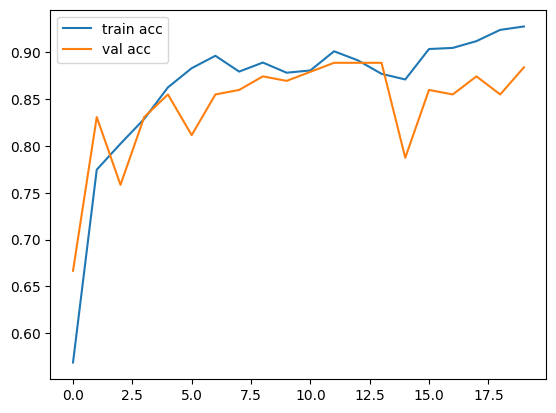

<Figure size 640x480 with 0 Axes>

In [5]:
# loss
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.legend()
plt.show()
plt.savefig('LossVal_loss')

# accuracies
plt.plot(history.history['accuracy'], label='train acc')
plt.plot(history.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

In [6]:
# Unfreeze the base model
for layer in vgg.layers:
  layer.trainable = True

In [16]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [6]:
# optimizer = tf.keras.optimizers.SGD(learning_rate=0.00001, momentum=0.0, nesterov=False, name="SGD")

model.compile(loss='categorical_crossentropy', optimizer=keras.optimizers.Adam(1e-5), metrics=['accuracy']) 
history = model.fit(training_set2, validation_data=validation_set, epochs=20, batch_size=32)

Epoch 1/20
26/26 [==============================] - 46s 2s/step - loss: 0.5291 - accuracy: 0.8084 - val_loss: 0.2731 - val_accuracy: 0.8792
Epoch 2/20
26/26 [==============================] - 26s 1s/step - loss: 0.2999 - accuracy: 0.8687 - val_loss: 0.2474 - val_accuracy: 0.8937
Epoch 3/20
26/26 [==============================] - 26s 1s/step - loss: 0.2192 - accuracy: 0.9133 - val_loss: 0.1964 - val_accuracy: 0.9082
Epoch 4/20
26/26 [==============================] - 26s 990ms/step - loss: 0.1696 - accuracy: 0.9470 - val_loss: 0.1649 - val_accuracy: 0.9179
Epoch 5/20
26/26 [==============================] - 26s 1s/step - loss: 0.1427 - accuracy: 0.9506 - val_loss: 0.1793 - val_accuracy: 0.9130
Epoch 6/20
26/26 [==============================] - 26s 984ms/step - loss: 0.1265 - accuracy: 0.9458 - val_loss: 0.2402 - val_accuracy: 0.8986
Epoch 7/20
26/26 [==============================] - 26s 990ms/step - loss: 0.0710 - accuracy: 0.9795 - val_loss: 0.2221 - val_accuracy: 0.9082
Epoch 8/20


In [7]:
#testing accuracy
score = model.evaluate(test_set, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Test loss: 0.22680240869522095
Test accuracy: 0.9569377899169922


In [8]:
#saving the model
from tensorflow.keras.models import load_model
model_name = 'adam_more_everything.h5'
model.save(model_name)

In [104]:
model_name = 'adam_more_everything.h5'
model = tf.keras.models.load_model(model_name)

In [165]:
import numpy as np
import tensorflow as tf
from tensorflow import keras

# Display
from IPython.display import Image, display
import matplotlib.pyplot as plt
import matplotlib.cm as cm


In [192]:
def get_img_array(img_path, size):
    # `img` is a PIL image of size 224x224
    img = keras.preprocessing.image.load_img(img_path, target_size=size)
    # `array` is a float32 Numpy array of shape (224, 224, 3)
    array = keras.preprocessing.image.img_to_array(img)
    # We add a dimension to transform our array into a "batch"
    # of size (1, 299, 299, 3)
    array = np.expand_dims(array, axis=0)
    return array


def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        print('predicted class: ', 'DAMAGED' if (tf.argmax(preds[0]) == 0) else 'NOT DAMAGED')
        class_channel = preds[:, pred_index]
    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()


In [193]:
from PIL import ImageDraw

In [194]:
def save_and_display_gradcam(img_path, heatmap, dsi_score, predicted_class, cam_path=None, alpha=0.4, should_save=True):
    image_name = str(uuid.uuid4())
    if cam_path == None:
        if not os.path.exists(f'{Path.cwd()}/test_output_damage'):
            os.makedirs(f'{Path.cwd()}/test_output_damage')
        if not os.path.exists(f'{Path.cwd()}/test_output_no_damage'):
            os.makedirs(f'{Path.cwd()}/test_output_no_damage')

        if predicted_class == 0:
            folder_name = 'test_output_damage'
        else:
            folder_name = 'test_output_no_damage'
        cam_path = Path.cwd() / folder_name / (image_name + '_cam.jpg')
    heatmap_path = Path.cwd() / folder_name / (image_name + '_heatmap.jpg')
    img_save_path = Path.cwd() / folder_name / (image_name + '_image.jpg')
    # Load the original image
    img = keras.preprocessing.image.load_img(img_path)
    img_copy = img.copy()
    img = keras.preprocessing.image.img_to_array(img)

    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)
    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap_img = jet_heatmap.copy()
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.preprocessing.image.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.preprocessing.image.array_to_img(superimposed_img)
    # Save the superimposed image
    I1 = ImageDraw.Draw(superimposed_img)
    I1.rectangle(((10, 10), (100, 50)), fill="black")
    I1.text((20, 20), str(dsi_score), fill=(255, 255, 255))
    superimposed_img.save(cam_path)
    if should_save:
        # superimposed_img.save(cam_path)
        jet_heatmap_img = jet_heatmap_img.resize((1400, 1400), 0)
        jet_heatmap_img.save(heatmap_path)
        img_copy.save(img_save_path)

    # Display Grad CAM
    display(Image(cam_path))


In [195]:
def generate_grad_cam(img_path, should_save):
    # model_builder = keras.applications.xception.Xception
    img_size = (224, 224)
    preprocess_input = keras.applications.vgg19.preprocess_input
    decode_predictions = keras.applications.vgg19.decode_predictions

    last_conv_layer_name = "block5_conv4"

    # display(Image(img_path))
    img_array = preprocess_input(get_img_array(img_path, size=img_size))

    # Remove last layer's softmax
    model.layers[-1].activation = None

    # Print what the top predicted class is
    preds = model.predict(img_array)
    print(preds)

    # Generate class activation heatmap
    predicted_class = tf.argmax(preds[0])
    heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name, 0)
    
    #calculate dsi score
    dsi_score = np.average(heatmap)
    print("DSI Score: ", dsi_score)
    
    save_and_display_gradcam(img_path, heatmap, dsi_score, predicted_class, should_save=should_save)

106
[[ 214.53627 -212.62038]]
predicted class:  DAMAGED
DSI Score:  0.26672754


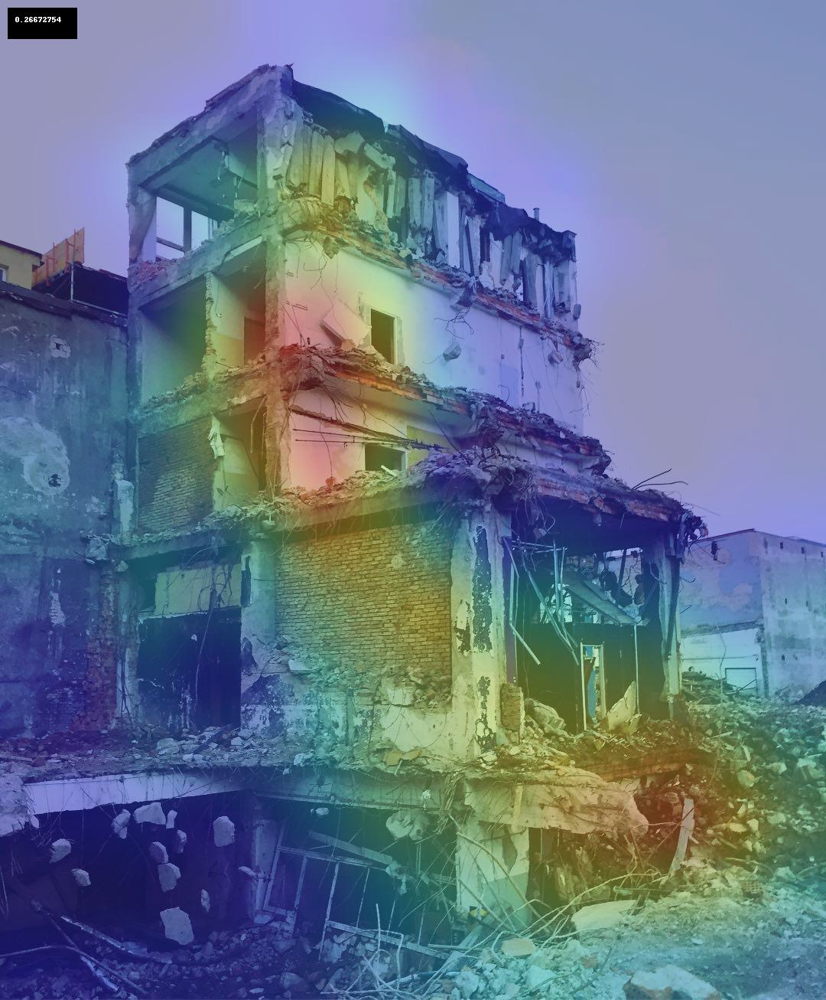

[[ 293.75858 -294.08868]]
predicted class:  DAMAGED
DSI Score:  0.2626261


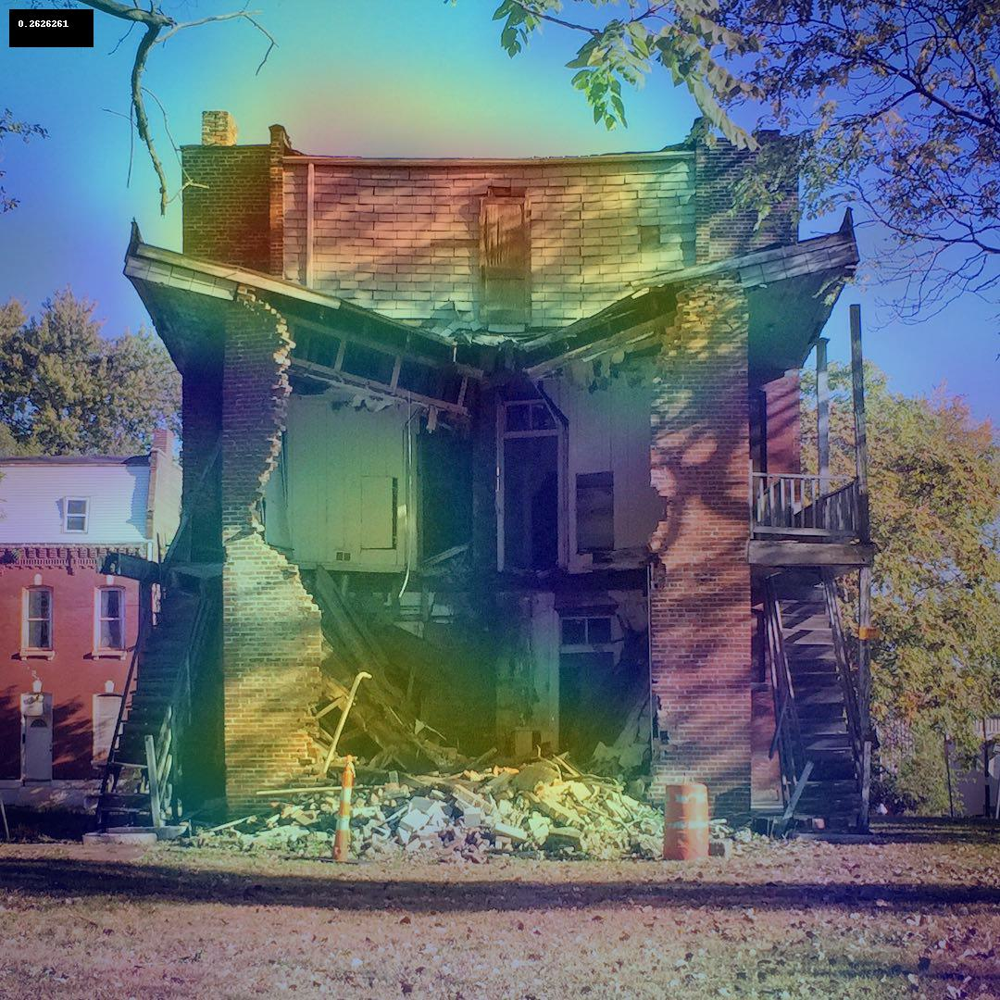

[[ 258.86475 -254.2599 ]]
predicted class:  DAMAGED
DSI Score:  0.34201944


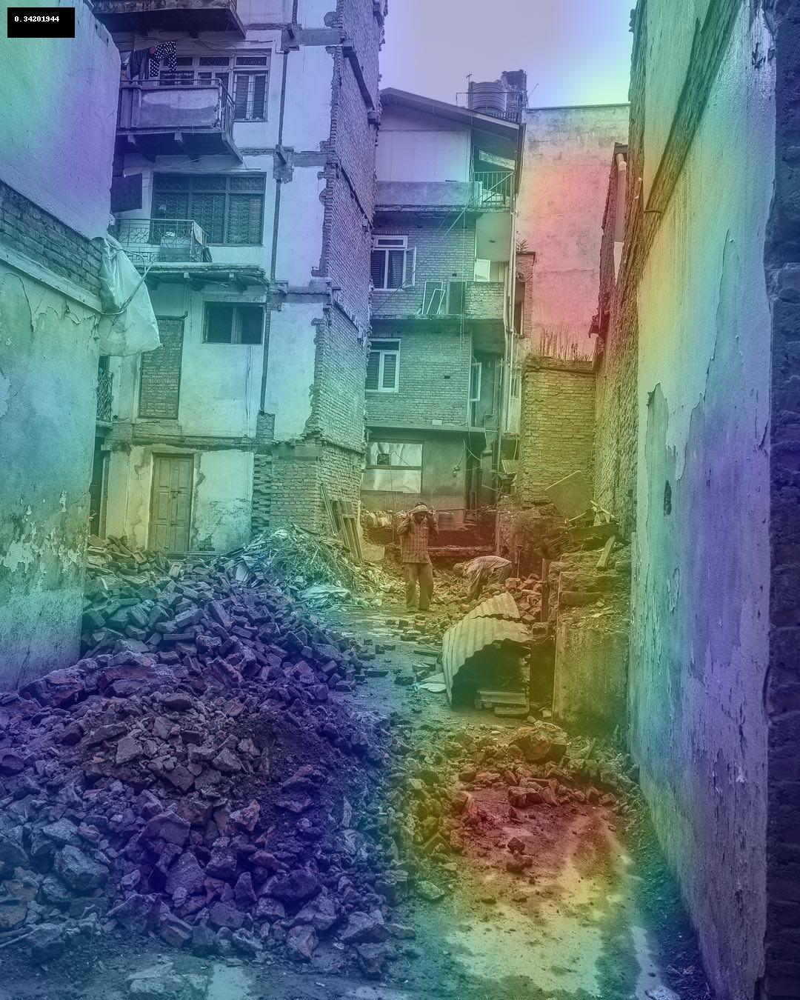

[[ 141.51865 -137.69449]]
predicted class:  DAMAGED
DSI Score:  0.15227462


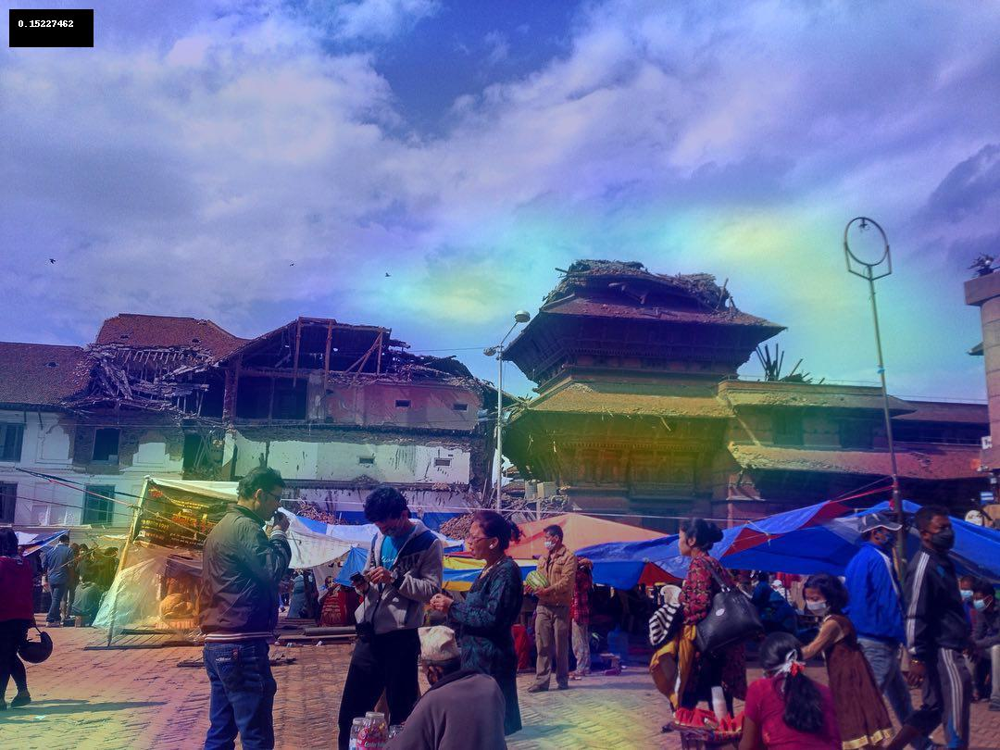

[[ 168.71996 -164.05301]]
predicted class:  DAMAGED
DSI Score:  0.12867904


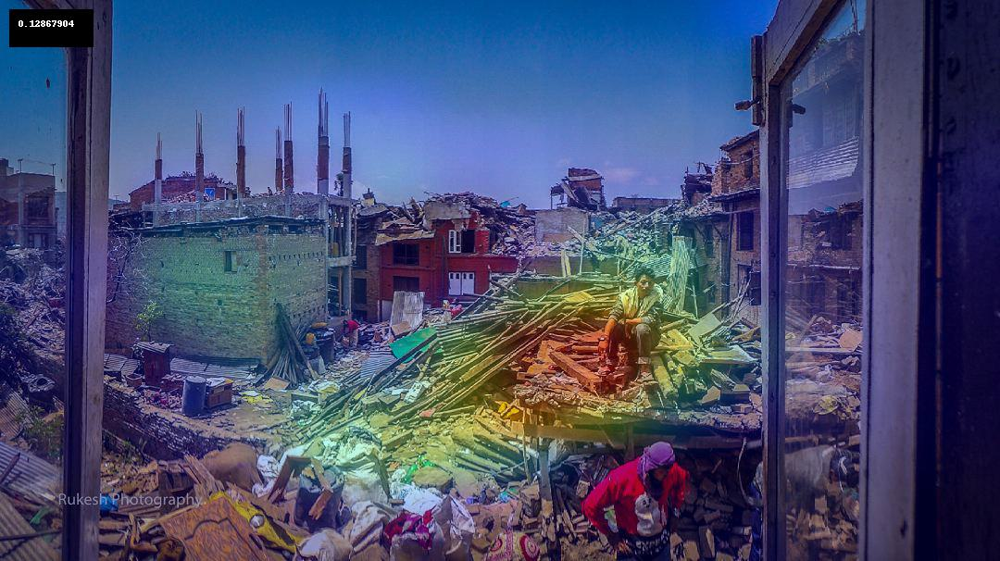

[[ 321.641  -316.0627]]
predicted class:  DAMAGED
DSI Score:  0.3177896


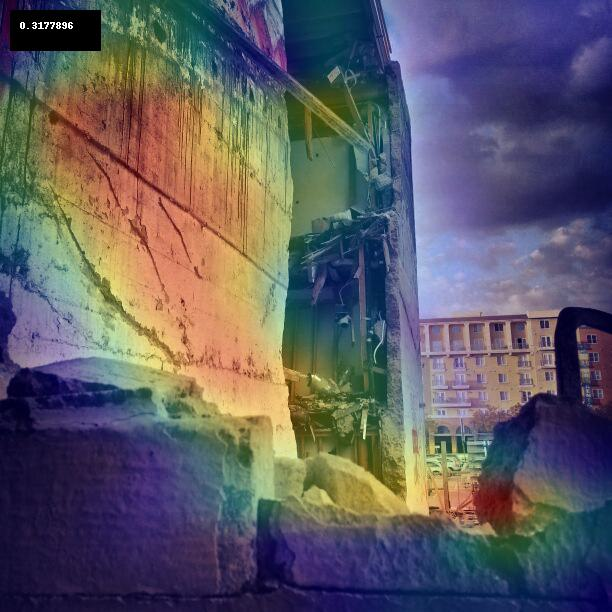

[[ 357.26334 -356.12958]]
predicted class:  DAMAGED
DSI Score:  0.27533123


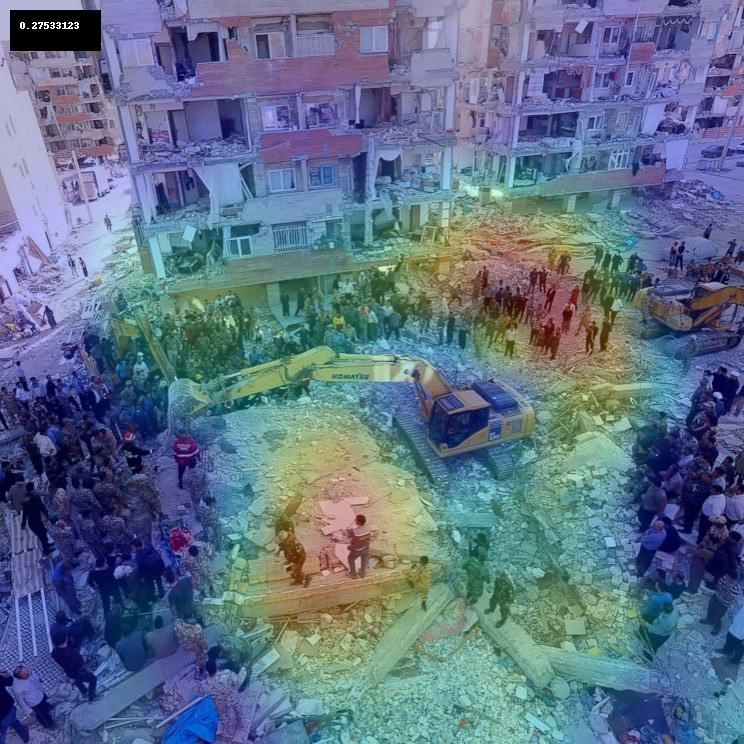

[[ 334.9331 -323.0916]]
predicted class:  DAMAGED
DSI Score:  0.28005102


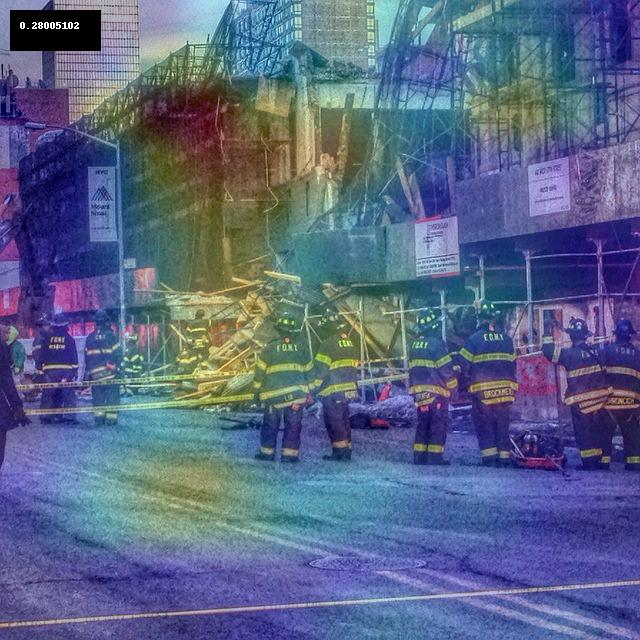

[[ 308.85953 -303.05722]]
predicted class:  DAMAGED
DSI Score:  0.31416667


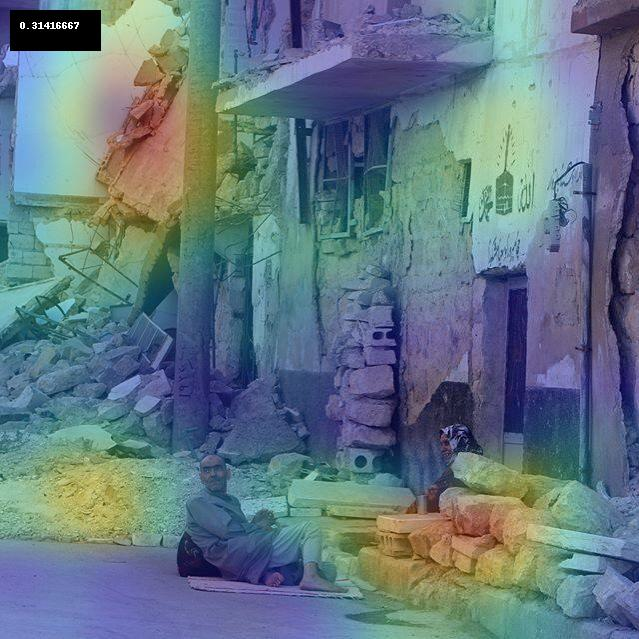

[[ 139.98811 -139.90059]]
predicted class:  DAMAGED
DSI Score:  0.13075414


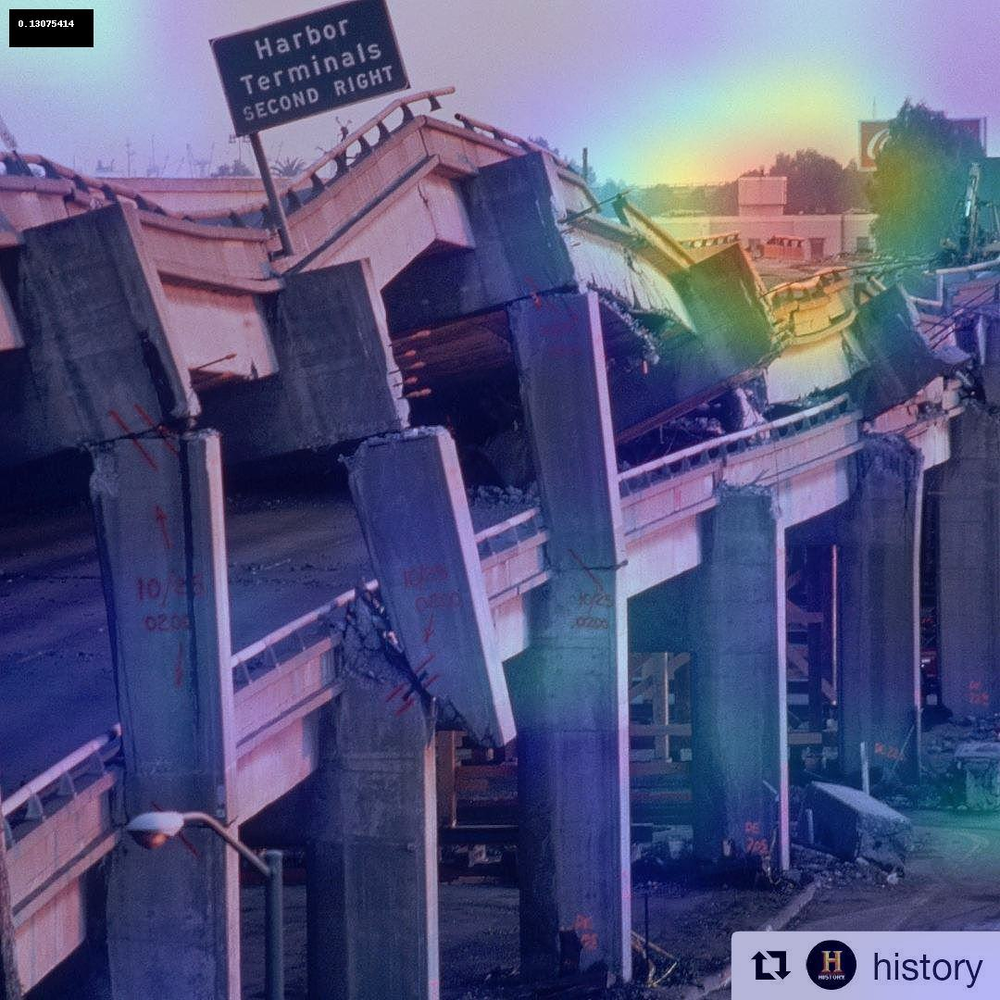

[[ 303.09686 -294.41168]]
predicted class:  DAMAGED
DSI Score:  0.24528892


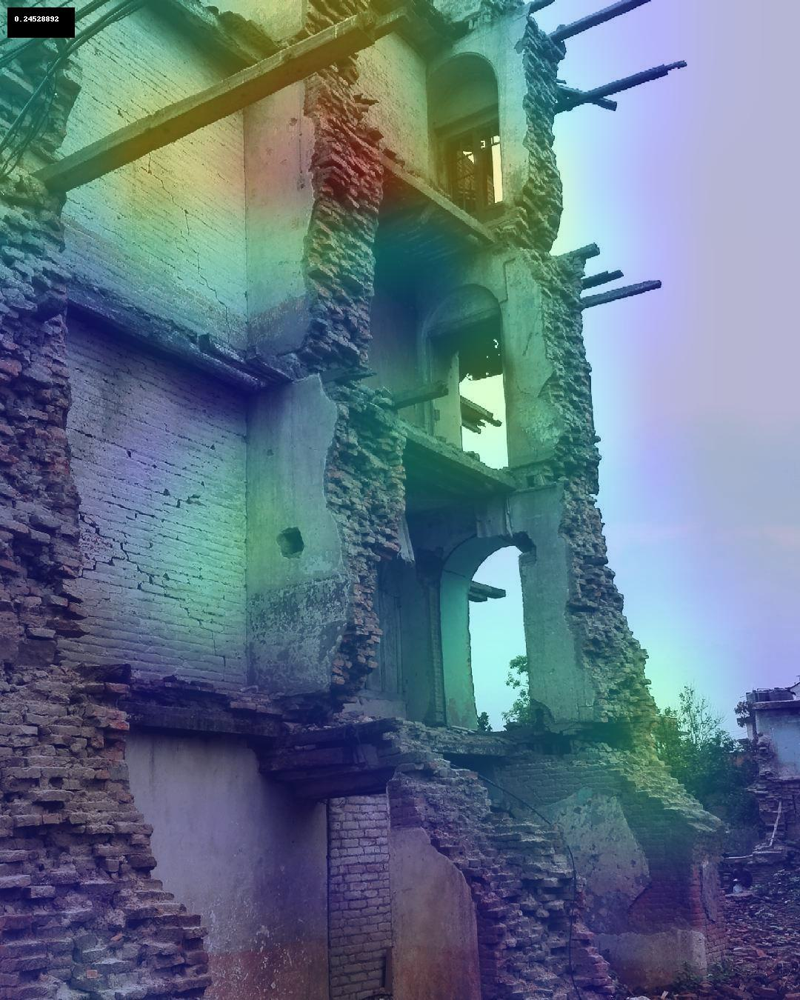

[[ 79.349075 -76.44586 ]]
predicted class:  DAMAGED
DSI Score:  0.1931989


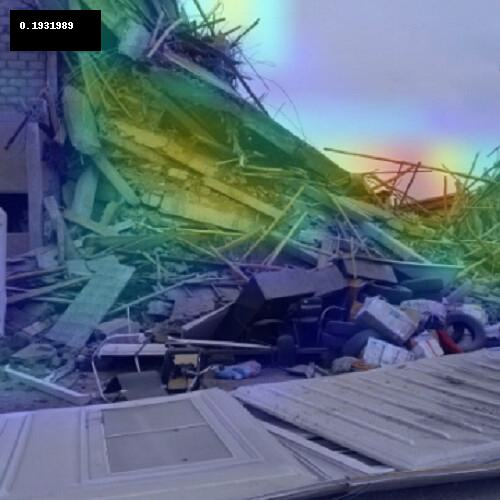

[[ 268.14838 -261.3586 ]]
predicted class:  DAMAGED
DSI Score:  0.2924727


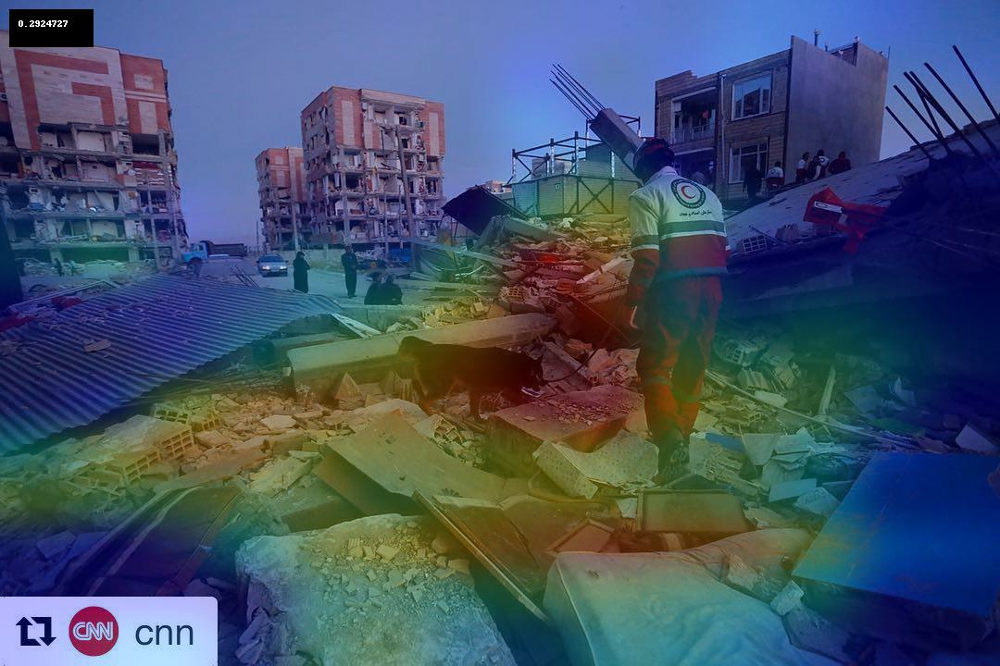

[[-22.495356  17.130205]]
predicted class:  NOT DAMAGED
DSI Score:  0.13712169


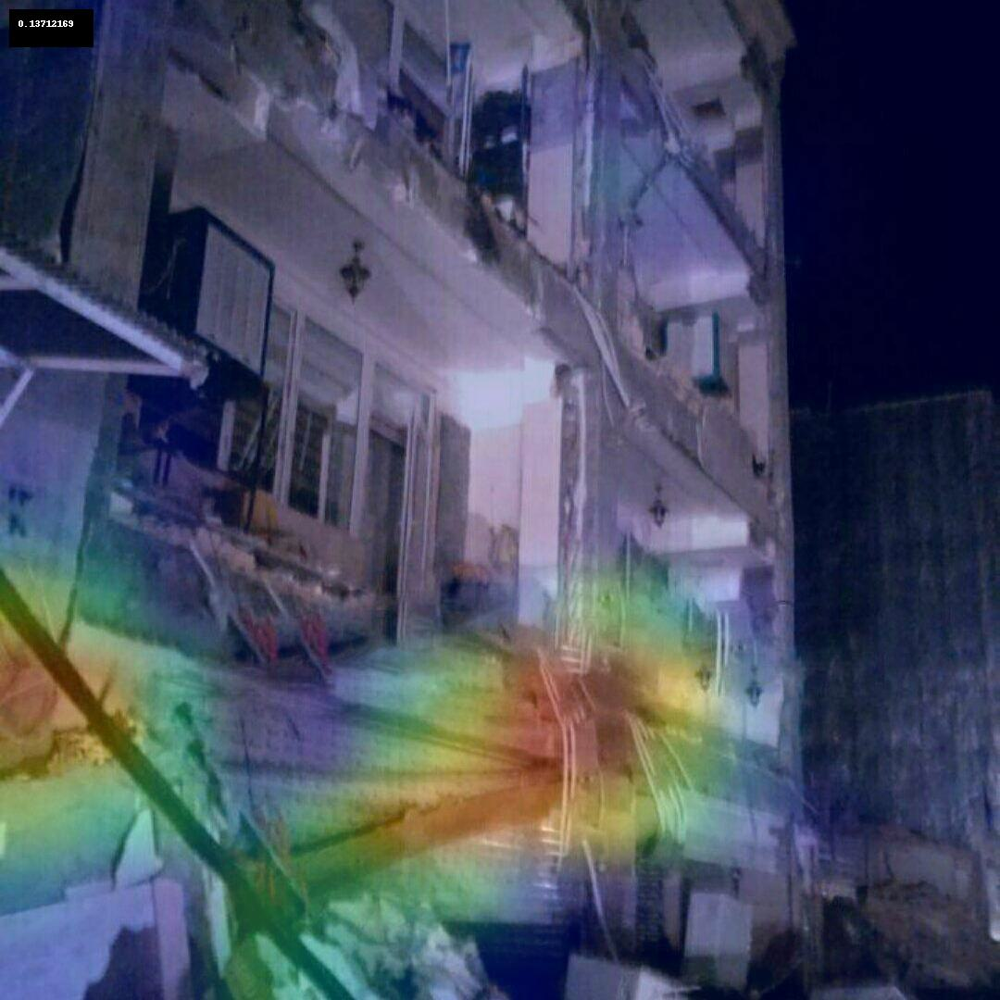

[[ 277.8997  -266.24045]]
predicted class:  DAMAGED
DSI Score:  0.27161527


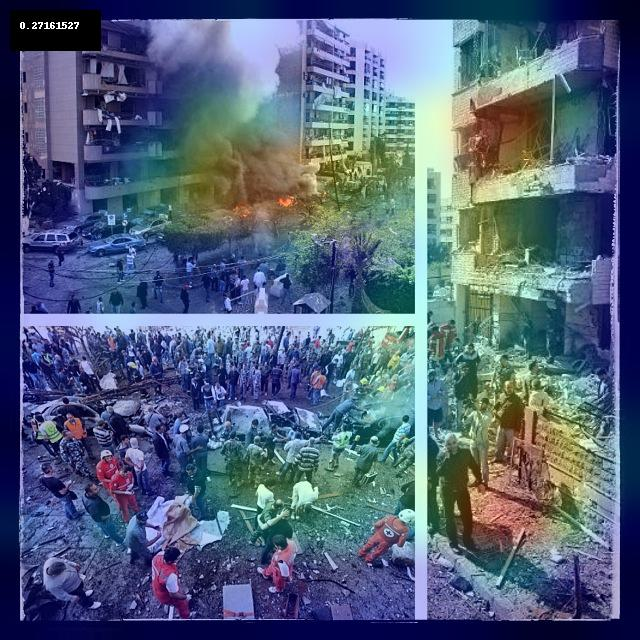

[[ 264.60516 -260.09537]]
predicted class:  DAMAGED
DSI Score:  0.32047653


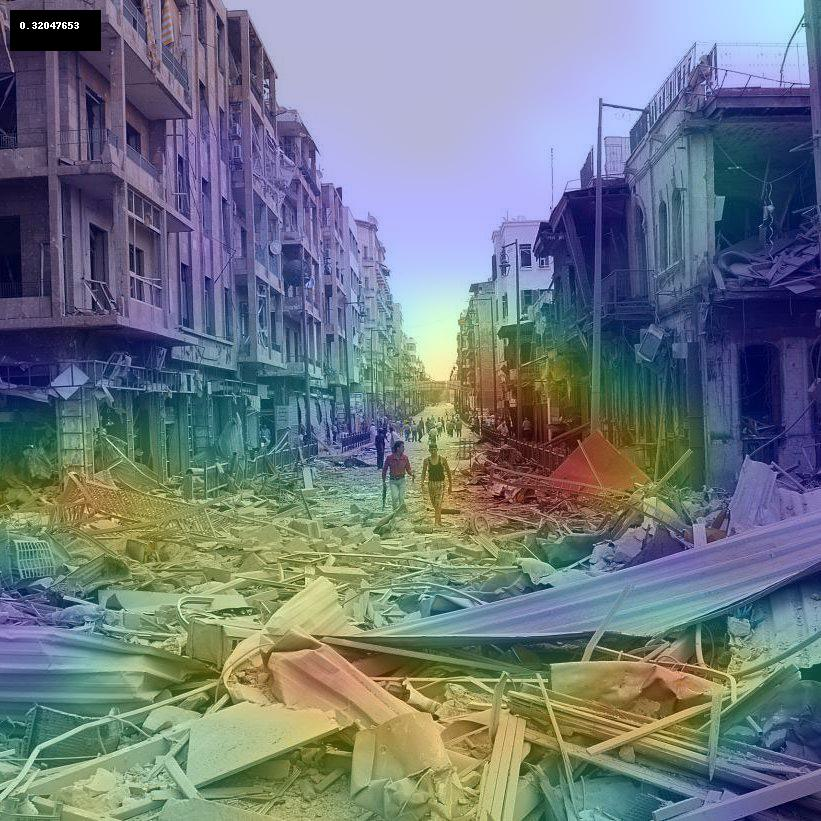

[[ 312.12637 -300.60983]]
predicted class:  DAMAGED
DSI Score:  0.24525522


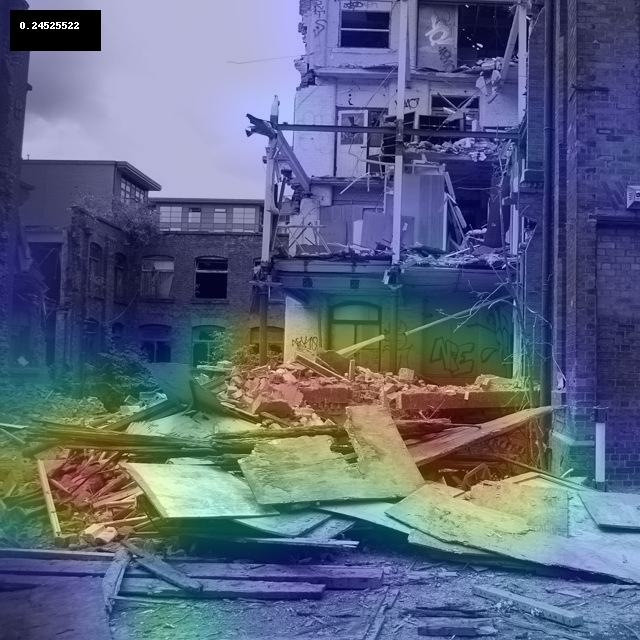

[[ 332.65457 -319.083  ]]
predicted class:  DAMAGED
DSI Score:  0.25463954


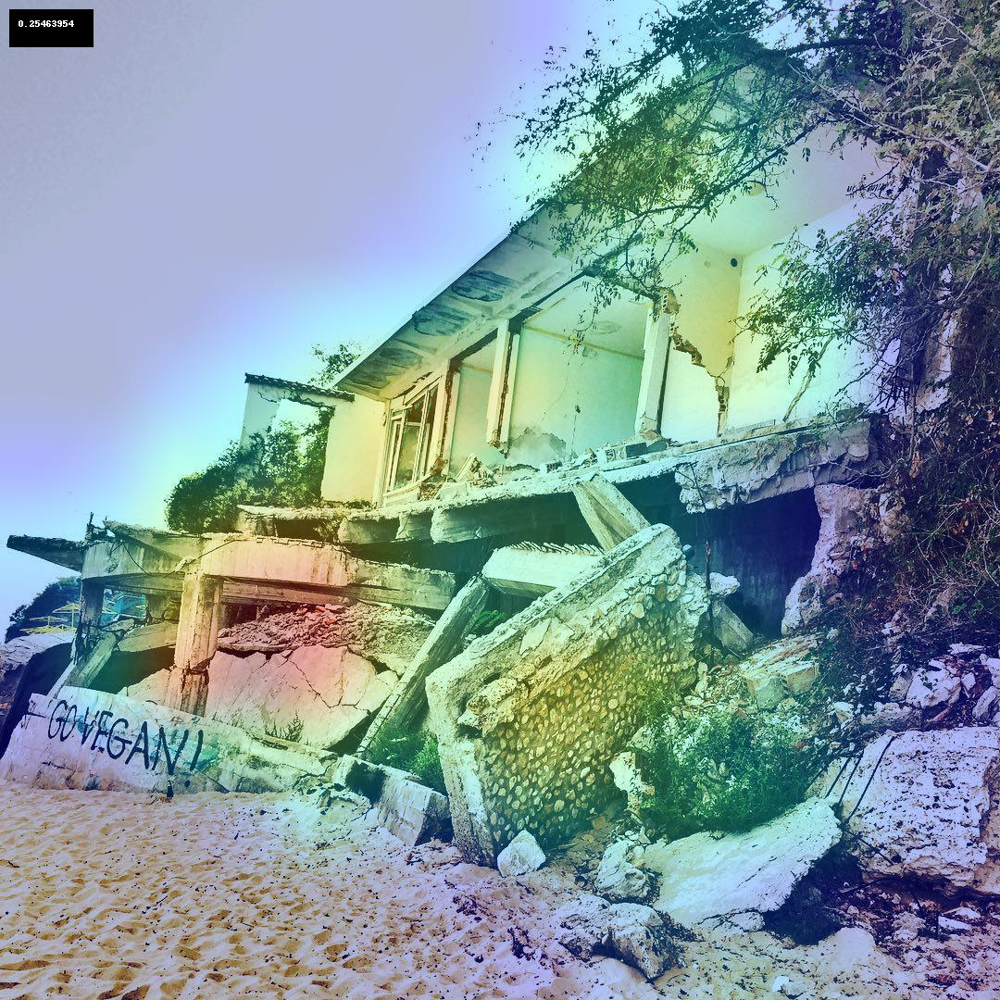

[[ 51.472122 -53.79746 ]]
predicted class:  DAMAGED
DSI Score:  0.24791184


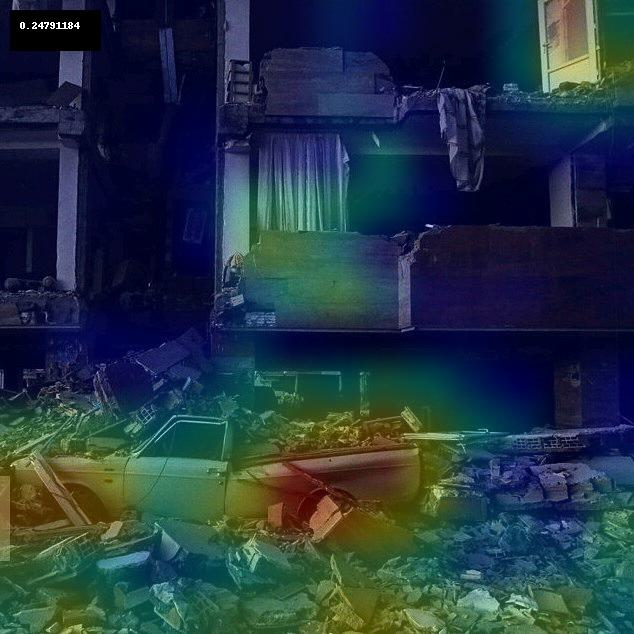

[[ 133.82452 -129.45723]]
predicted class:  DAMAGED
DSI Score:  0.15208887


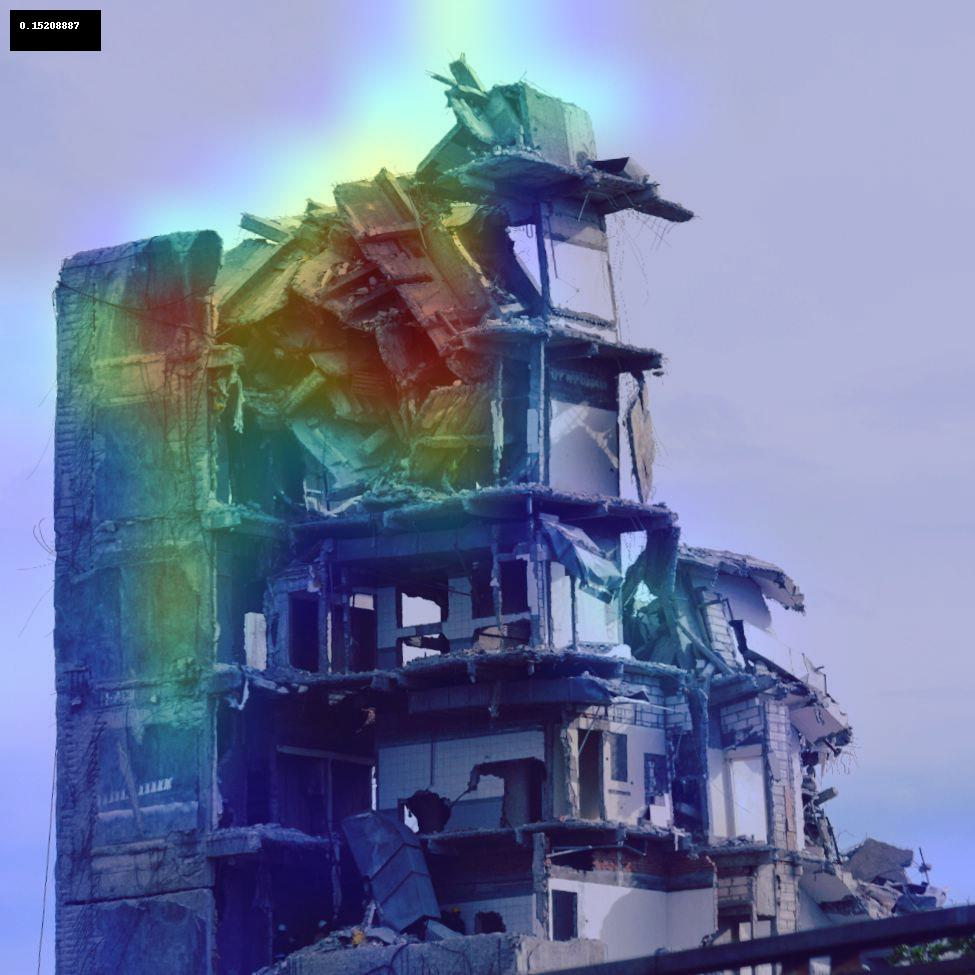

[[ 306.30423 -303.1168 ]]
predicted class:  DAMAGED
DSI Score:  0.2632601


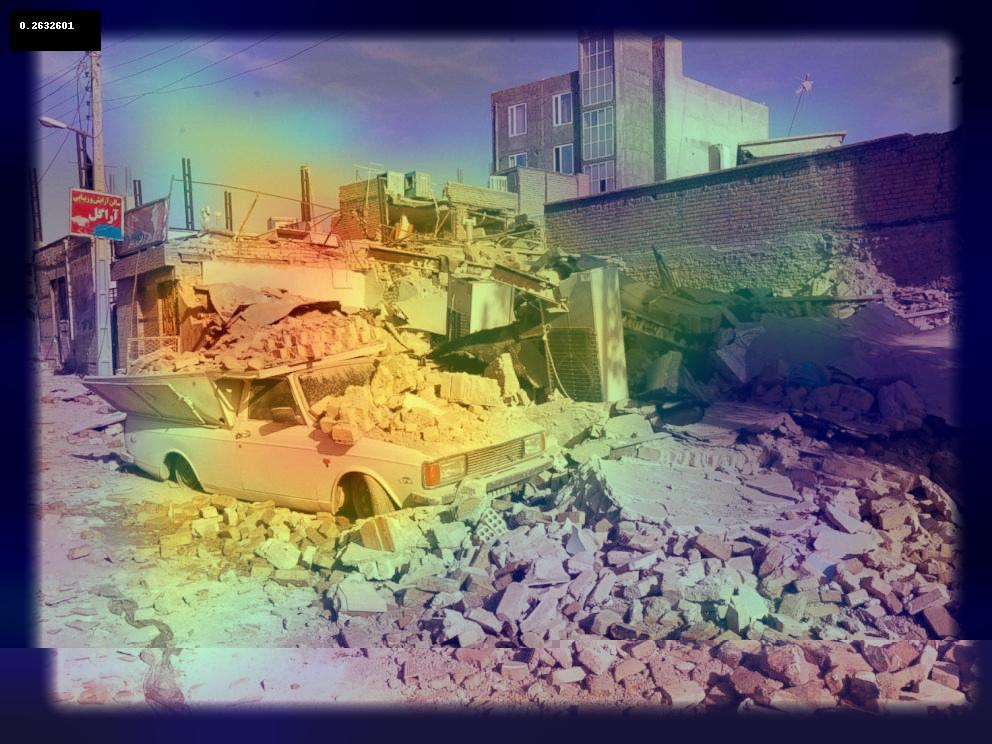

[[ 445.3571  -429.51712]]
predicted class:  DAMAGED
DSI Score:  0.34446752


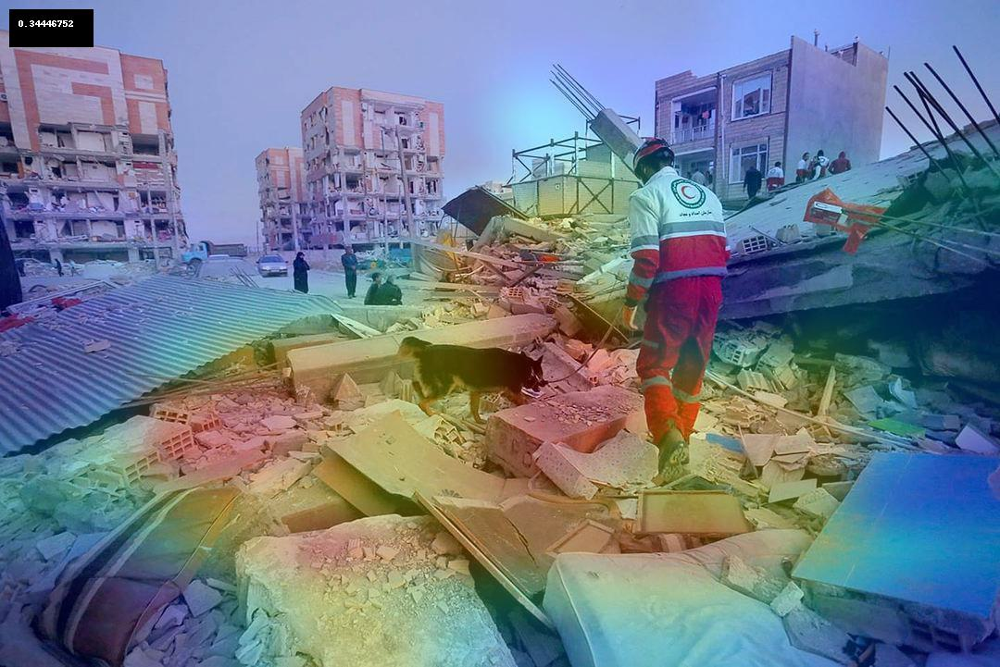

[[ 136.55617 -124.13756]]
predicted class:  DAMAGED
DSI Score:  0.25070366


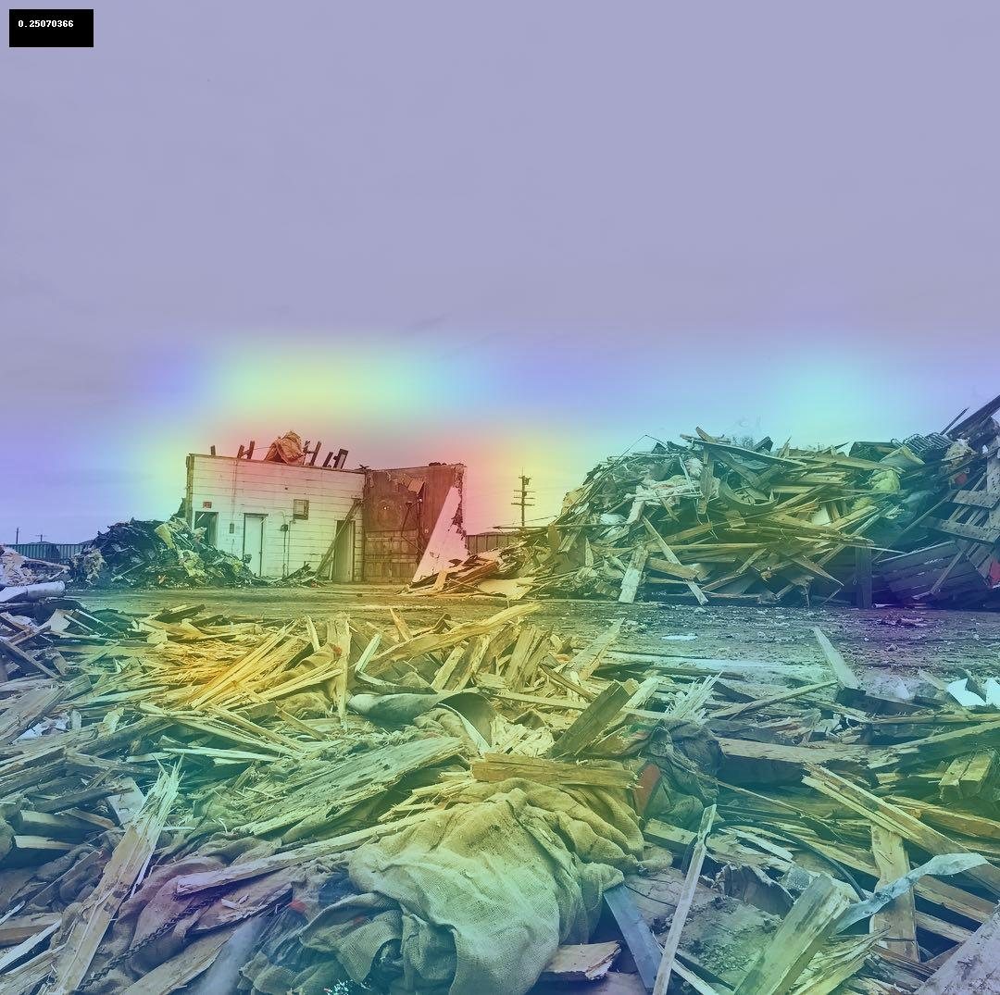

[[ 205.22362 -202.38193]]
predicted class:  DAMAGED
DSI Score:  0.15346338


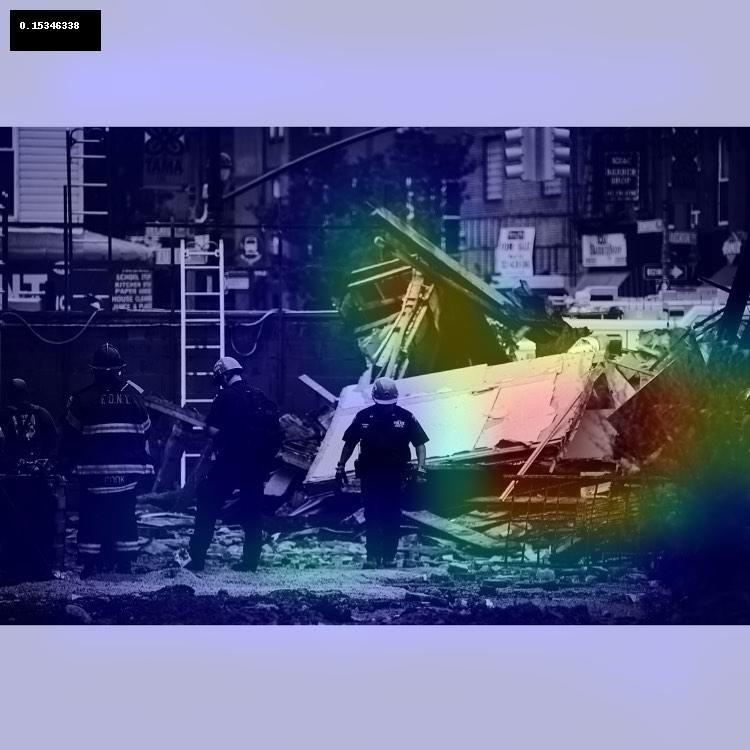

[[ 211.51448 -208.13715]]
predicted class:  DAMAGED
DSI Score:  0.30527475


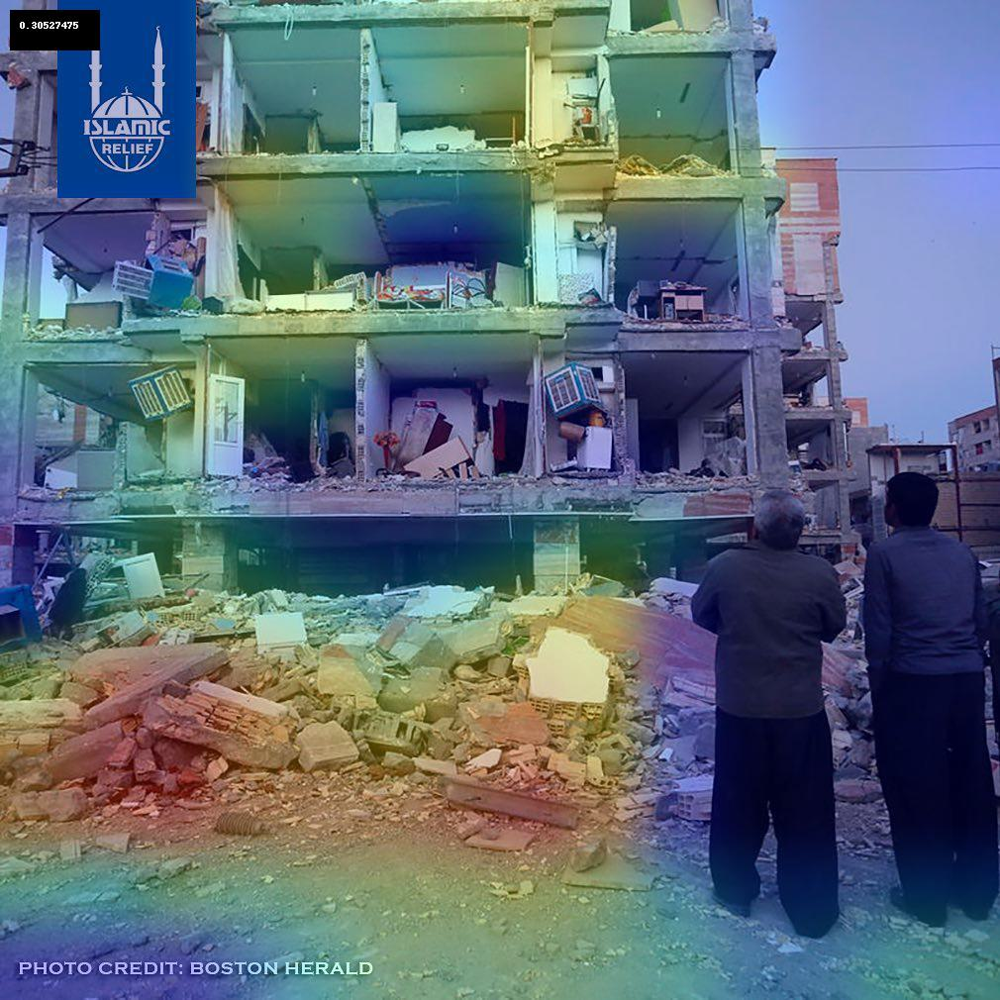

[[ 200.1598  -183.18199]]
predicted class:  DAMAGED
DSI Score:  0.19522068


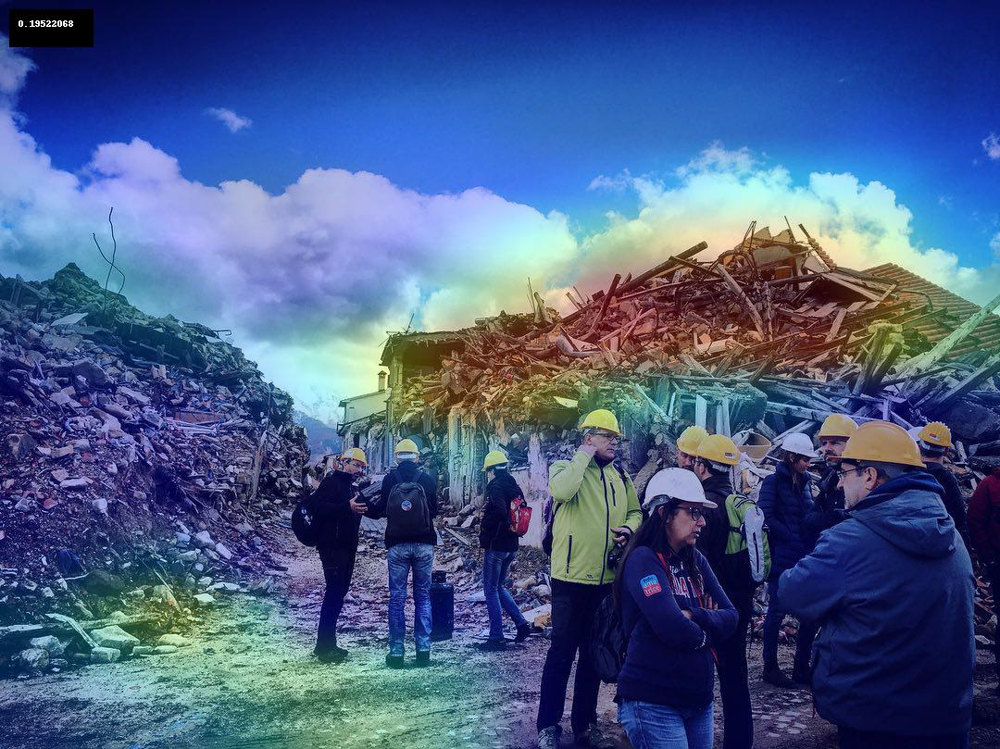

[[-7.2005367  2.6503205]]
predicted class:  NOT DAMAGED
DSI Score:  0.11826985


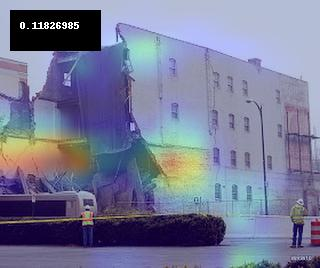

[[ 158.74158 -151.98344]]
predicted class:  DAMAGED
DSI Score:  0.23953208


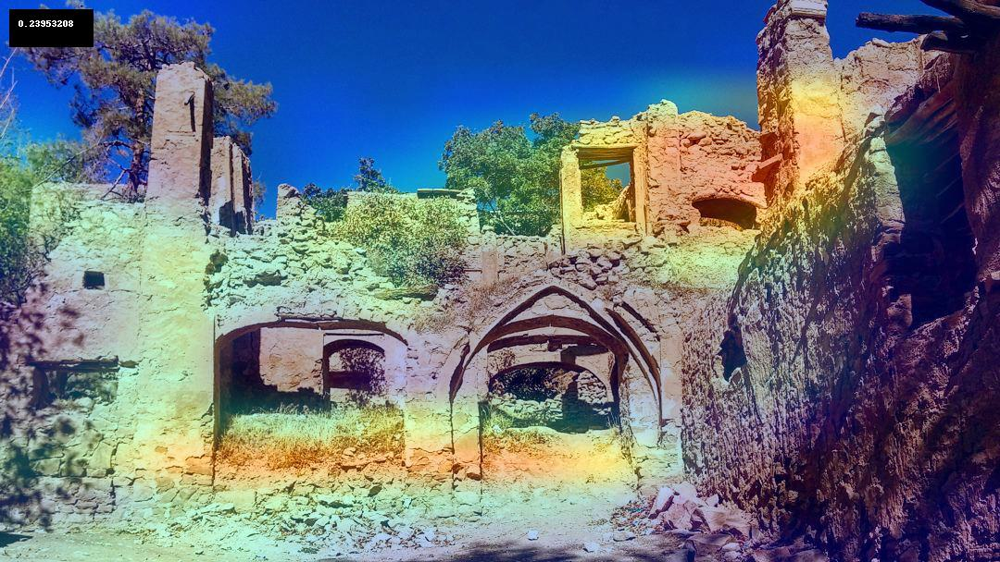

[[ 146.76495 -145.398  ]]
predicted class:  DAMAGED
DSI Score:  0.15073094


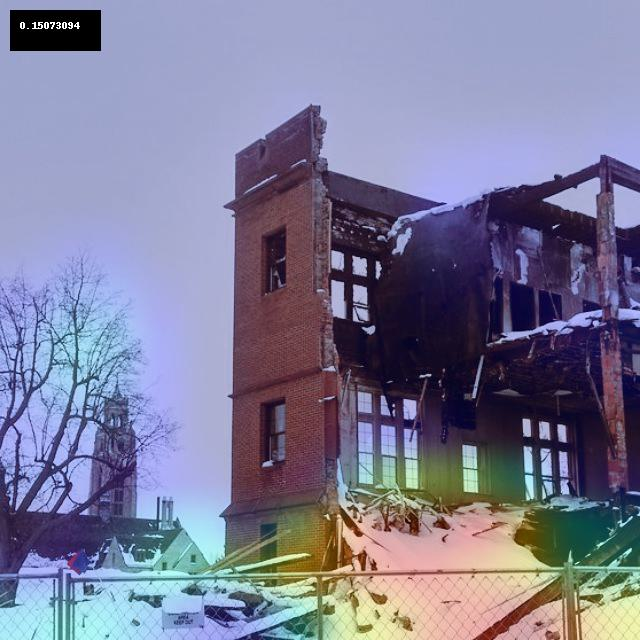

[[-60.010677  52.206818]]
predicted class:  NOT DAMAGED
DSI Score:  0.04189504


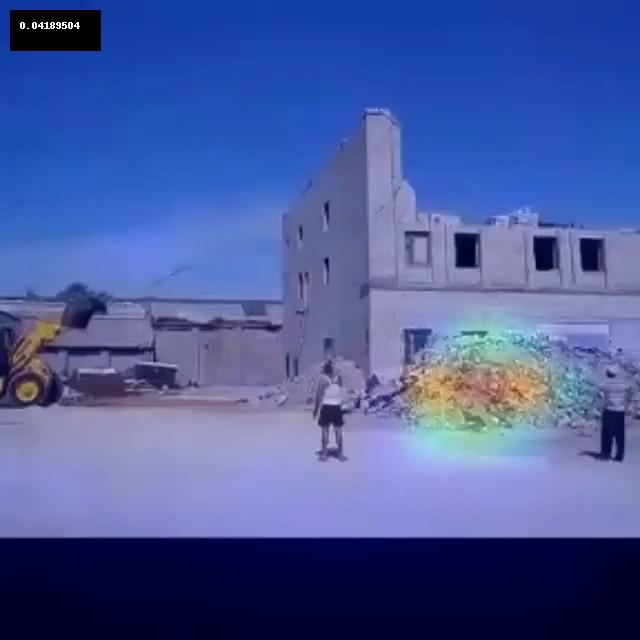

[[ 113.760376 -110.827286]]
predicted class:  DAMAGED
DSI Score:  0.1826696


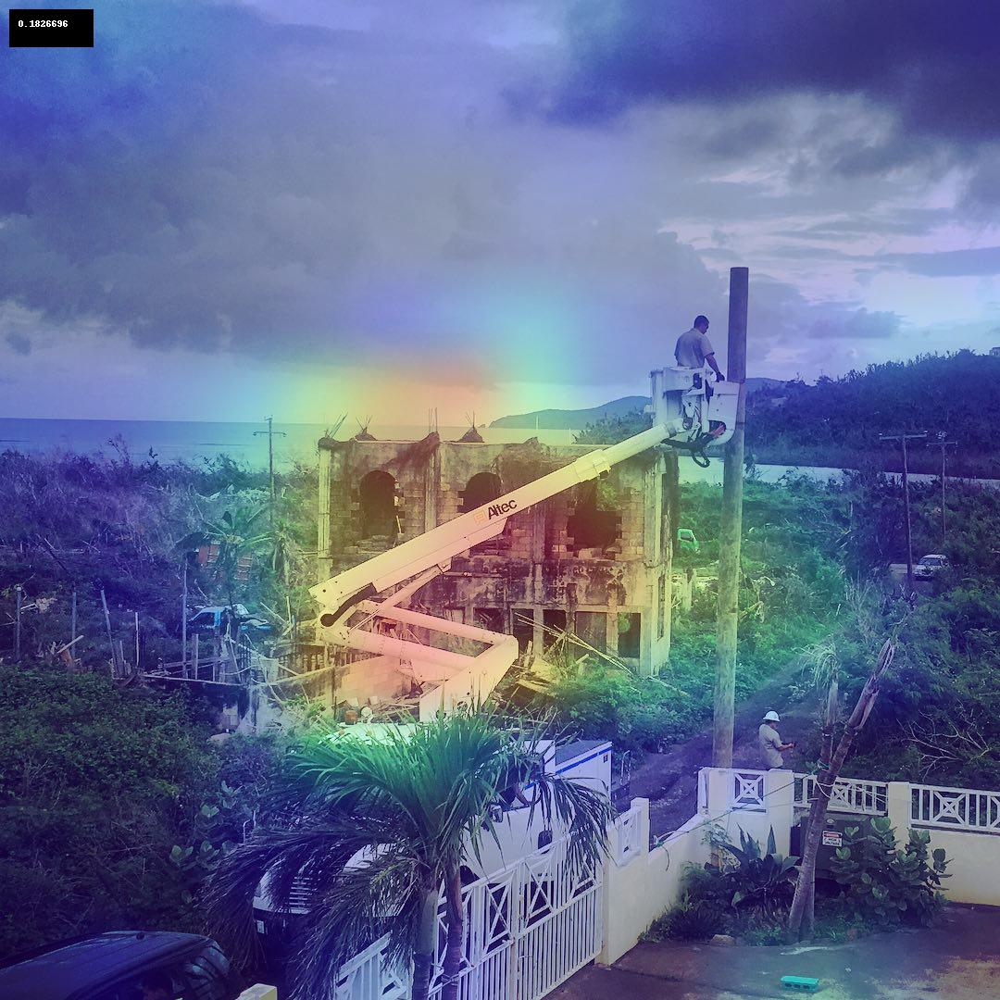

[[-102.844505   91.17346 ]]
predicted class:  NOT DAMAGED
DSI Score:  0.05471546


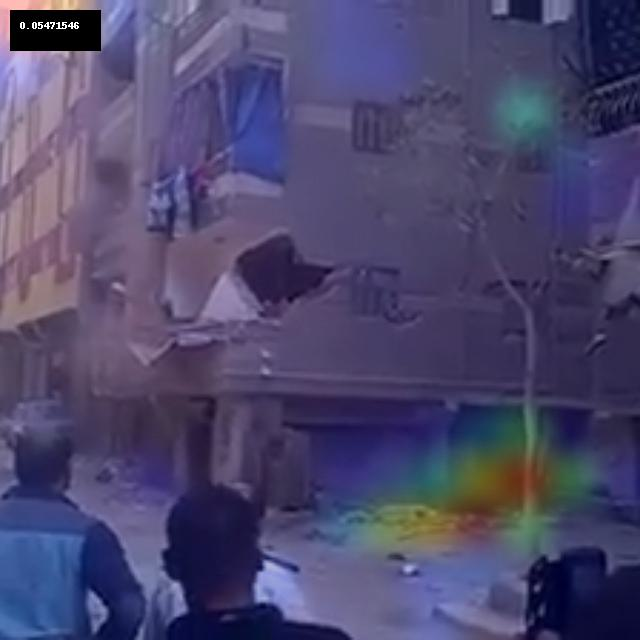

[[ 48.43189  -50.214233]]
predicted class:  DAMAGED
DSI Score:  0.1362729


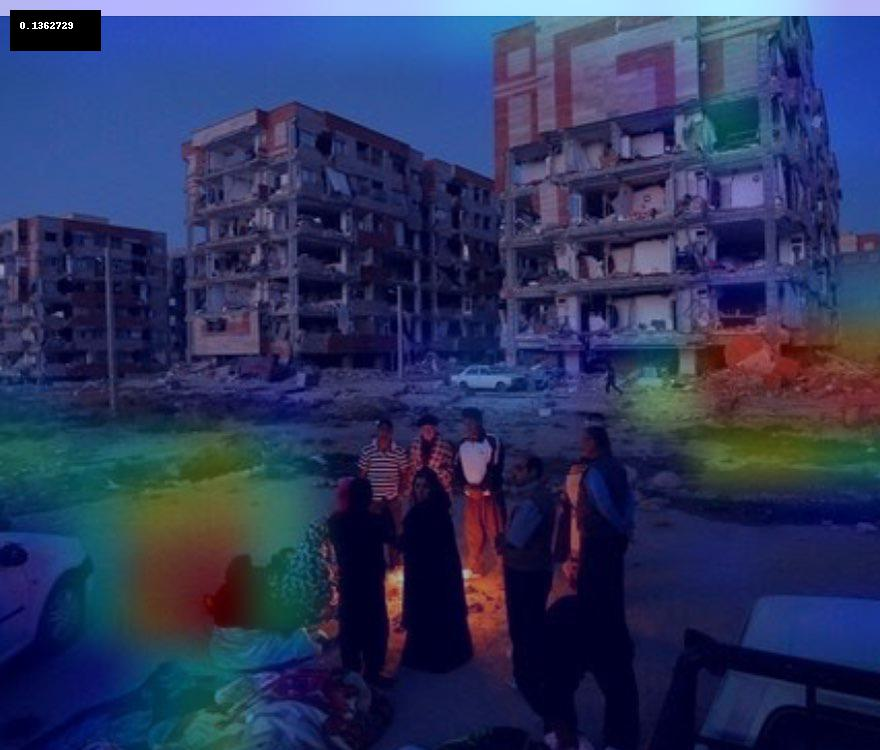

[[ 193.9435  -196.14275]]
predicted class:  DAMAGED
DSI Score:  0.24665797


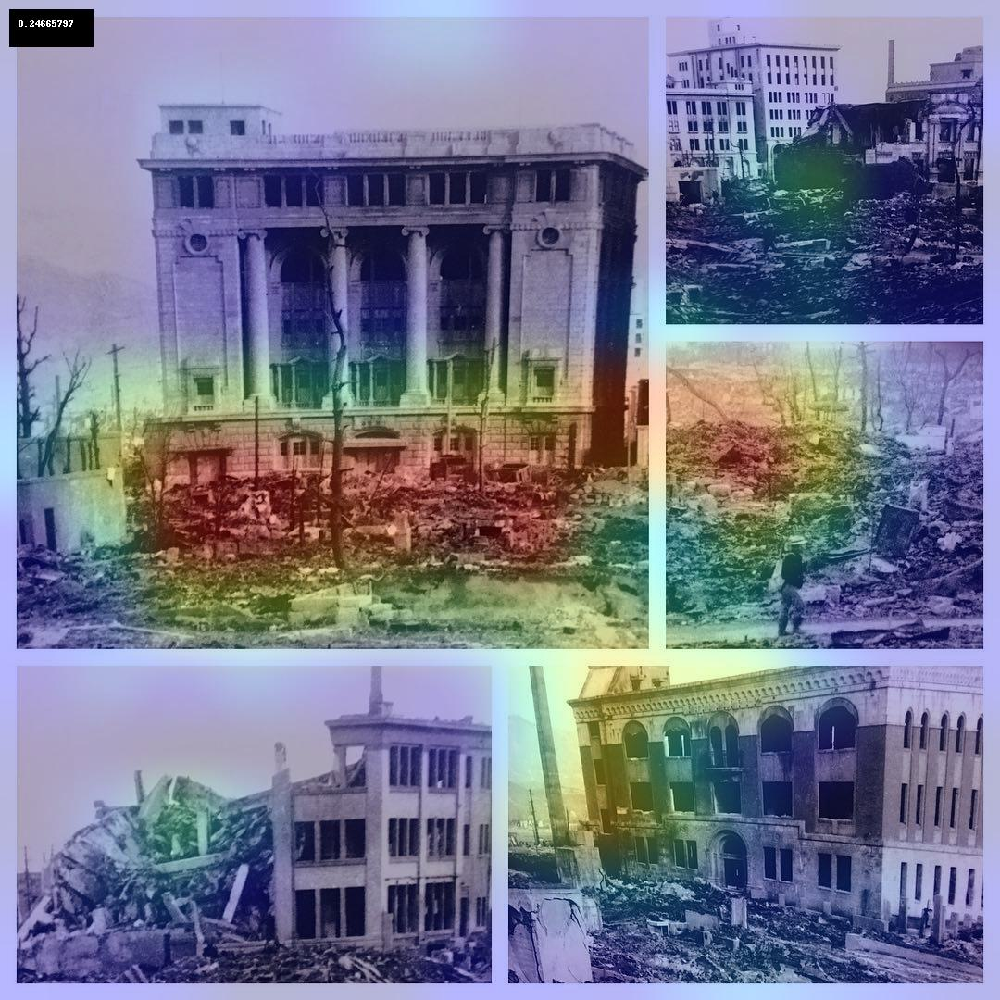

[[ 217.85591 -214.38309]]
predicted class:  DAMAGED
DSI Score:  0.2682419


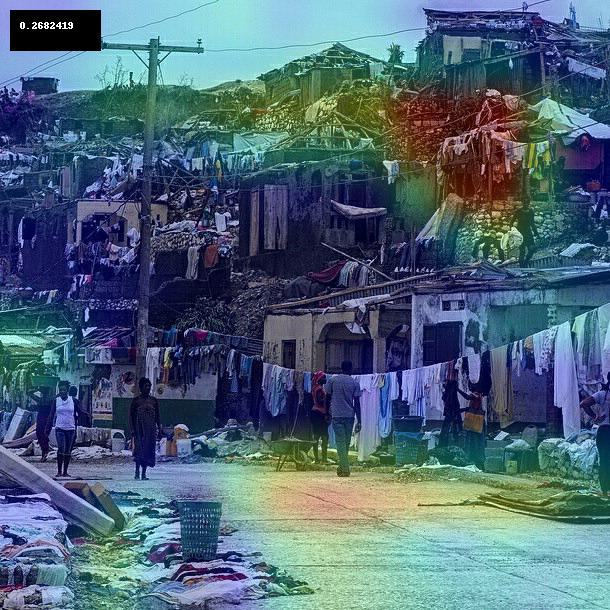

[[ 327.52103 -314.03122]]
predicted class:  DAMAGED
DSI Score:  0.284006


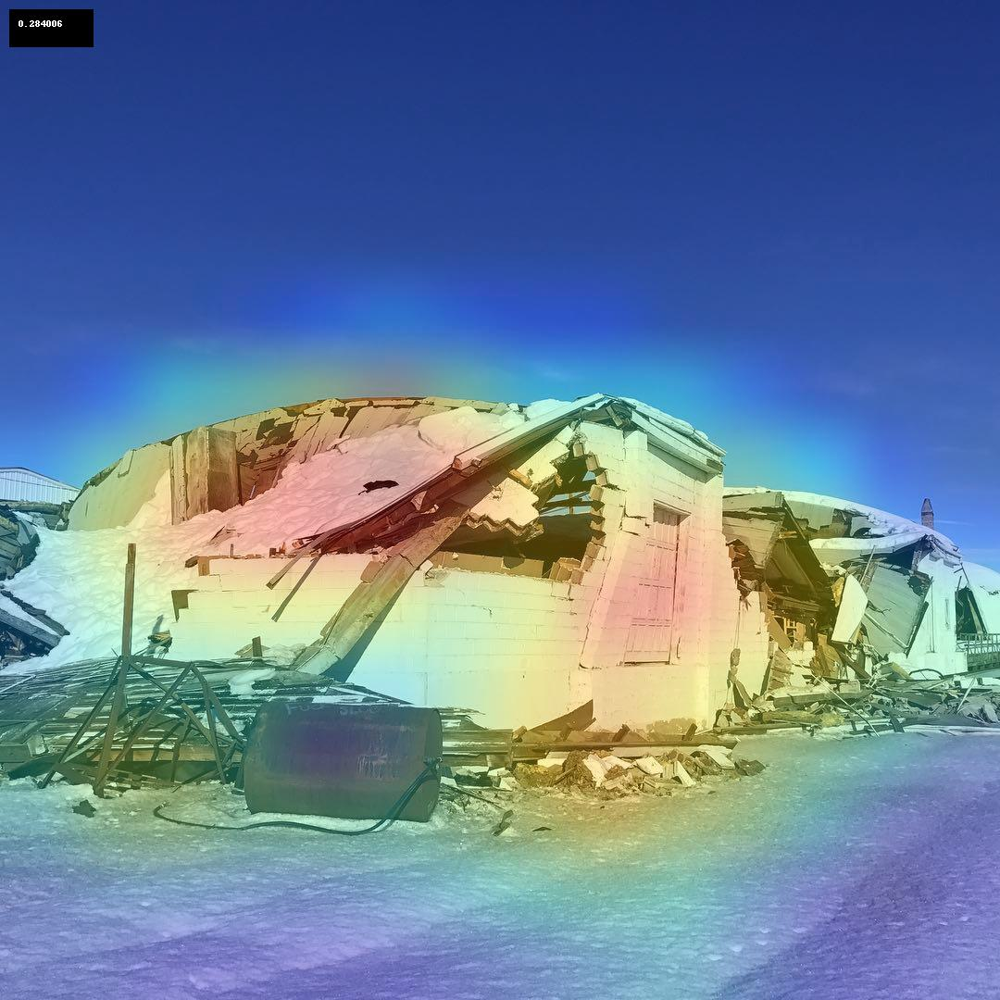

[[ 374.82278 -370.69775]]
predicted class:  DAMAGED
DSI Score:  0.35519883


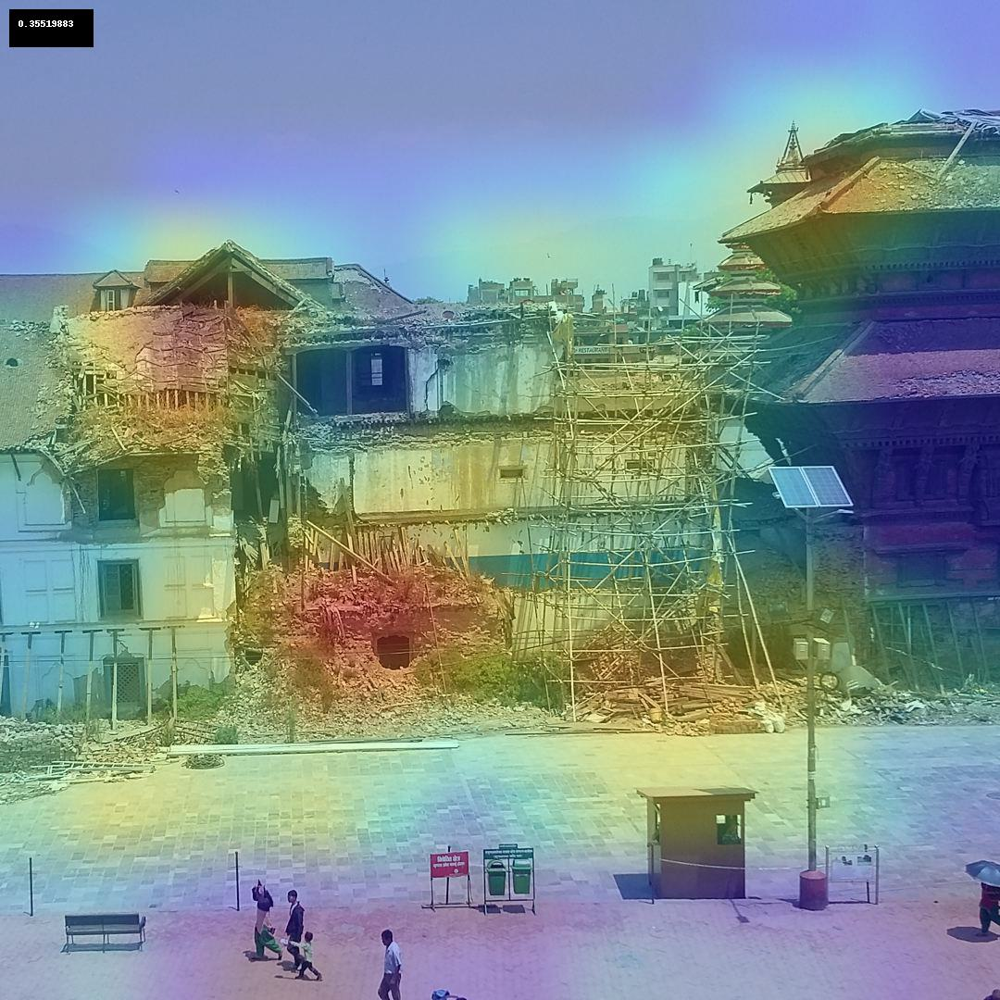

[[ 332.7783  -316.04782]]
predicted class:  DAMAGED
DSI Score:  0.366645


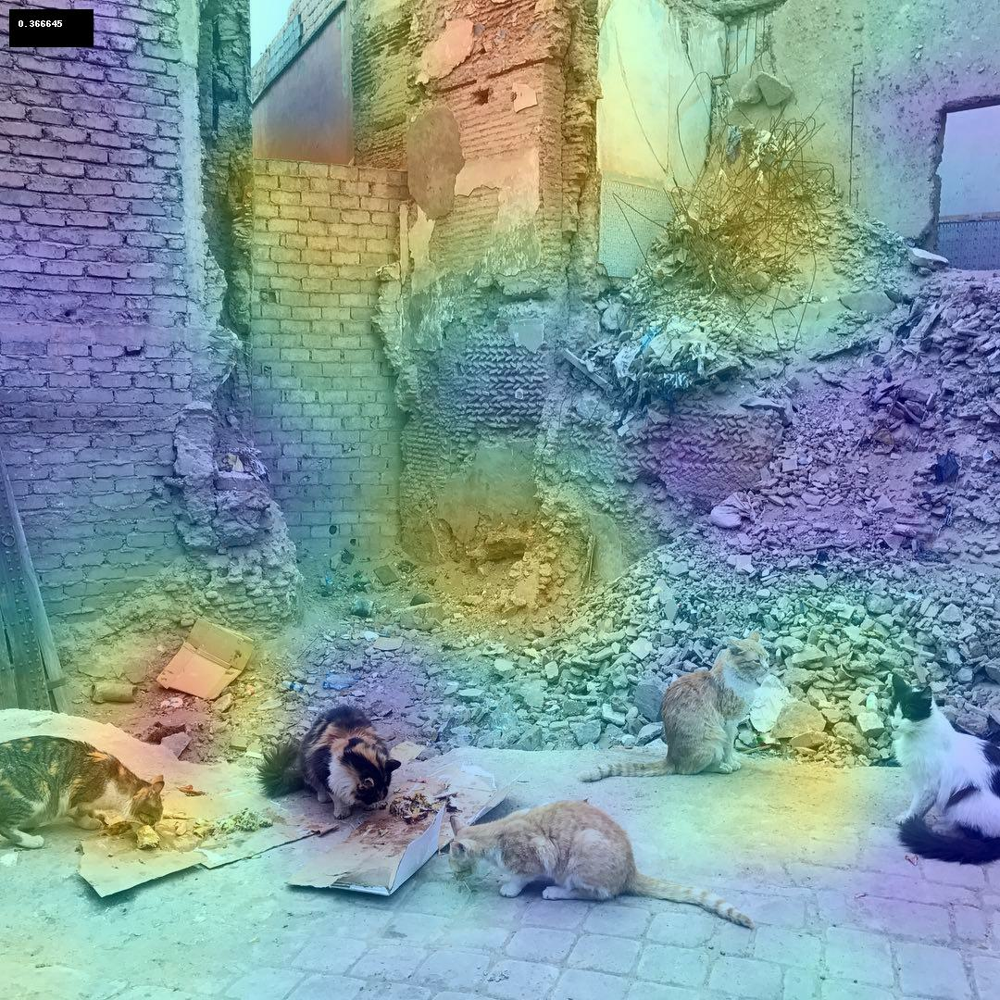

[[ 95.843285 -95.32126 ]]
predicted class:  DAMAGED
DSI Score:  0.16618955


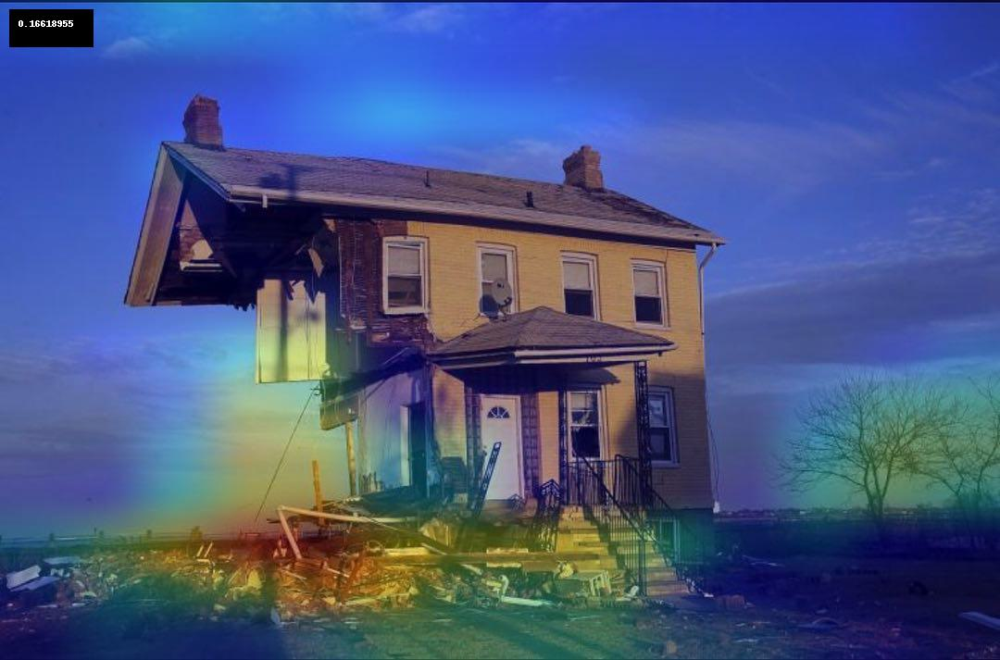

[[-19.4363    19.838112]]
predicted class:  NOT DAMAGED
DSI Score:  0.15812112


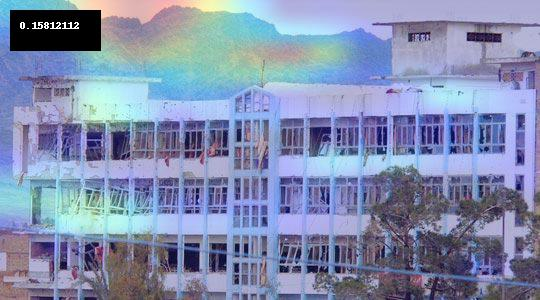

[[ 196.43884 -192.08696]]
predicted class:  DAMAGED
DSI Score:  0.25641286


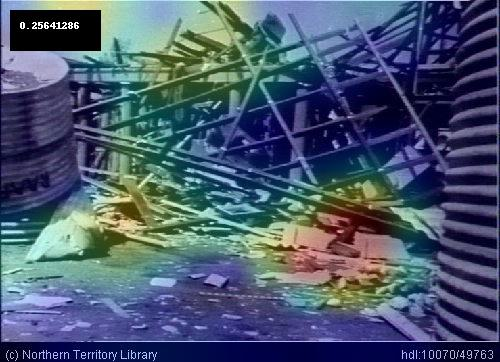

[[ 80.44527 -80.82557]]
predicted class:  DAMAGED
DSI Score:  0.23191841


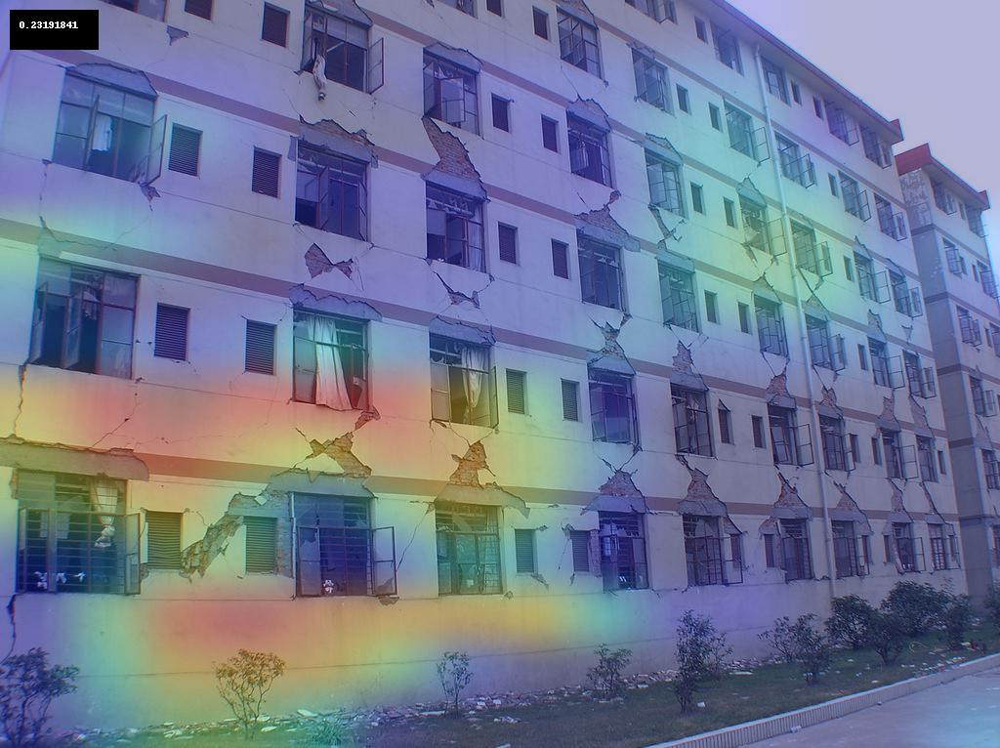

[[-127.92821  115.48662]]
predicted class:  NOT DAMAGED
DSI Score:  0.09487554


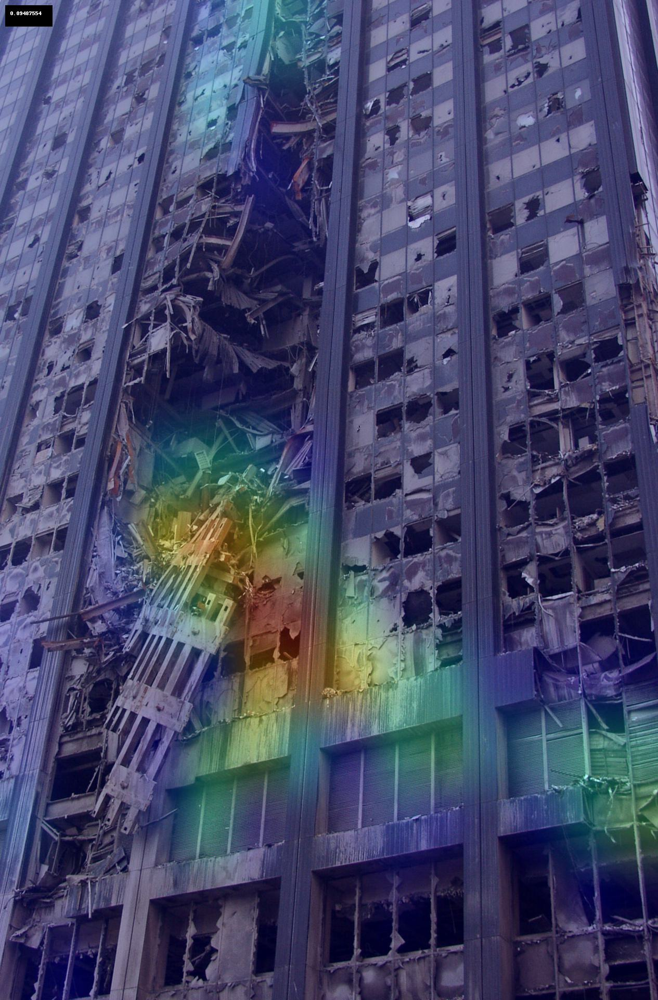

[[ 107.25844 -114.28784]]
predicted class:  DAMAGED
DSI Score:  0.13144775


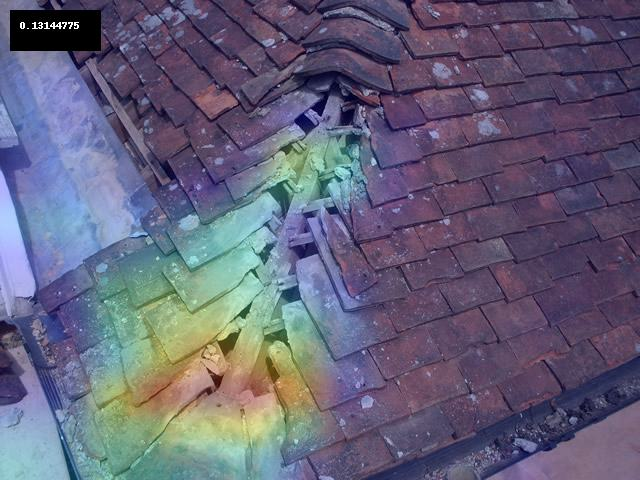

[[ 48.574646 -49.311764]]
predicted class:  DAMAGED
DSI Score:  0.1164804


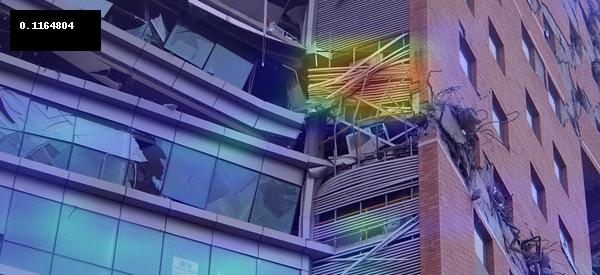

[[ 257.98788 -254.44052]]
predicted class:  DAMAGED
DSI Score:  0.37976447


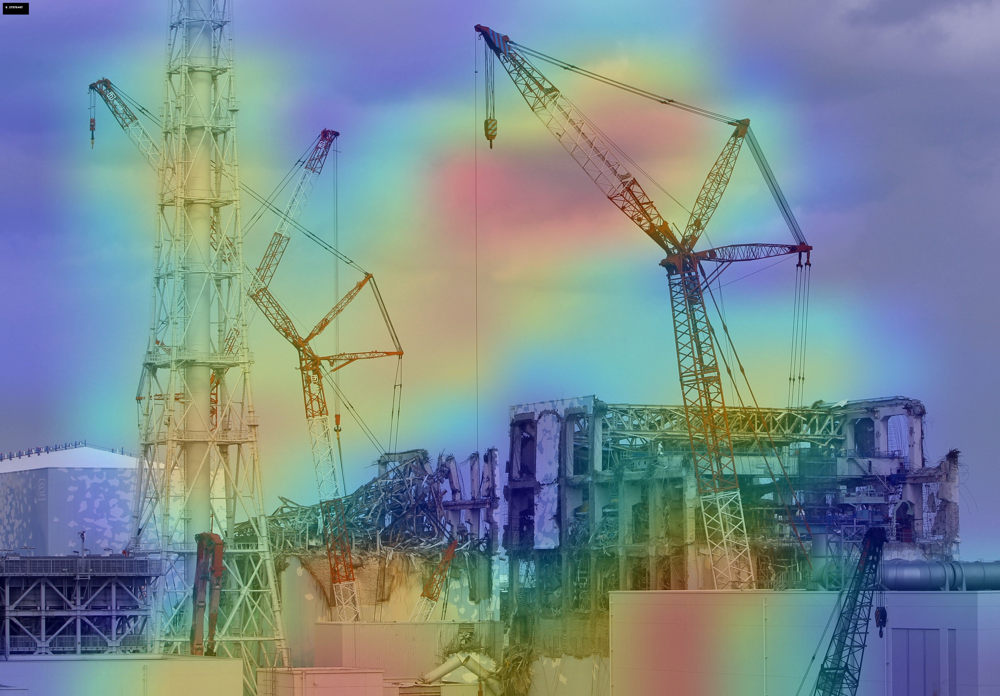

[[ 176.37163 -175.05165]]
predicted class:  DAMAGED
DSI Score:  0.18561216


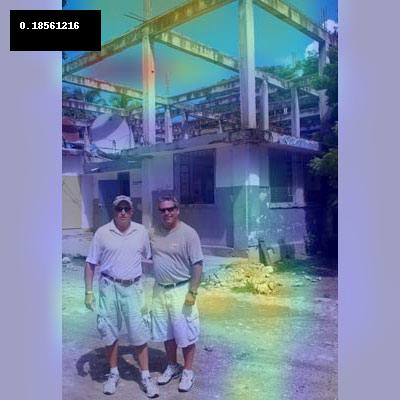

[[-69.34805   67.342224]]
predicted class:  NOT DAMAGED
DSI Score:  0.12641793


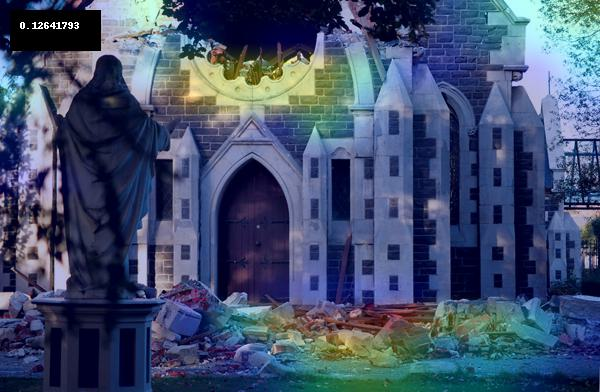

[[ 71.23851 -74.21478]]
predicted class:  DAMAGED
DSI Score:  0.18926819


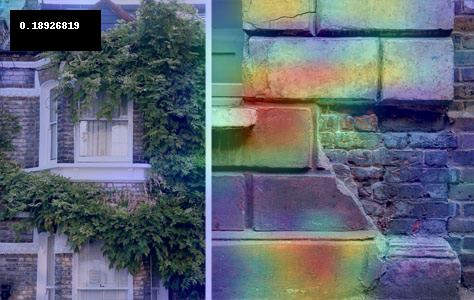

[[ 65.205345 -67.75192 ]]
predicted class:  DAMAGED
DSI Score:  0.06946318


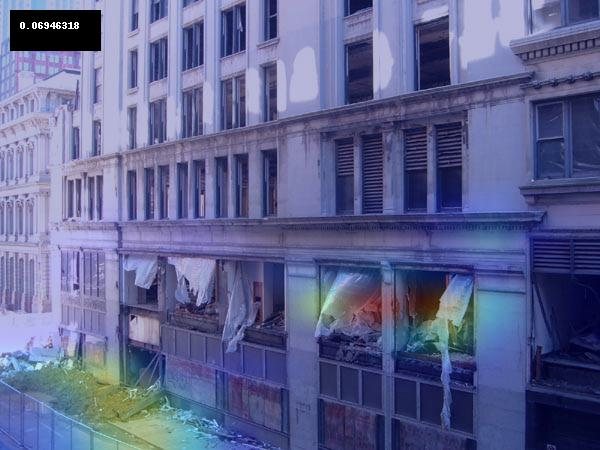

[[ 427.94696 -420.01865]]
predicted class:  DAMAGED
DSI Score:  0.3588281


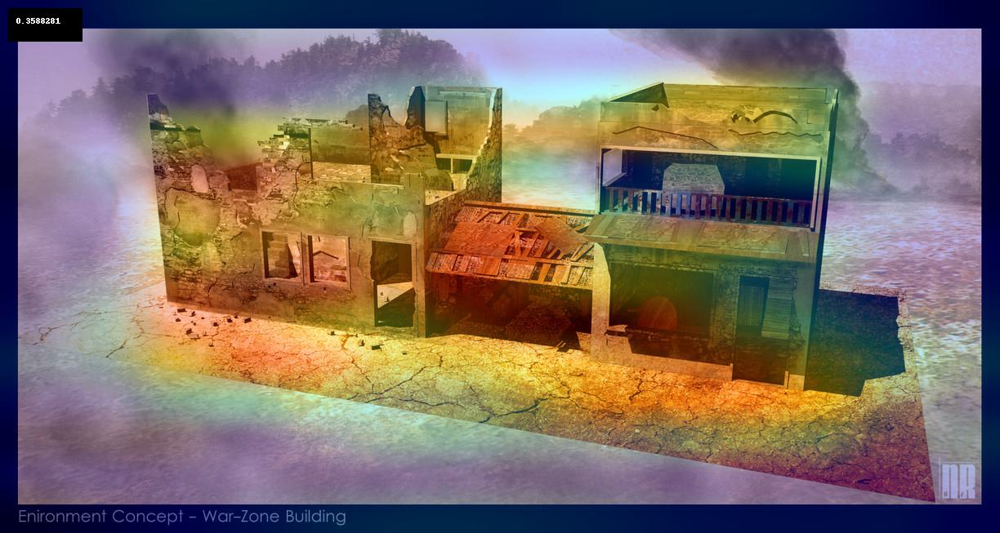

[[ 337.33536 -324.23642]]
predicted class:  DAMAGED
DSI Score:  0.27965453


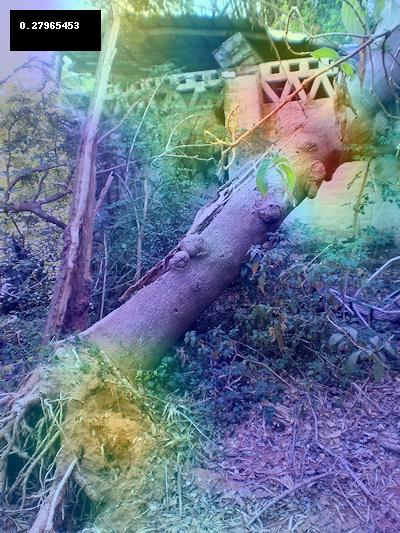

[[ 239.2451  -231.18309]]
predicted class:  DAMAGED
DSI Score:  0.3618065


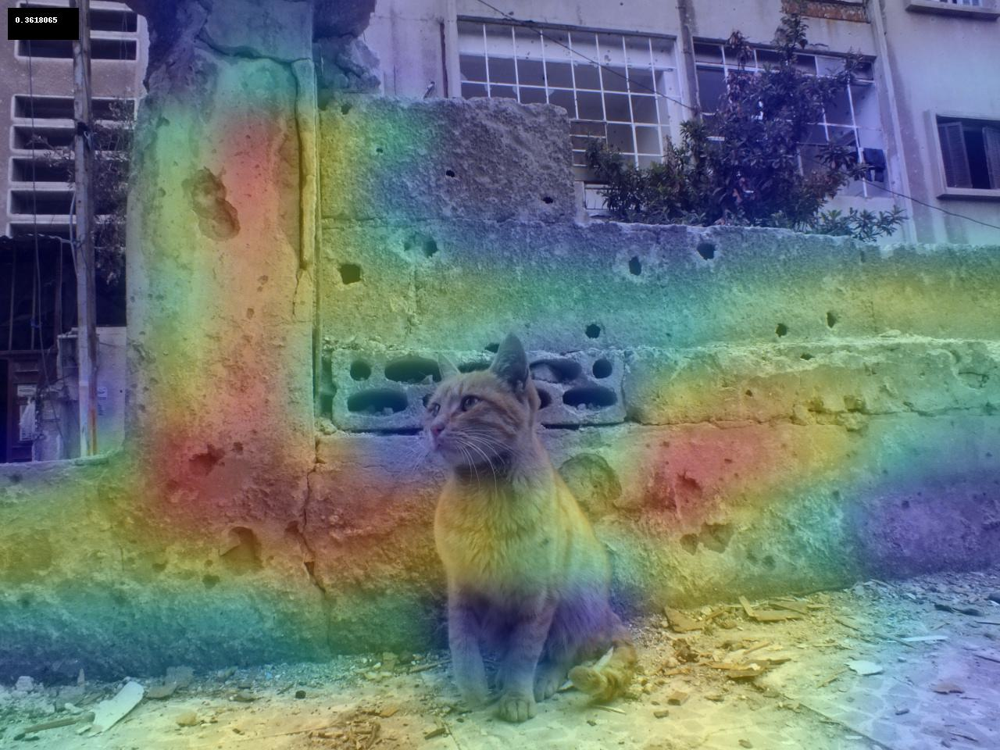

[[ 65.420815 -67.05171 ]]
predicted class:  DAMAGED
DSI Score:  0.22825377


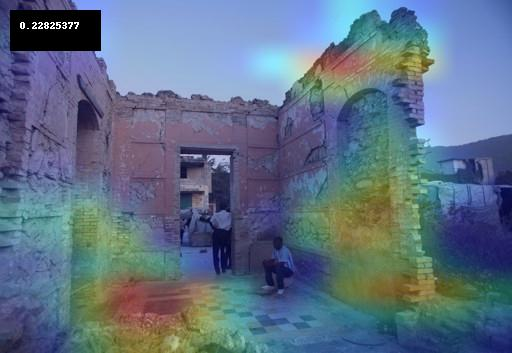

[[ 205.20708 -202.58582]]
predicted class:  DAMAGED
DSI Score:  0.18591252


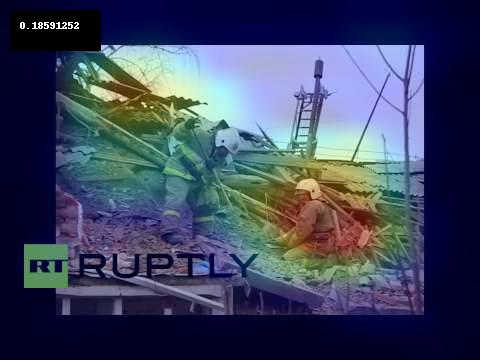

[[-44.783504  46.091812]]
predicted class:  NOT DAMAGED
DSI Score:  0.12021099


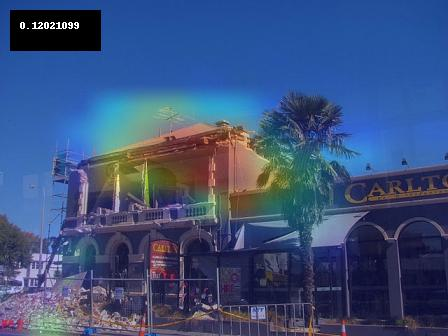

[[ 282.23422 -261.1887 ]]
predicted class:  DAMAGED
DSI Score:  0.22298035


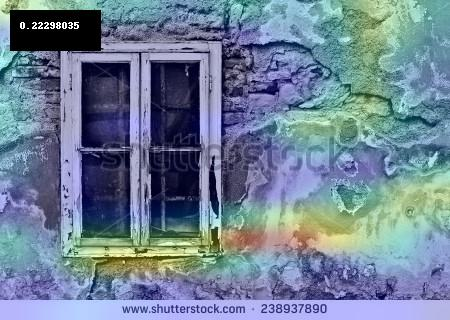

[[ 159.35396 -150.62424]]
predicted class:  DAMAGED
DSI Score:  0.20850405


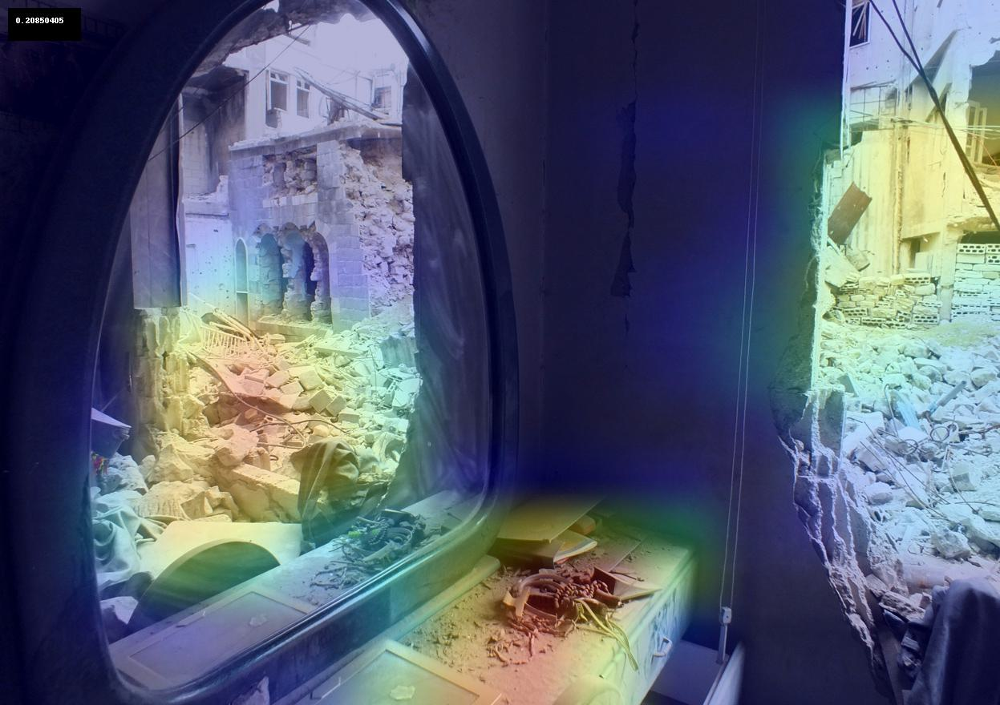

[[ 161.76541 -162.66934]]
predicted class:  DAMAGED
DSI Score:  0.24276096


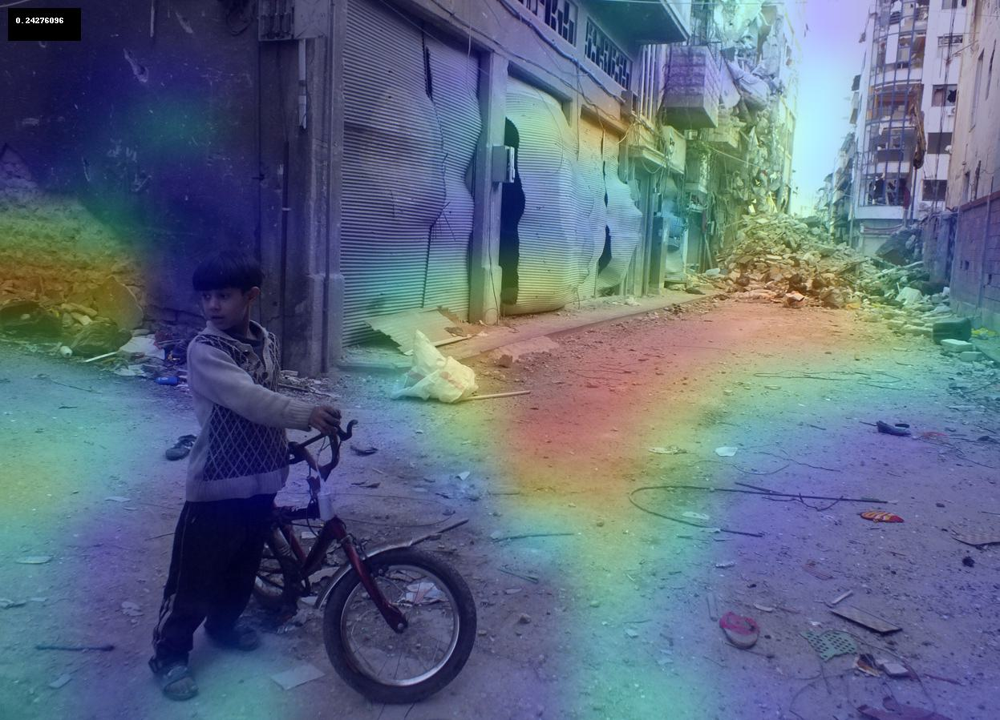

[[-186.02985  158.53372]]
predicted class:  NOT DAMAGED
DSI Score:  0.06192228


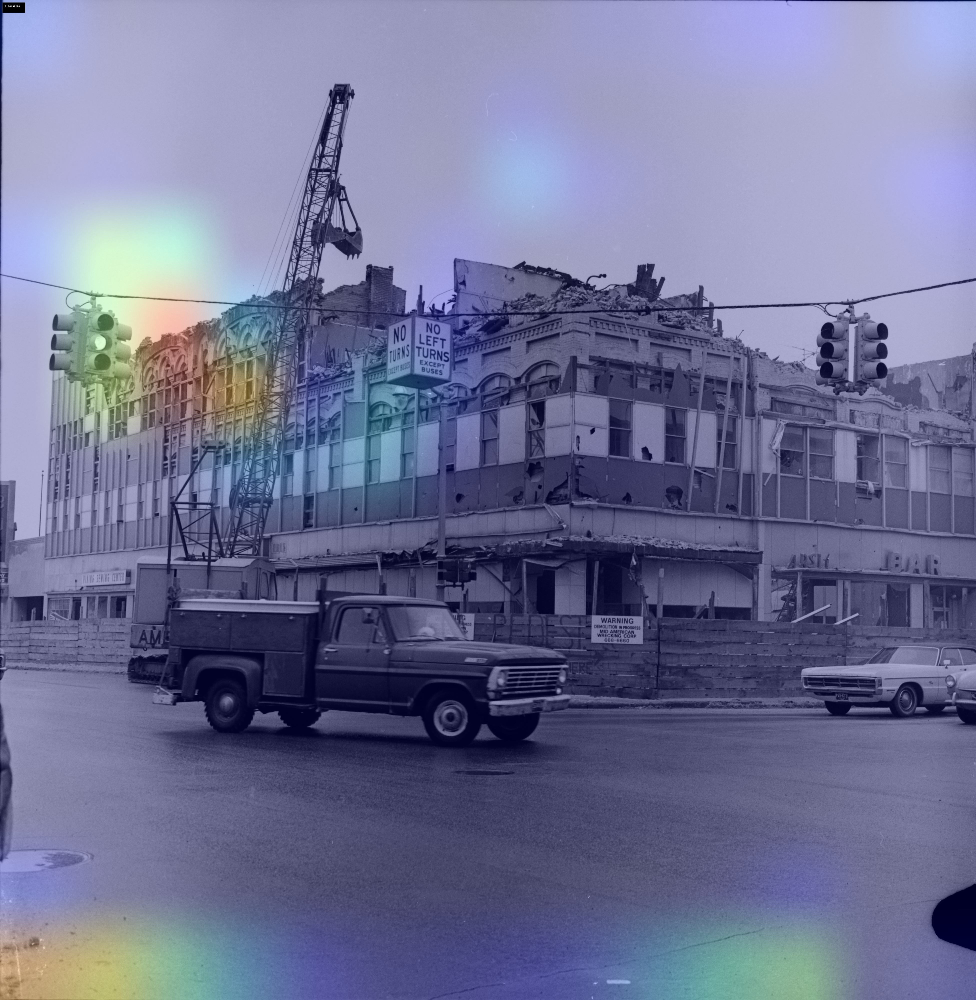

[[ 295.03384 -284.60843]]
predicted class:  DAMAGED
DSI Score:  0.3053619


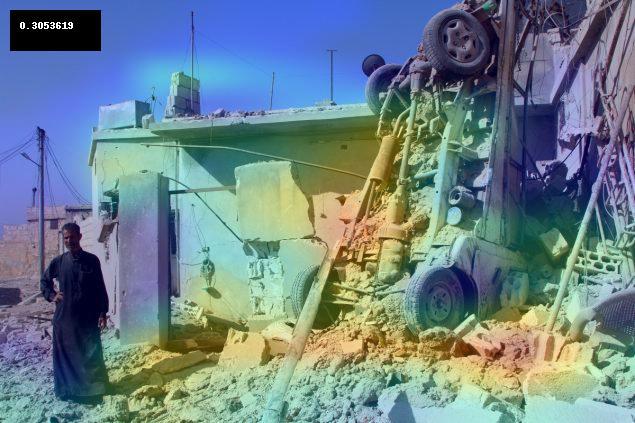

[[ 167.78212 -170.88998]]
predicted class:  DAMAGED
DSI Score:  0.2990183


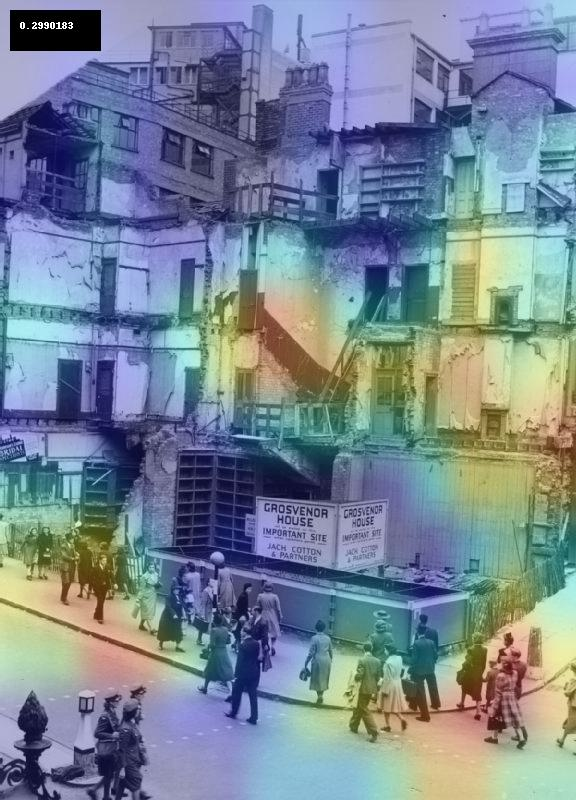

[[-145.13765  127.65007]]
predicted class:  NOT DAMAGED
DSI Score:  0.085424274


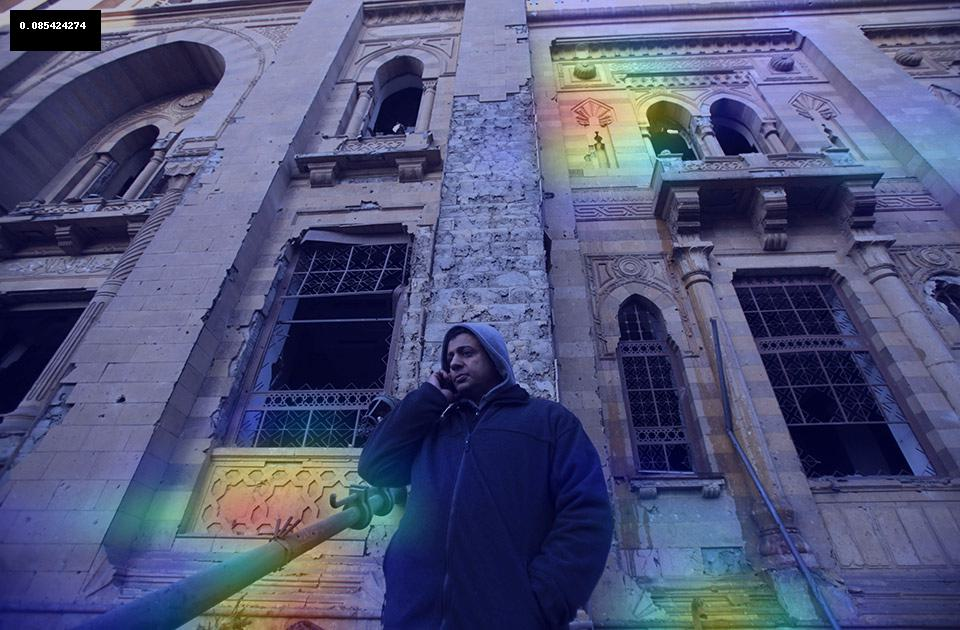

[[ 114.75572 -116.93272]]
predicted class:  DAMAGED
DSI Score:  0.12904762


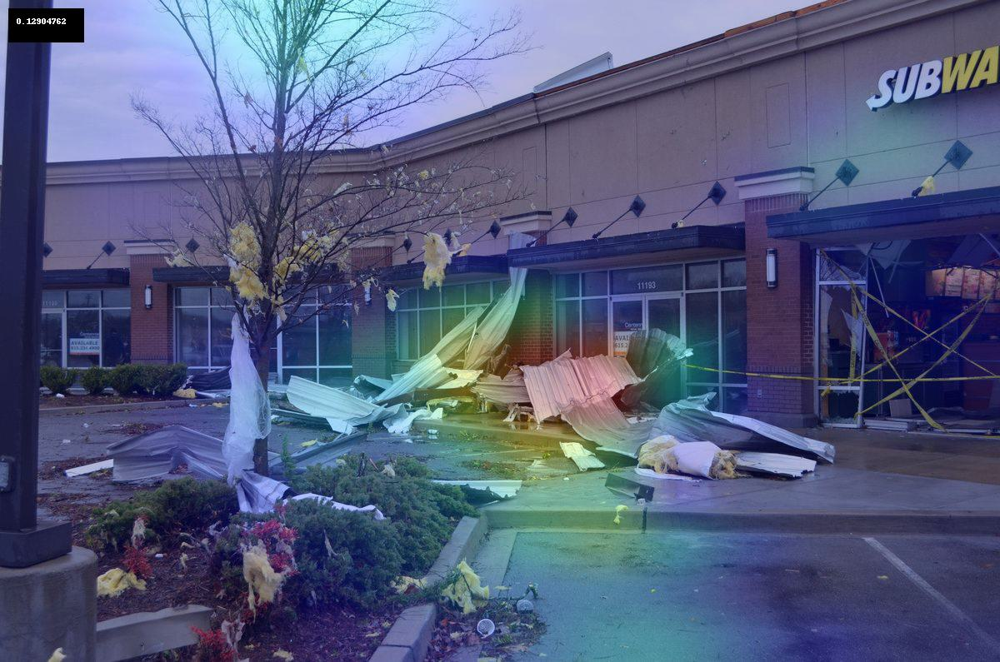

[[-0.9166556 -0.6382191]]
predicted class:  NOT DAMAGED
DSI Score:  0.13528194


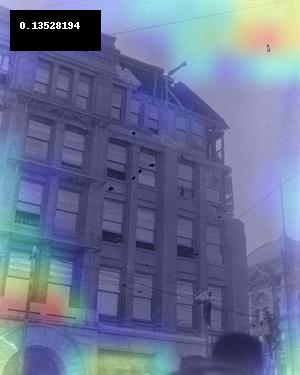

[[-5.6874723  4.1515875]]
predicted class:  NOT DAMAGED
DSI Score:  0.16647051


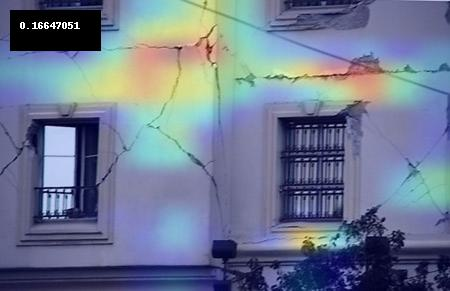

[[-21.327131  15.419416]]
predicted class:  NOT DAMAGED
DSI Score:  0.123548925


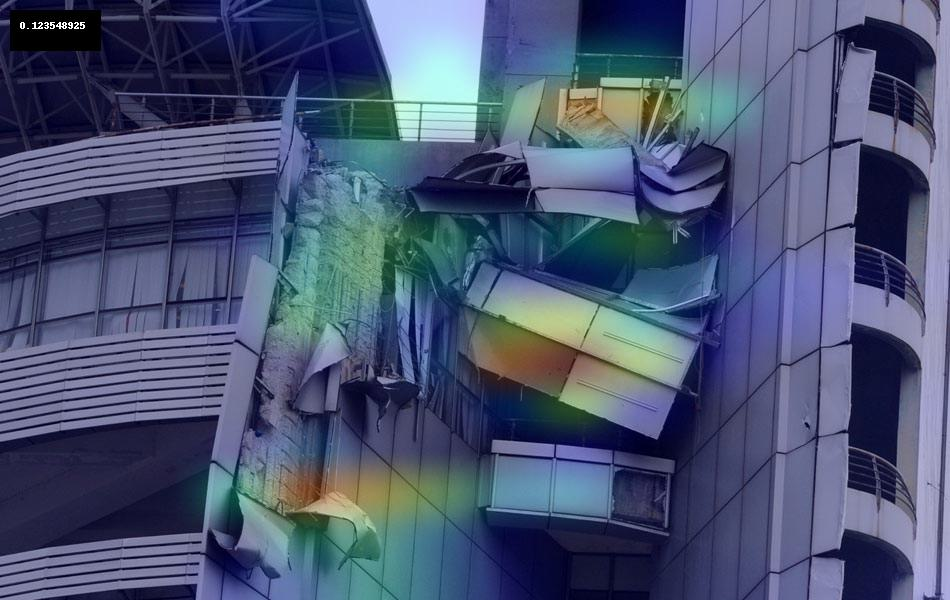

[[ 129.27718 -132.09798]]
predicted class:  DAMAGED
DSI Score:  0.09332368


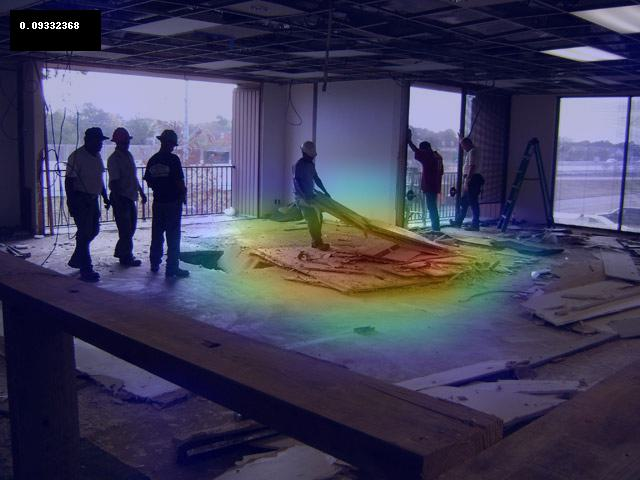

[[ 134.92642 -135.39319]]
predicted class:  DAMAGED
DSI Score:  0.32531932


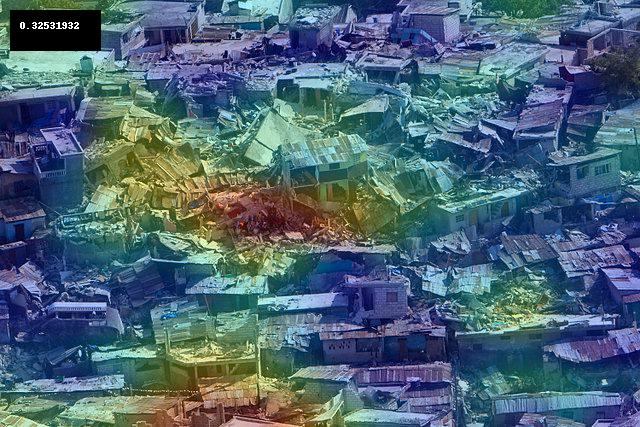

[[-31.71745   42.444927]]
predicted class:  NOT DAMAGED
DSI Score:  0.12291104


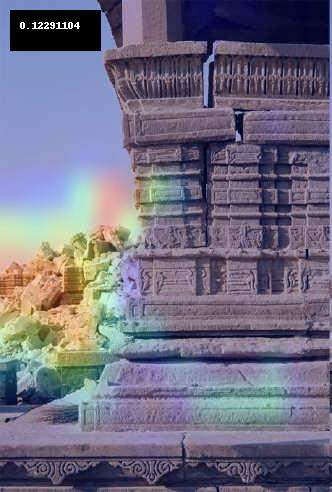

[[ 113.88564 -110.57468]]
predicted class:  DAMAGED
DSI Score:  0.28997323


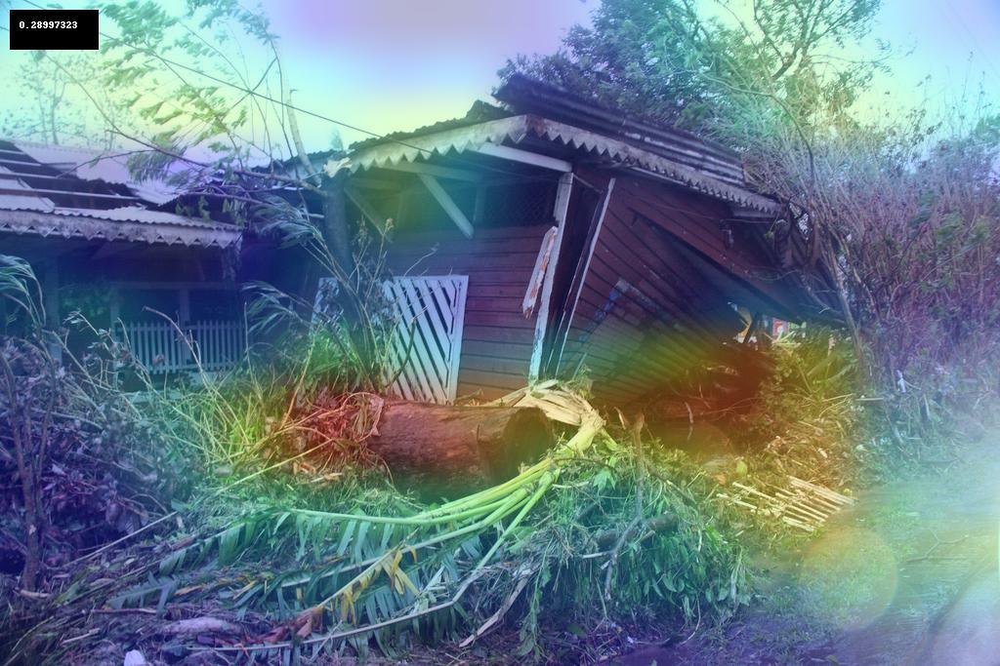

[[ 142.61128 -143.65195]]
predicted class:  DAMAGED
DSI Score:  0.3386035


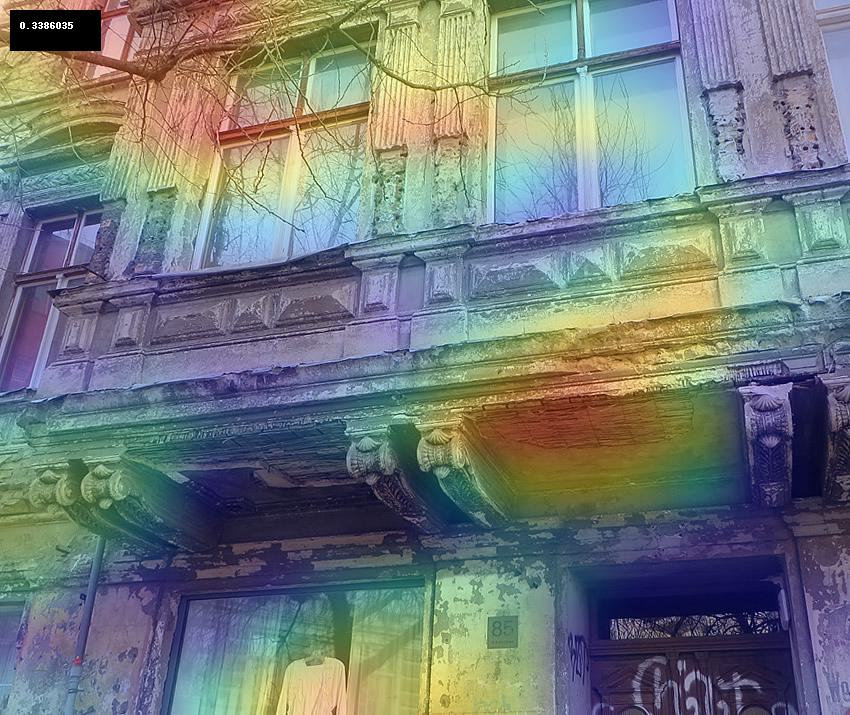

[[ 172.50879 -168.94882]]
predicted class:  DAMAGED
DSI Score:  0.27767038


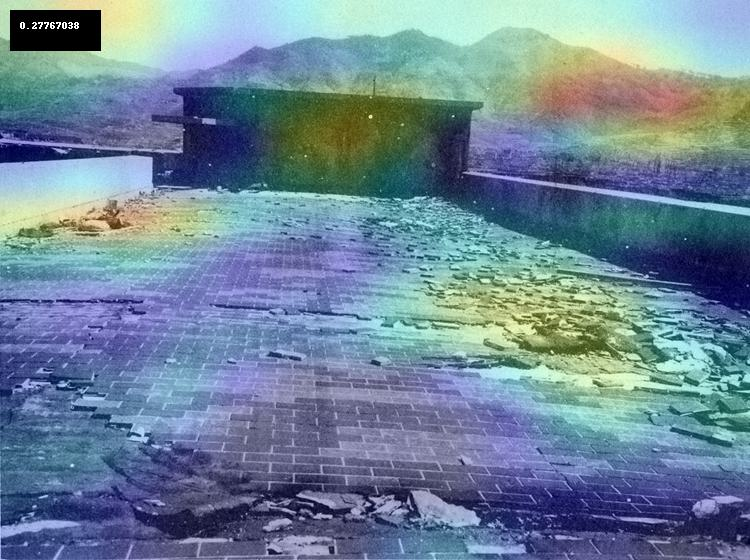

[[ 397.68674 -392.33902]]
predicted class:  DAMAGED
DSI Score:  0.37524584


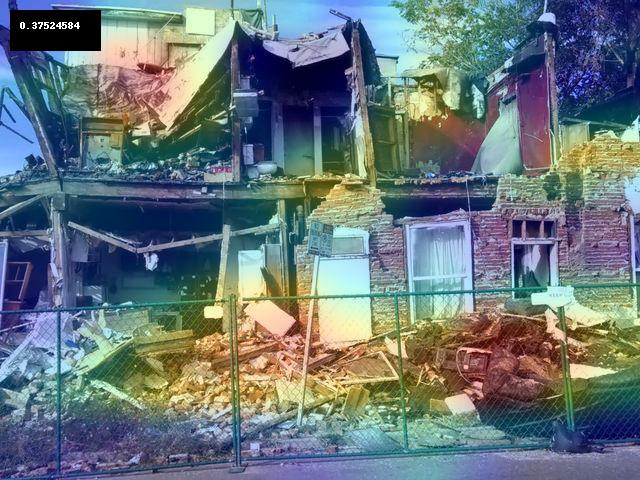

[[-44.367043  40.469315]]
predicted class:  NOT DAMAGED
DSI Score:  0.09494339


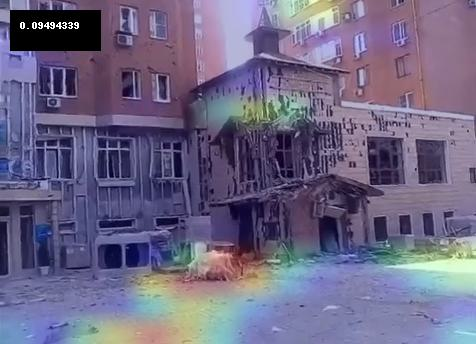

[[100.57021 -96.20374]]
predicted class:  DAMAGED
DSI Score:  0.20379637


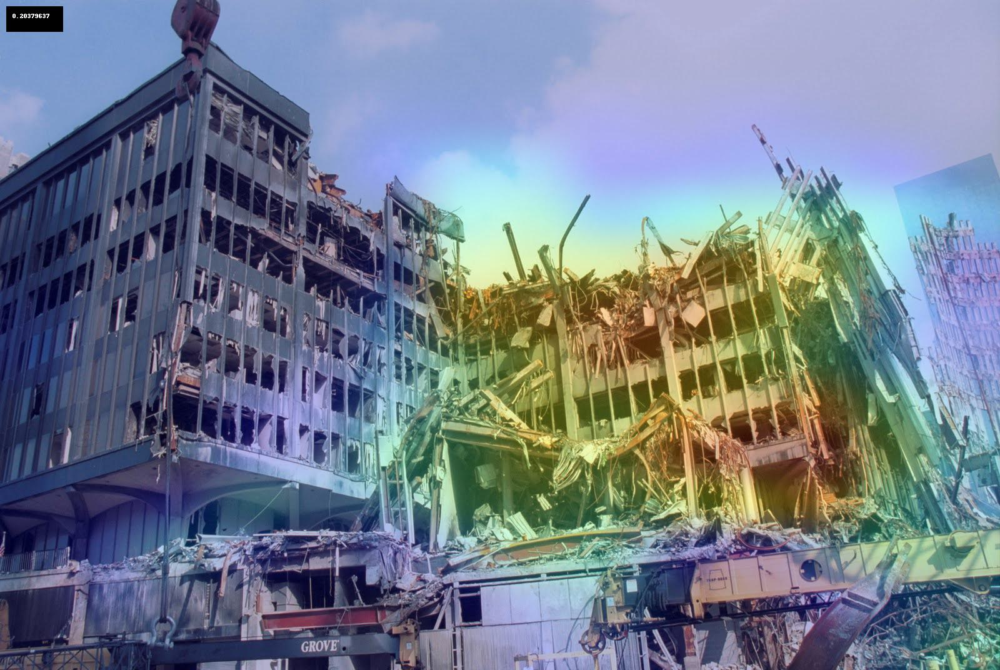

[[ 107.90722 -111.43629]]
predicted class:  DAMAGED
DSI Score:  0.24164748


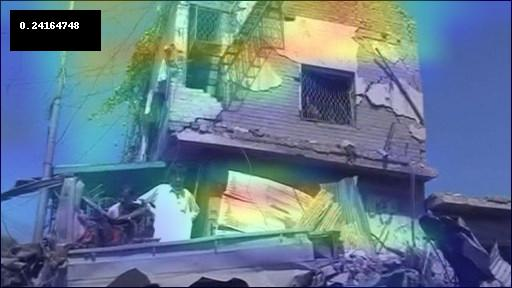

[[ 284.43515 -276.9427 ]]
predicted class:  DAMAGED
DSI Score:  0.26238784


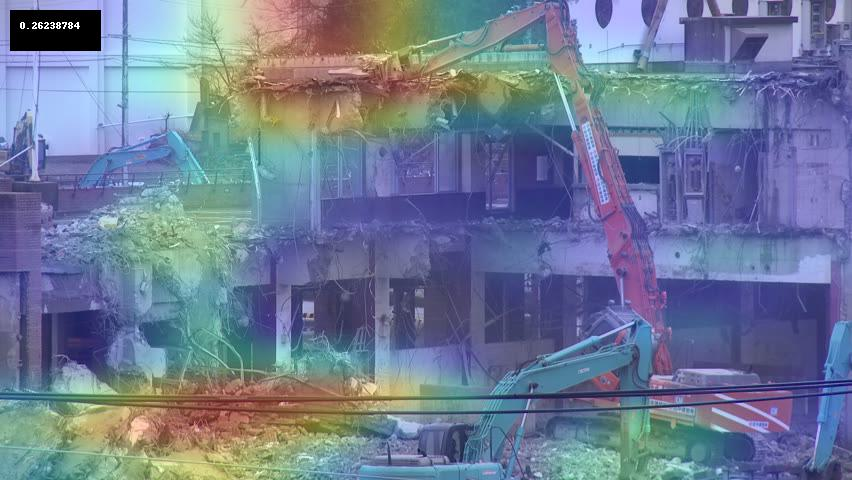

[[ 252.8668  -247.46423]]
predicted class:  DAMAGED
DSI Score:  0.28206193


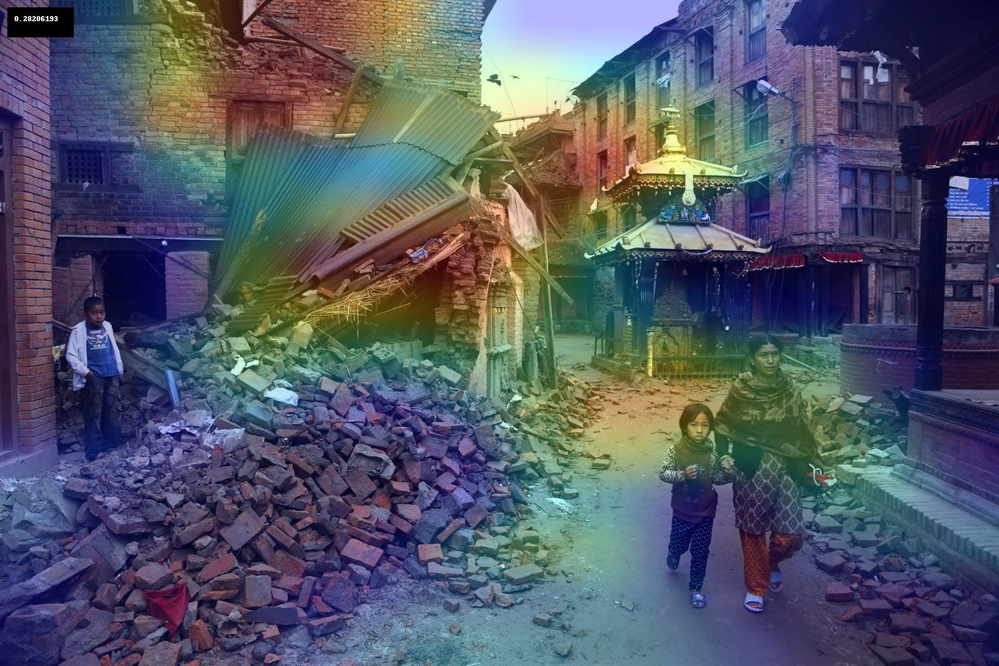

[[ 456.53125 -441.08972]]
predicted class:  DAMAGED
DSI Score:  0.331746


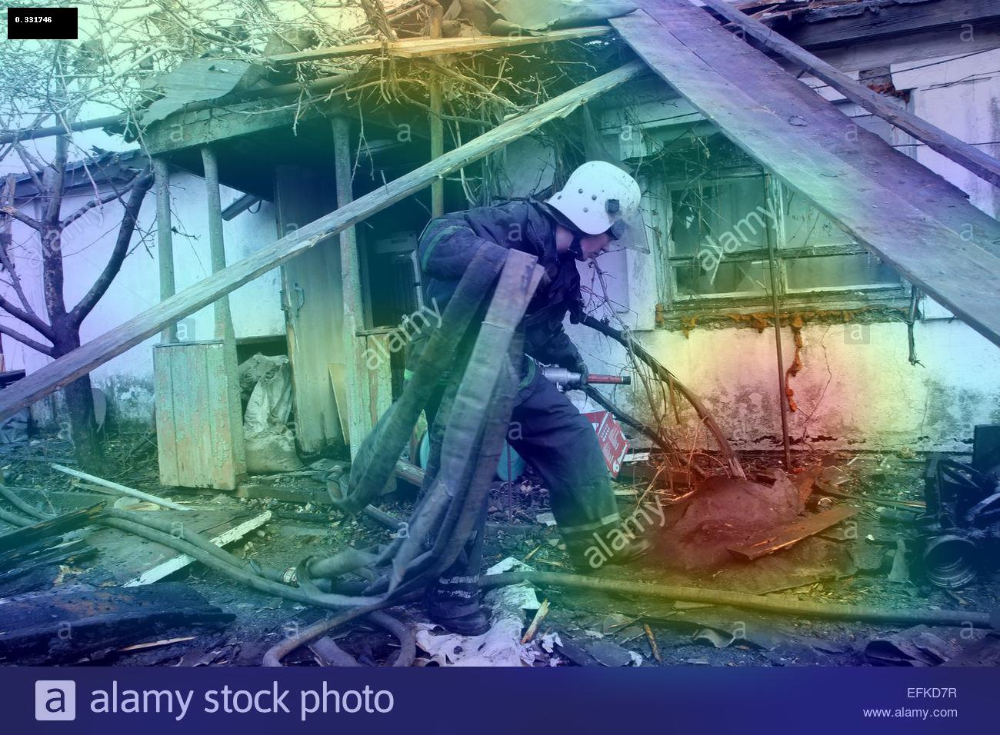

[[ 149.27481 -155.2937 ]]
predicted class:  DAMAGED
DSI Score:  0.2590136


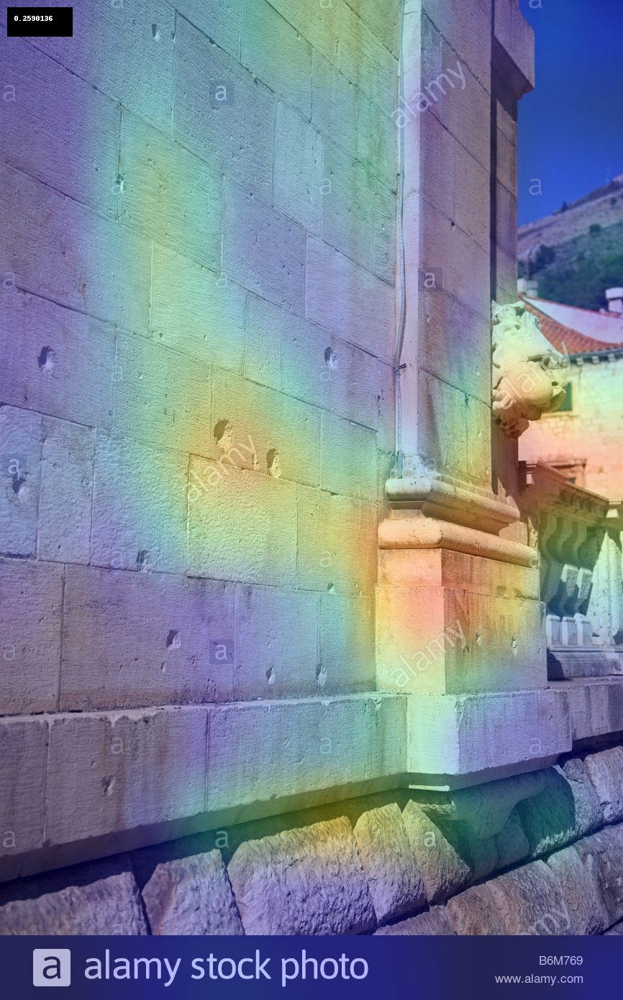

[[ 329.3459  -326.84708]]
predicted class:  DAMAGED
DSI Score:  0.2306858


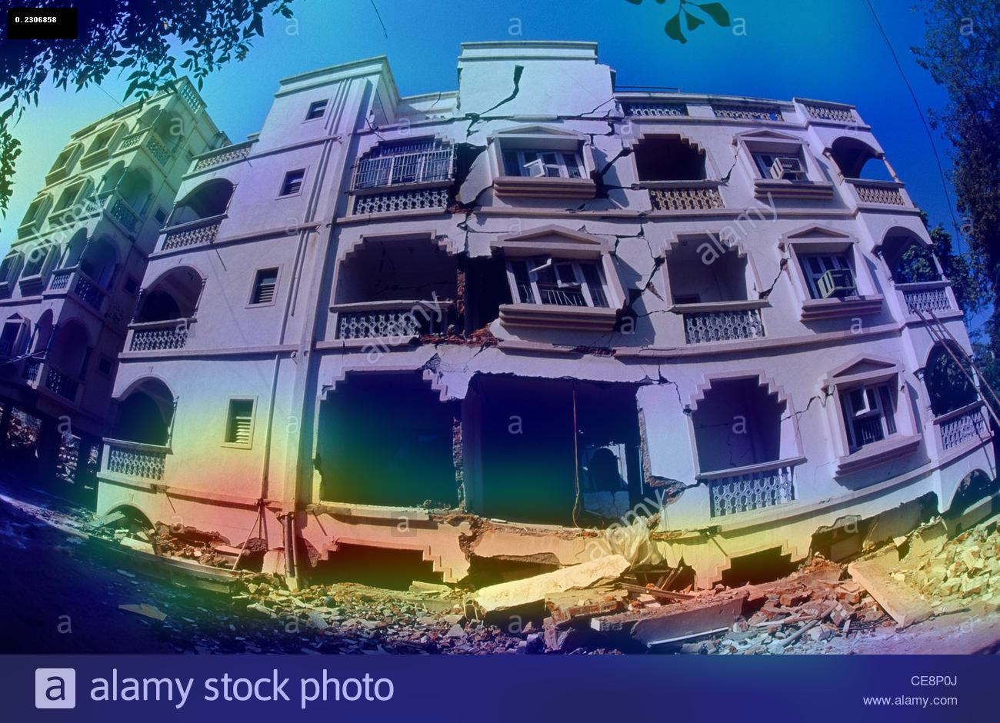

[[ 459.63205 -438.5317 ]]
predicted class:  DAMAGED
DSI Score:  0.278812


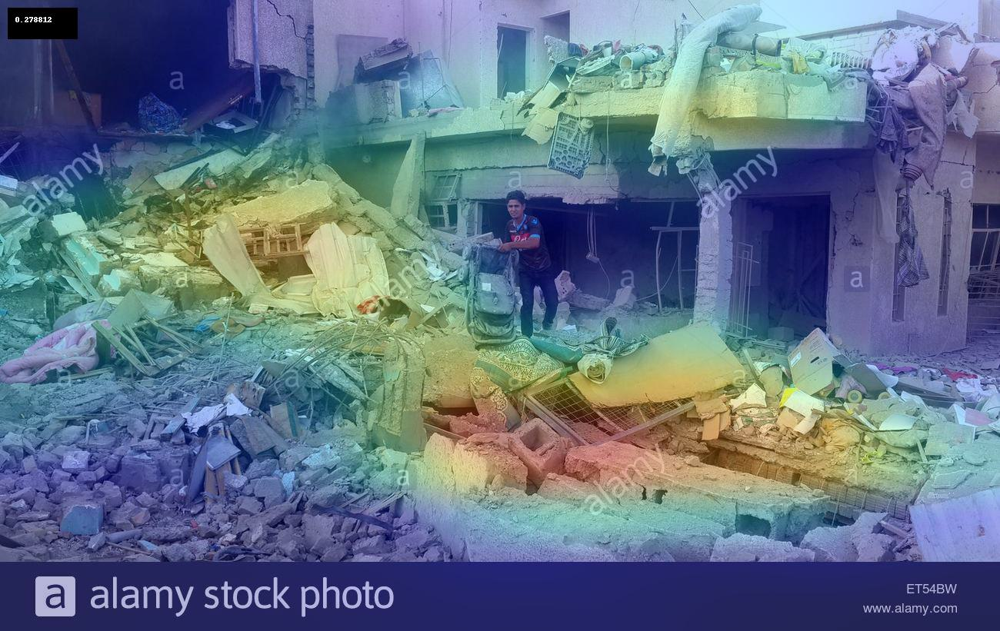

[[ 60.046696 -56.669918]]
predicted class:  DAMAGED
DSI Score:  0.3119589


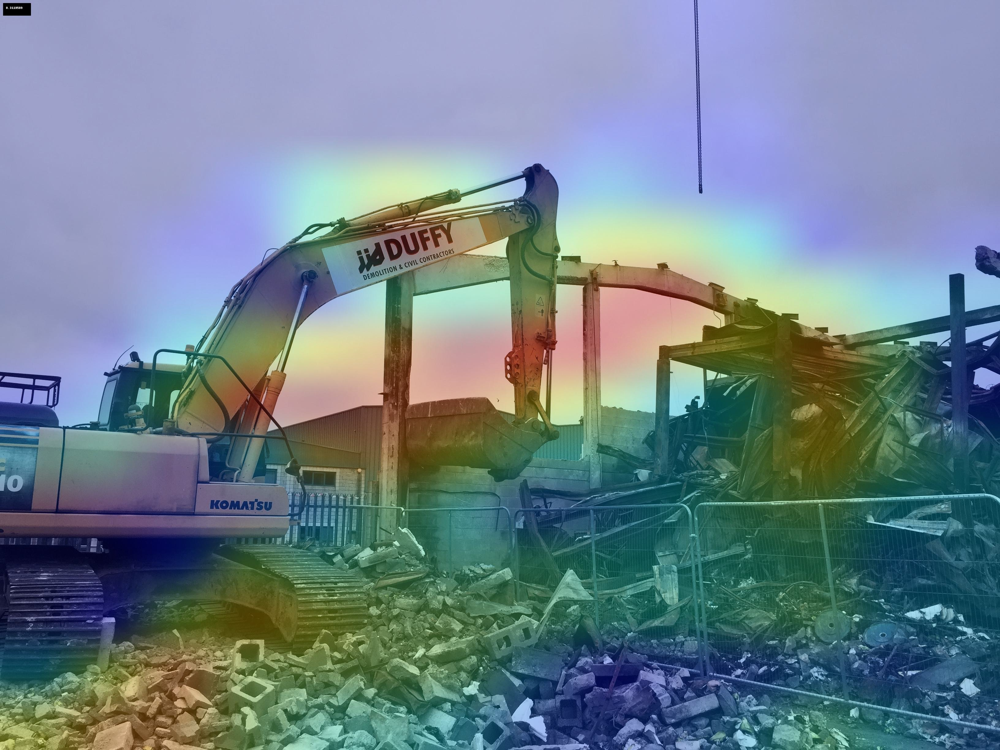

[[ 168.49574 -173.98343]]
predicted class:  DAMAGED
DSI Score:  0.16904153


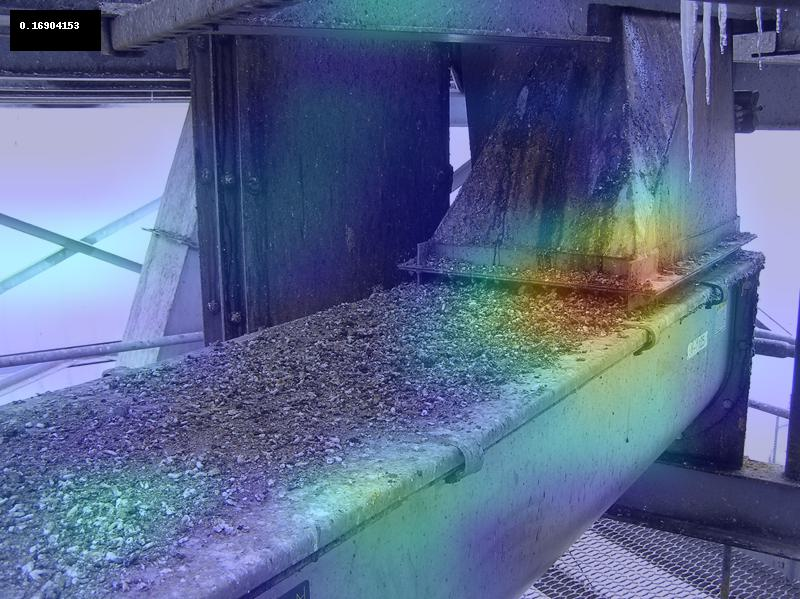

[[ 38.098312 -41.186954]]
predicted class:  DAMAGED
DSI Score:  0.18867522


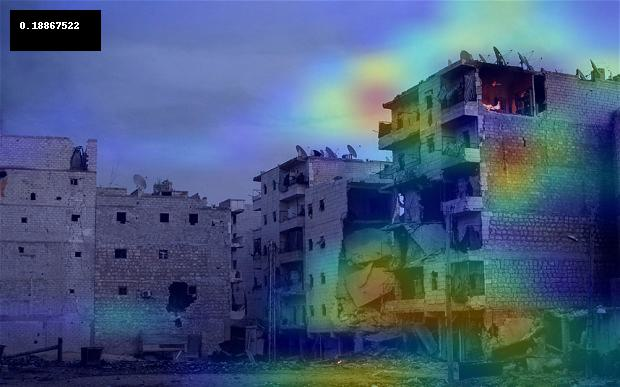

[[ 237.2067  -232.49411]]
predicted class:  DAMAGED
DSI Score:  0.13864906


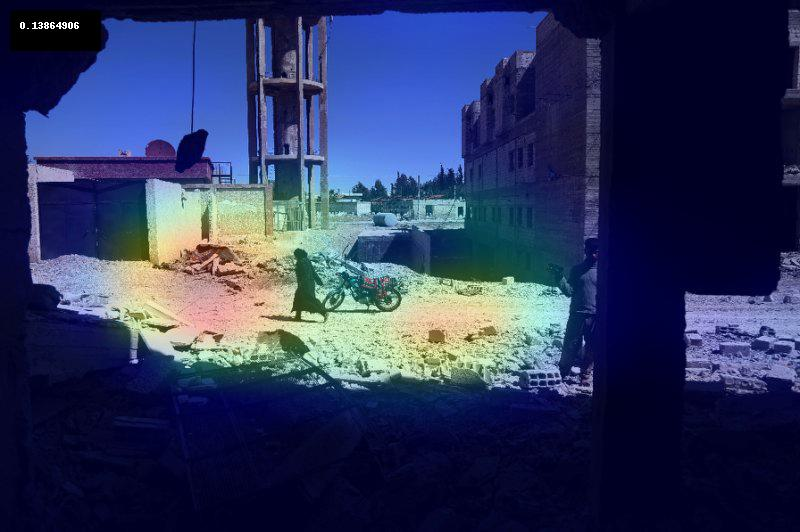

[[-108.4823   93.6098]]
predicted class:  NOT DAMAGED
DSI Score:  0.12206752


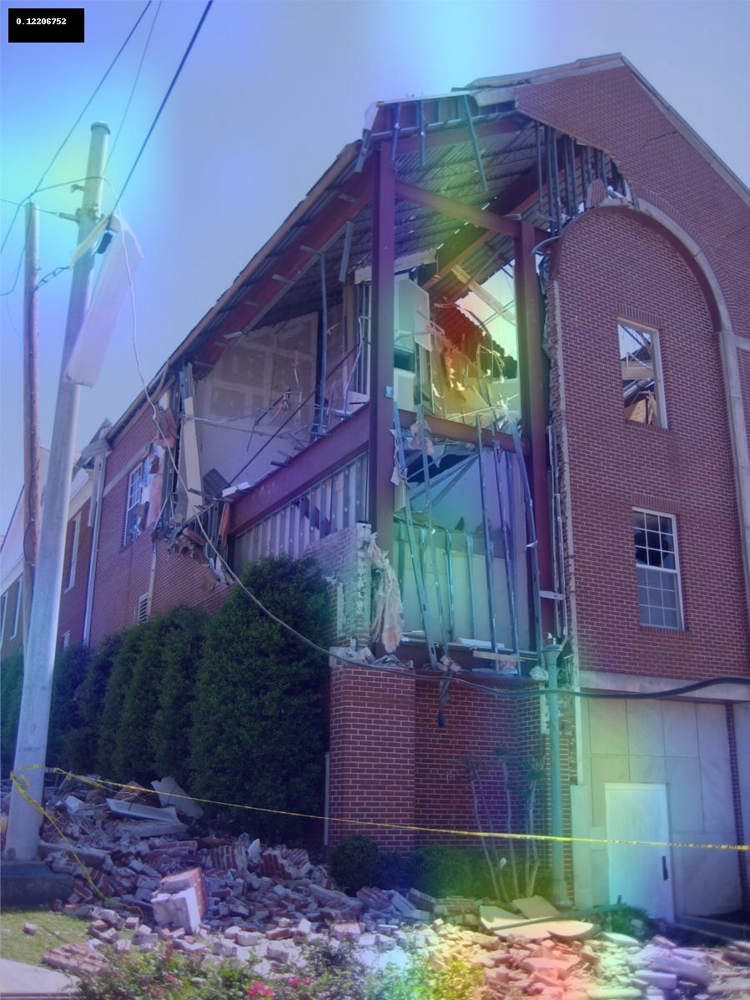

[[-142.01952  132.57048]]
predicted class:  NOT DAMAGED
DSI Score:  0.03281363


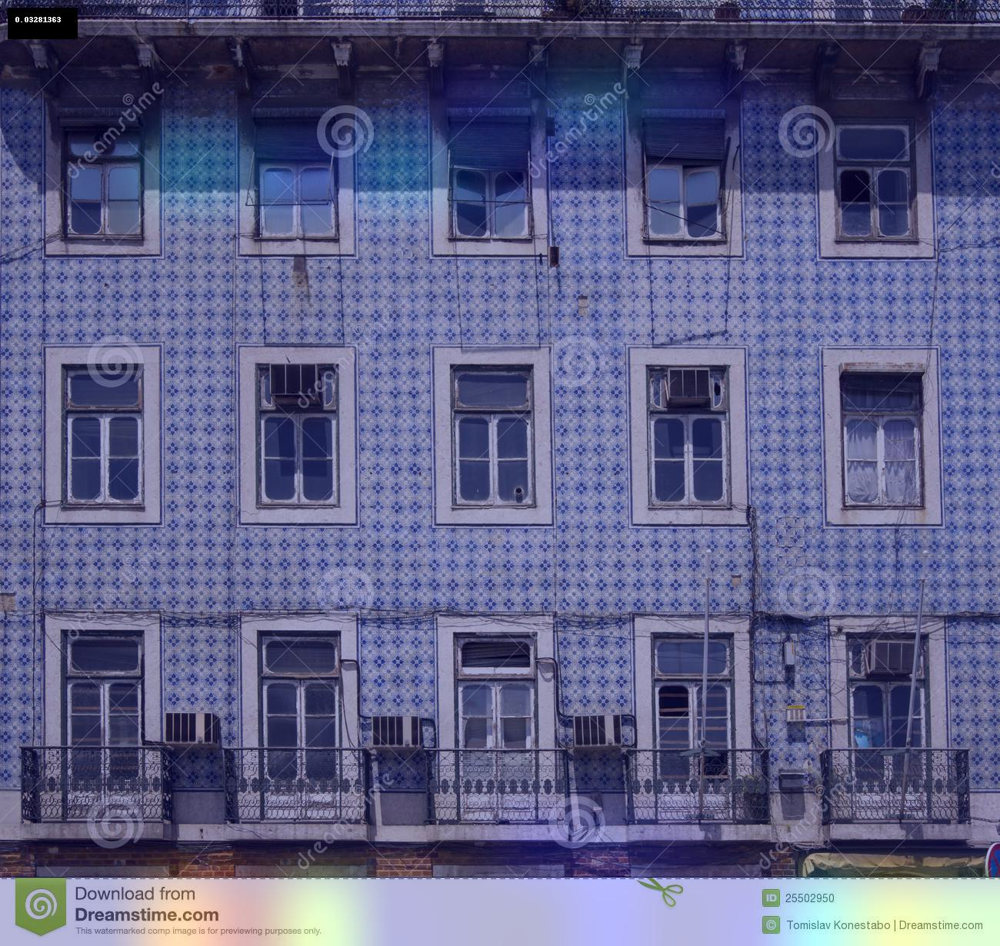

[[ 207.58047 -205.51765]]
predicted class:  DAMAGED
DSI Score:  0.19189057


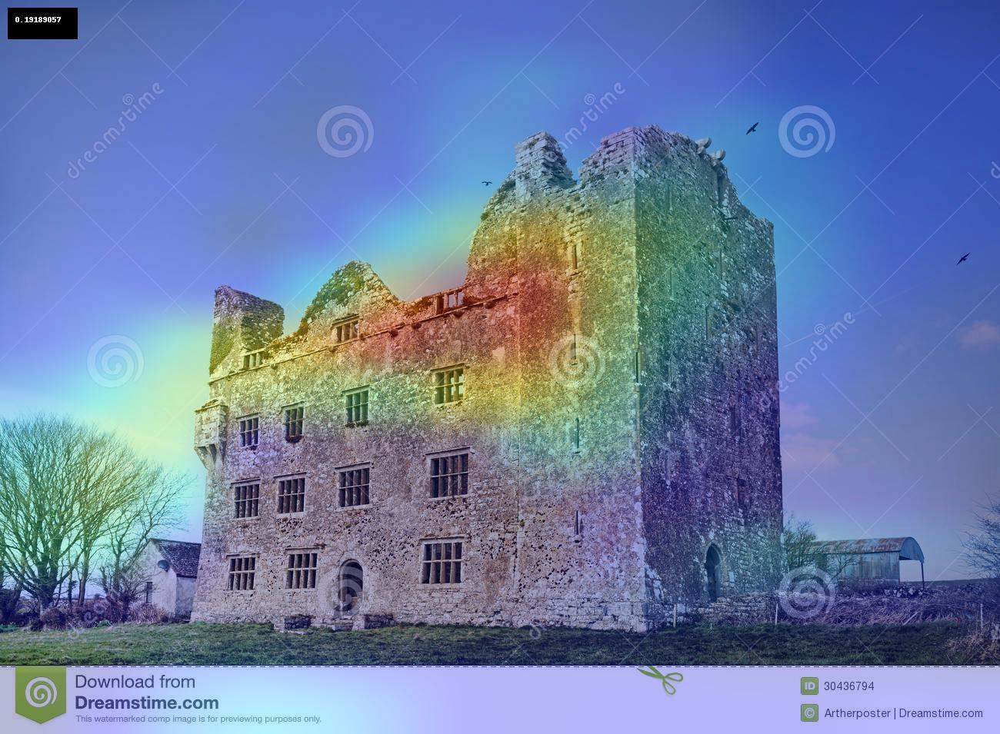

[[ 447.64328 -430.19794]]
predicted class:  DAMAGED
DSI Score:  0.4228616


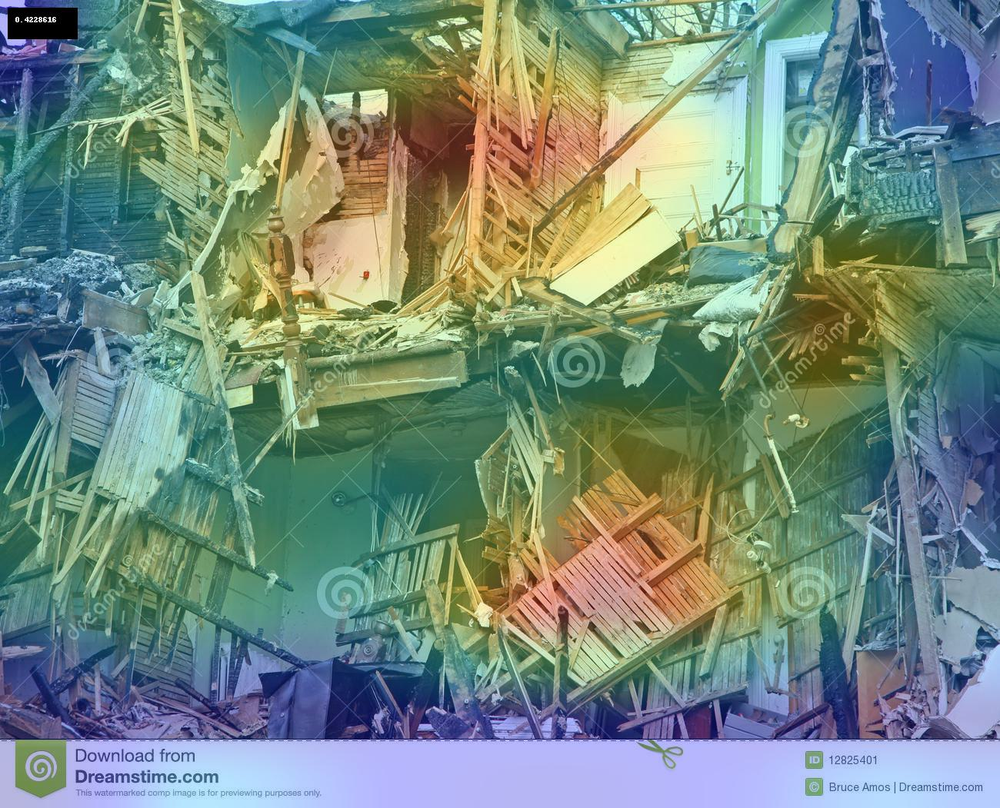

[[ 271.29898 -269.66376]]
predicted class:  DAMAGED
DSI Score:  0.21687242


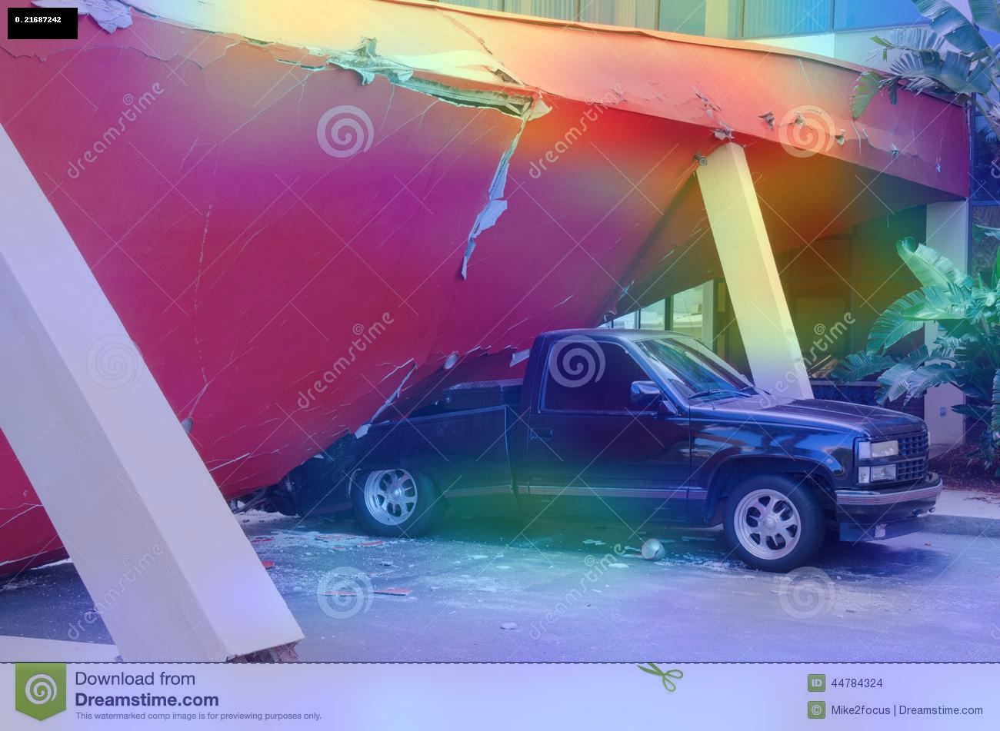

[[-52.910275  49.586906]]
predicted class:  NOT DAMAGED
DSI Score:  0.07397468


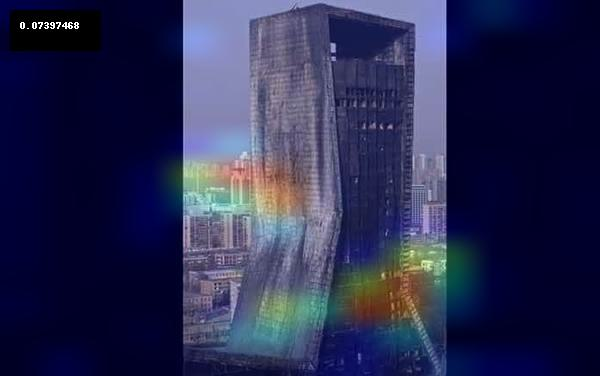

[[ 191.10391 -183.09726]]
predicted class:  DAMAGED
DSI Score:  0.16071226


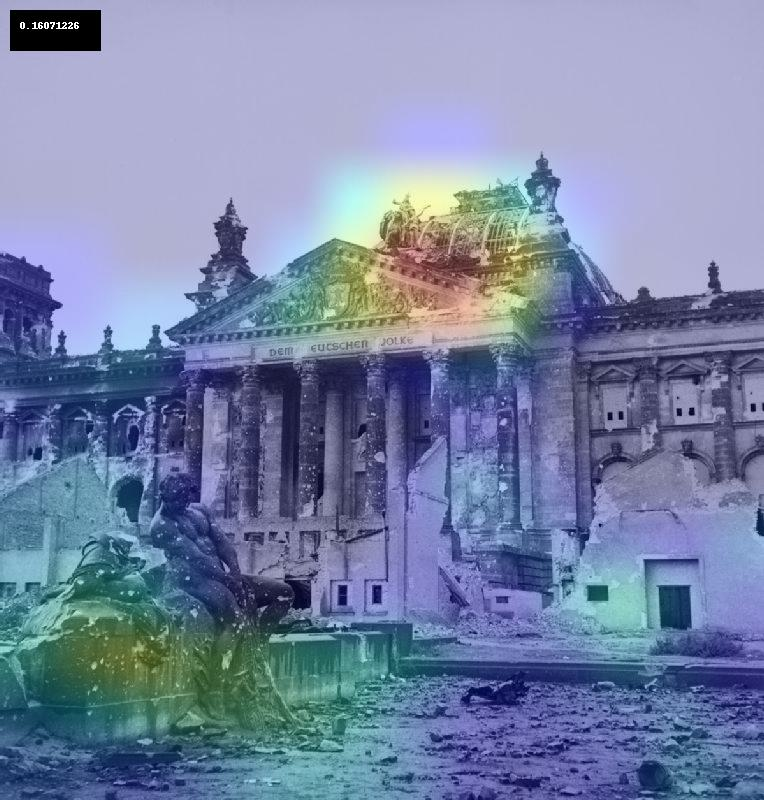

[[-48.10182   44.299427]]
predicted class:  NOT DAMAGED
DSI Score:  0.17628954


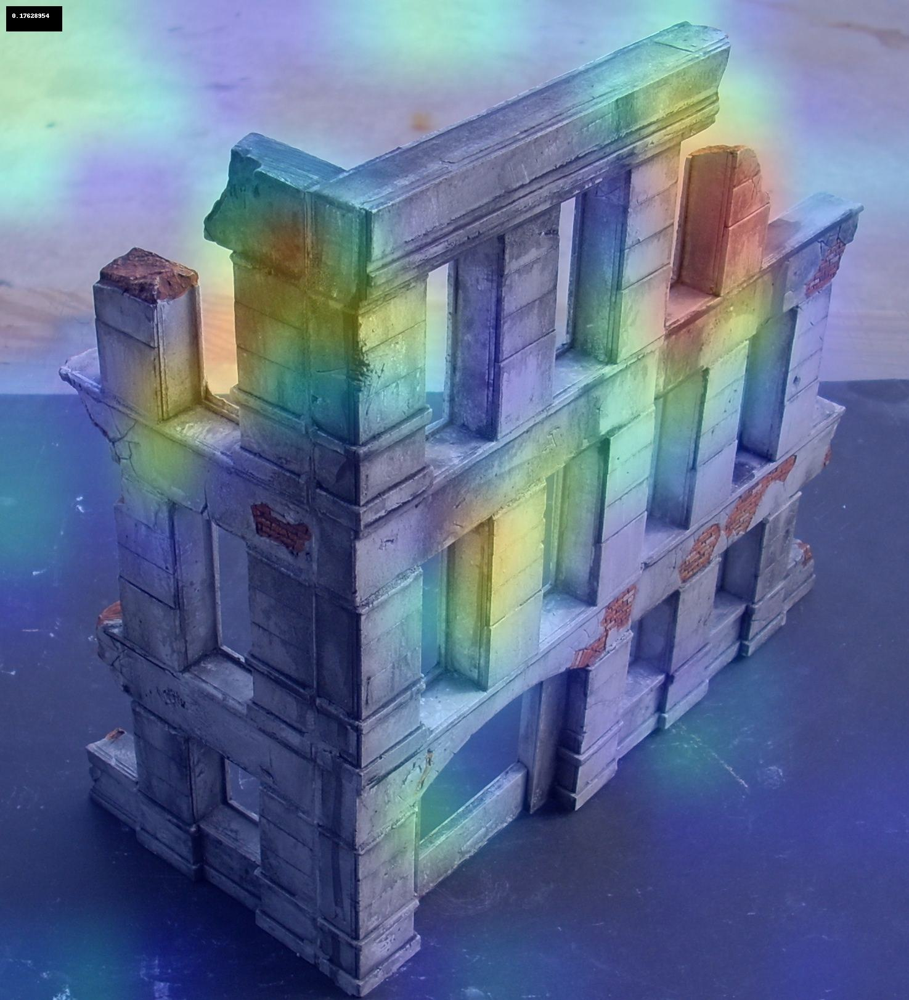

[[ 304.0447 -298.5186]]
predicted class:  DAMAGED
DSI Score:  0.253763


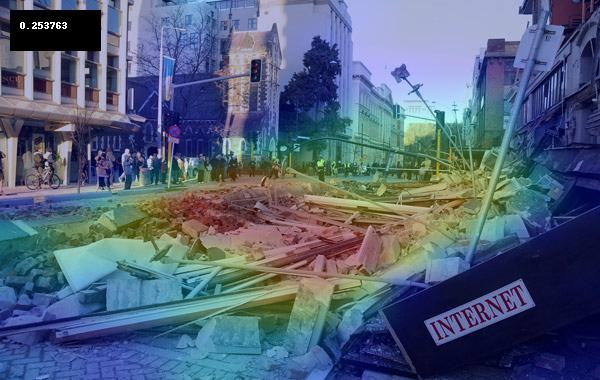

[[ 237.84293 -230.29926]]
predicted class:  DAMAGED
DSI Score:  0.3770201


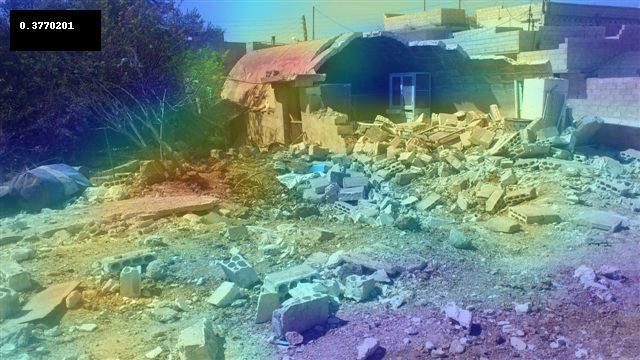

[[ 153.76373 -154.05847]]
predicted class:  DAMAGED
DSI Score:  0.248302


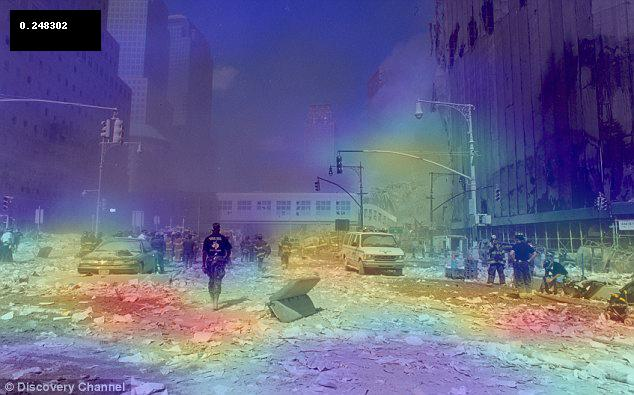

[[ 321.55203 -310.27618]]
predicted class:  DAMAGED
DSI Score:  0.251816


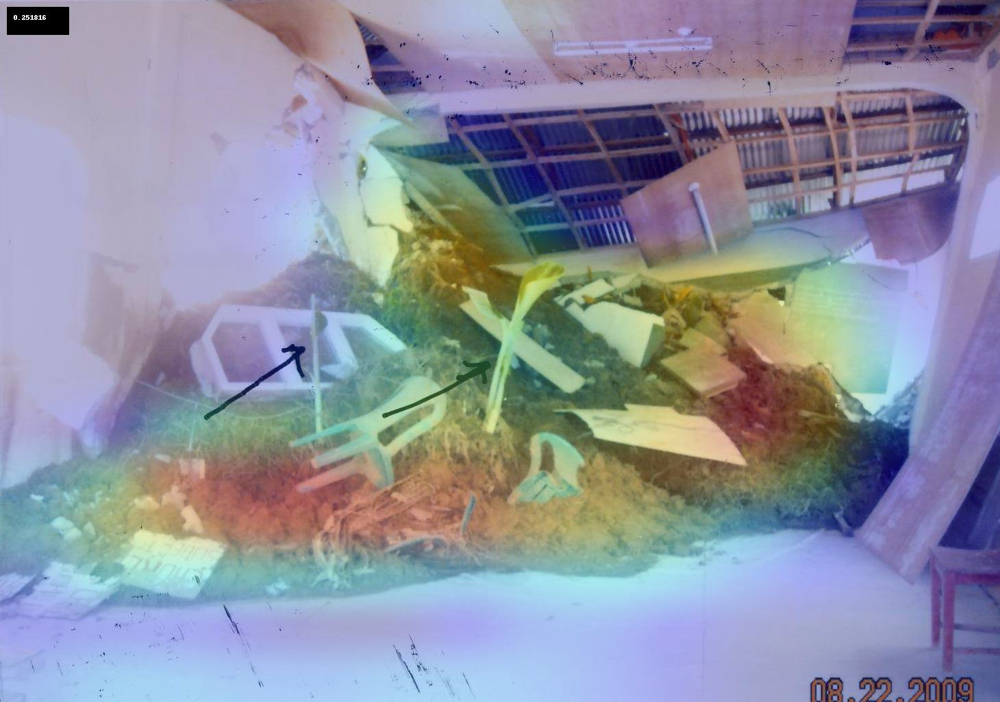

[[ 65.337776 -64.85359 ]]
predicted class:  DAMAGED
DSI Score:  0.13399361


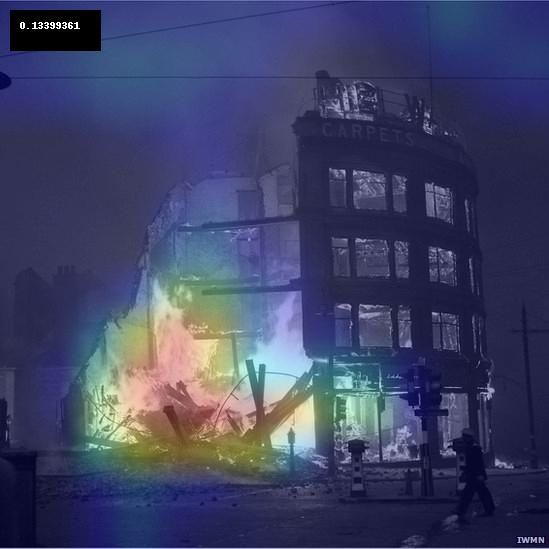

[[-61.94911  73.16013]]
predicted class:  NOT DAMAGED
DSI Score:  0.07321


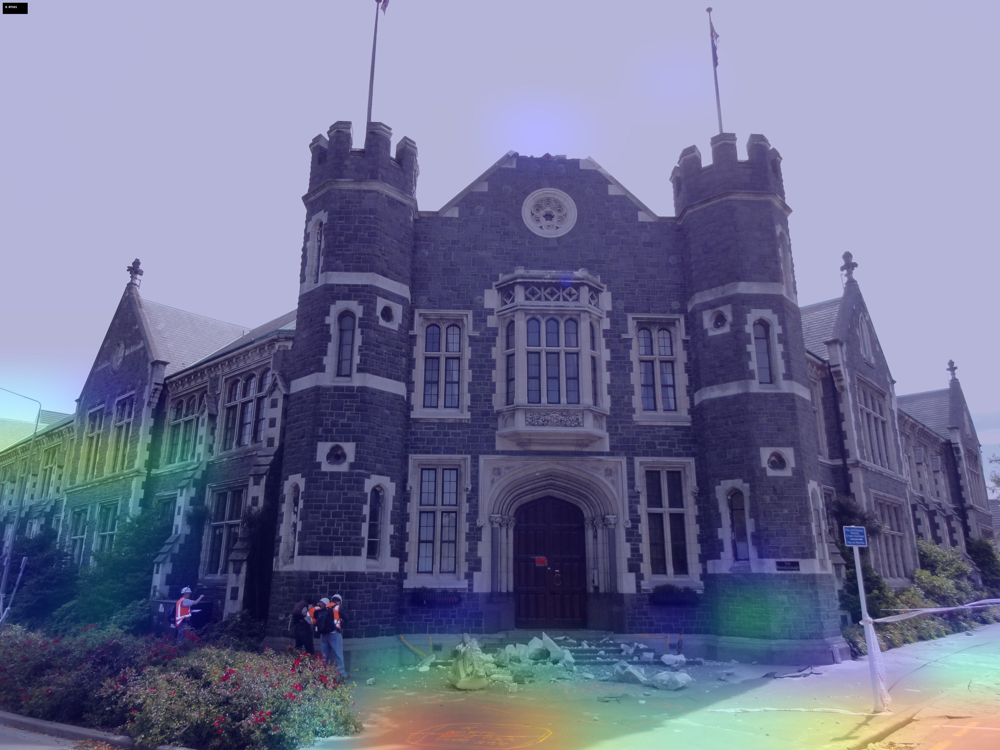

[[ 188.37625 -185.7427 ]]
predicted class:  DAMAGED
DSI Score:  0.17391038


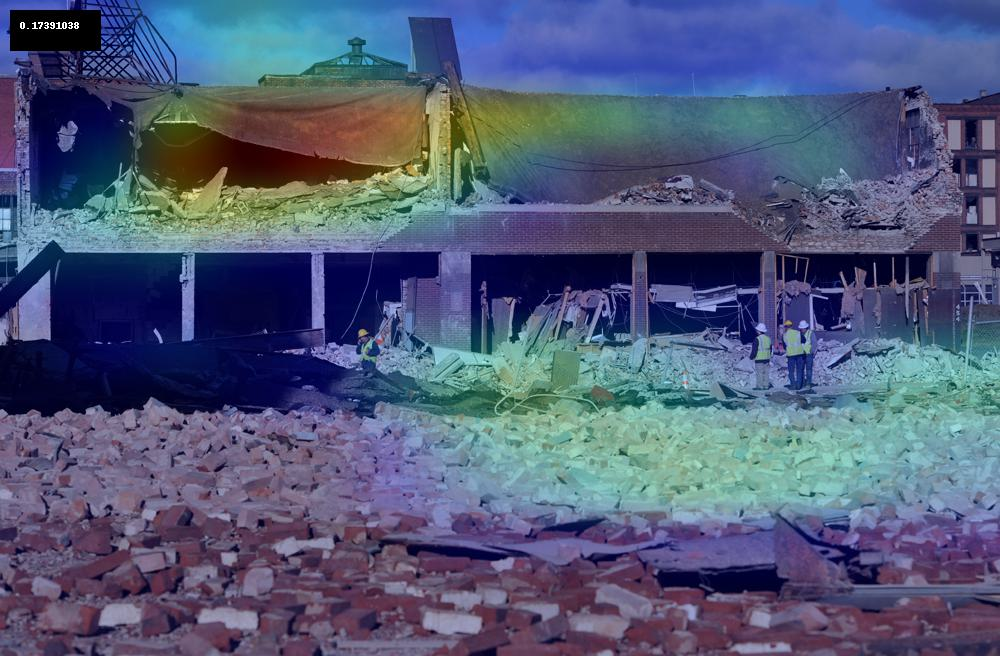

[[ 198.08888 -201.6554 ]]
predicted class:  DAMAGED
DSI Score:  0.17529501


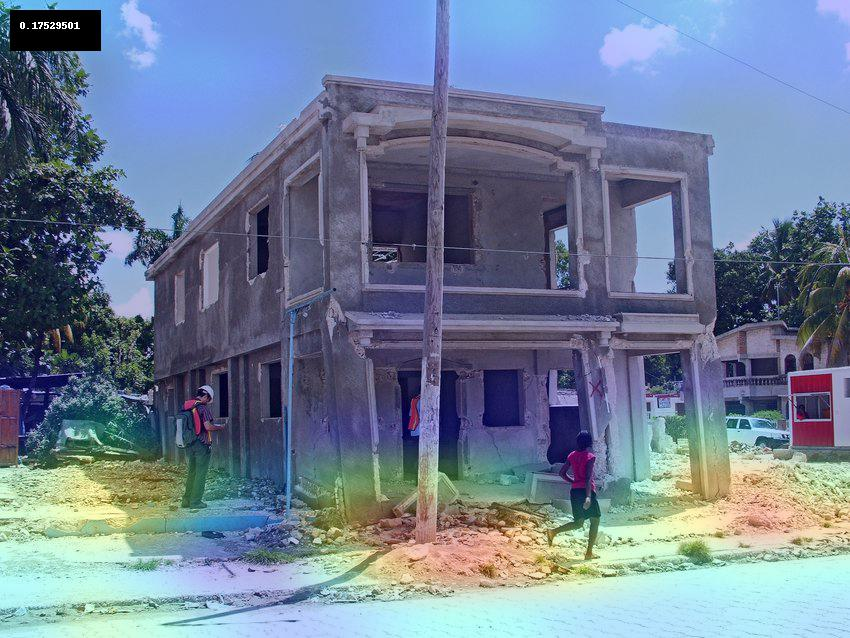

[[-166.93369  152.85516]]
predicted class:  NOT DAMAGED
DSI Score:  0.02283086


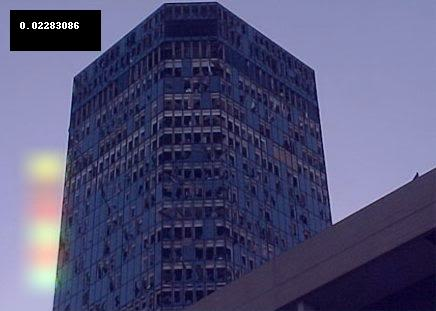

[[-33.994305  30.052963]]
predicted class:  NOT DAMAGED
DSI Score:  0.07066718


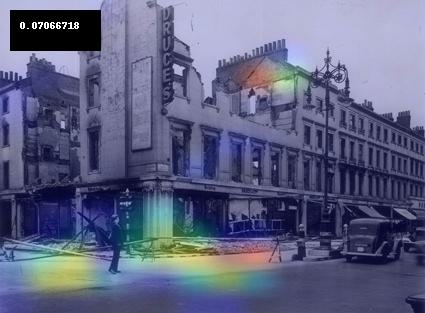

[[ 205.82043 -208.33075]]
predicted class:  DAMAGED
DSI Score:  0.15244433


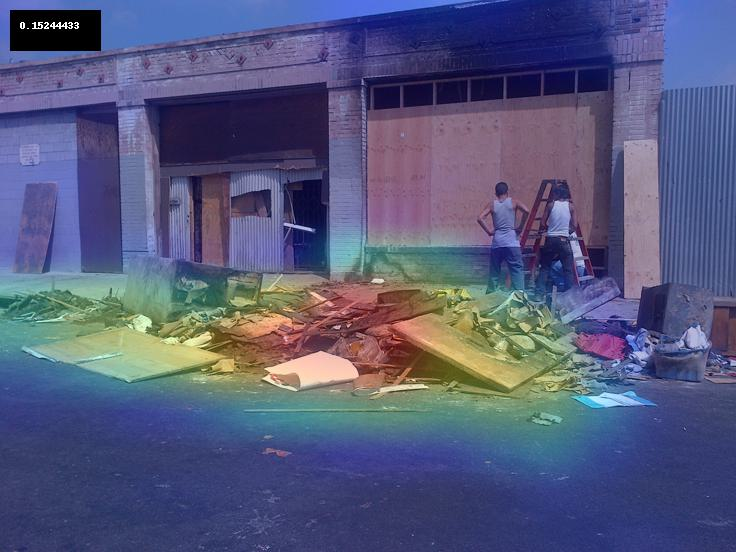

[[-248.51096  218.137  ]]
predicted class:  NOT DAMAGED
DSI Score:  0.04721029


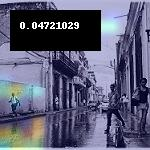

[[-525.6397   493.91144]]
predicted class:  NOT DAMAGED
DSI Score:  0.10142715


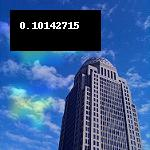

[[-288.71518  258.96402]]
predicted class:  NOT DAMAGED
DSI Score:  0.023524465


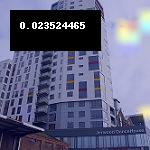

[[-277.04544  247.59924]]
predicted class:  NOT DAMAGED
DSI Score:  0.05958005


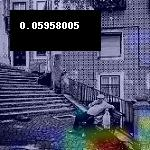

[[-146.14369  131.36453]]
predicted class:  NOT DAMAGED
DSI Score:  0.017756142


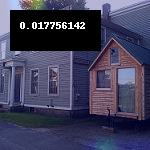

[[-159.0077   145.06346]]
predicted class:  NOT DAMAGED
DSI Score:  0.026622772


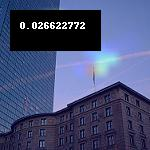

[[-307.97794  281.09155]]
predicted class:  NOT DAMAGED
DSI Score:  0.00804086


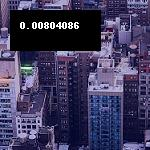

[[-204.80838  188.88676]]
predicted class:  NOT DAMAGED
DSI Score:  0.013244598


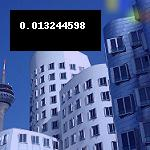

[[-171.83383  157.84317]]
predicted class:  NOT DAMAGED
DSI Score:  0.028774269


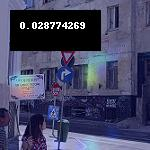

[[-215.64432  192.24316]]
predicted class:  NOT DAMAGED
DSI Score:  0.030866856


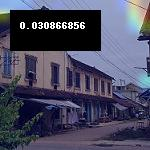

[[-163.85541  151.04114]]
predicted class:  NOT DAMAGED
DSI Score:  0.04379101


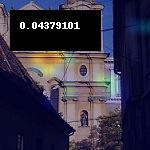

[[-166.64761  151.06784]]
predicted class:  NOT DAMAGED
DSI Score:  0.01615475


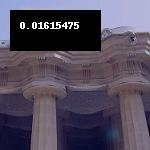

[[-136.8888   117.91646]]
predicted class:  NOT DAMAGED
DSI Score:  0.04662702


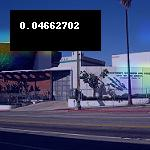

[[-357.41724  322.63037]]
predicted class:  NOT DAMAGED
DSI Score:  0.013250744


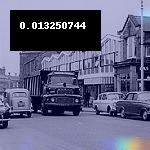

[[-127.57804   117.997055]]
predicted class:  NOT DAMAGED
DSI Score:  0.042571303


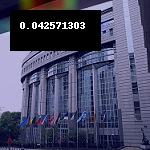

[[-322.644    294.73007]]
predicted class:  NOT DAMAGED
DSI Score:  0.0


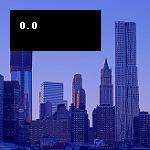

[[-118.93142  106.91026]]
predicted class:  NOT DAMAGED
DSI Score:  0.06086539


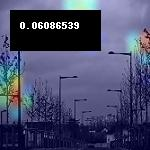

[[-259.3379   231.98958]]
predicted class:  NOT DAMAGED
DSI Score:  0.040434383


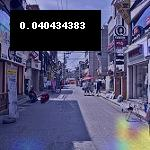

[[-257.08292  232.39798]]
predicted class:  NOT DAMAGED
DSI Score:  0.037128314


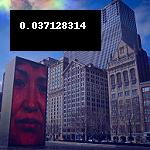

[[-81.48221  70.26585]]
predicted class:  NOT DAMAGED
DSI Score:  0.097425915


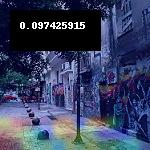

[[-234.96796  203.65823]]
predicted class:  NOT DAMAGED
DSI Score:  0.039869655


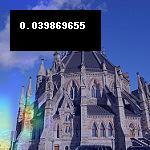

[[-221.80894  193.1624 ]]
predicted class:  NOT DAMAGED
DSI Score:  0.120962374


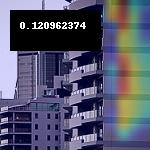

[[-147.8225   136.05396]]
predicted class:  NOT DAMAGED
DSI Score:  0.04317684


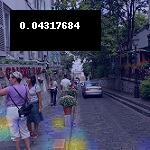

[[-141.49854  130.9833 ]]
predicted class:  NOT DAMAGED
DSI Score:  0.04204652


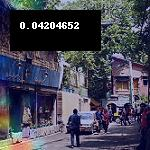

[[-378.10132  336.9299 ]]
predicted class:  NOT DAMAGED
DSI Score:  0.021863582


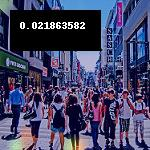

[[-126.30432   114.801895]]
predicted class:  NOT DAMAGED
DSI Score:  0.043382425


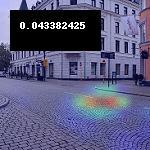

[[-165.84933  149.89825]]
predicted class:  NOT DAMAGED
DSI Score:  0.03066668


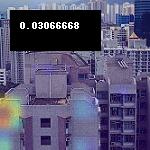

[[-259.84634  243.91629]]
predicted class:  NOT DAMAGED
DSI Score:  0.0052795378


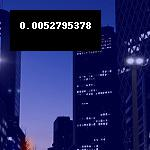

[[-235.7056   217.21204]]
predicted class:  NOT DAMAGED
DSI Score:  0.018328462


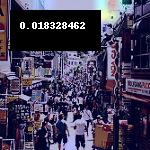

[[-155.92137  149.74956]]
predicted class:  NOT DAMAGED
DSI Score:  0.010986849


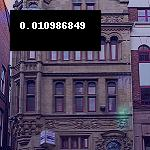

[[-197.63068  173.63199]]
predicted class:  NOT DAMAGED
DSI Score:  0.05228787


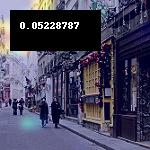

[[-100.77503   87.66453]]
predicted class:  NOT DAMAGED
DSI Score:  0.08653793


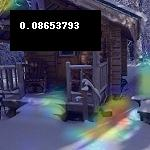

[[-147.17145  129.07666]]
predicted class:  NOT DAMAGED
DSI Score:  0.07013652


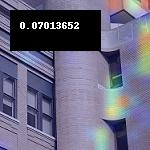

[[-236.55473  212.87569]]
predicted class:  NOT DAMAGED
DSI Score:  0.010049315


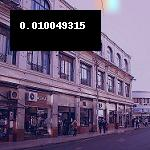

[[-128.38004  111.15553]]
predicted class:  NOT DAMAGED
DSI Score:  0.05002836


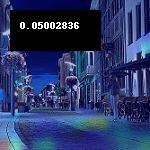

[[-182.5749  156.9309]]
predicted class:  NOT DAMAGED
DSI Score:  0.07593


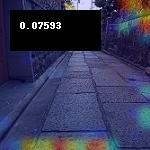

[[-350.05472  310.49667]]
predicted class:  NOT DAMAGED
DSI Score:  0.055747114


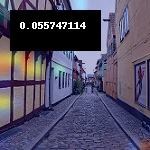

[[-122.25615  109.40026]]
predicted class:  NOT DAMAGED
DSI Score:  0.05294247


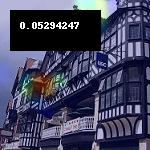

[[ 31.046808 -23.204147]]
predicted class:  DAMAGED
DSI Score:  0.106061056


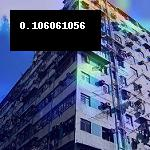

[[-124.628044  109.298615]]
predicted class:  NOT DAMAGED
DSI Score:  0.017943893


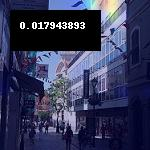

[[-361.28458  334.47598]]
predicted class:  NOT DAMAGED
DSI Score:  0.019228255


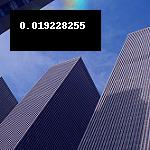

[[-198.71674  174.46794]]
predicted class:  NOT DAMAGED
DSI Score:  0.024228957


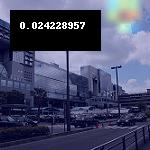

[[-286.27362  262.32492]]
predicted class:  NOT DAMAGED
DSI Score:  0.013605588


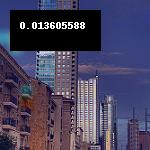

[[-350.79614  322.2139 ]]
predicted class:  NOT DAMAGED
DSI Score:  0.0


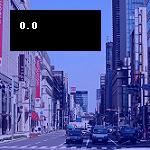

[[-323.43027  281.87558]]
predicted class:  NOT DAMAGED
DSI Score:  0.013773748


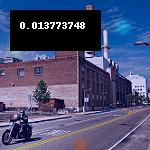

[[-107.60646   91.78909]]
predicted class:  NOT DAMAGED
DSI Score:  0.12326895


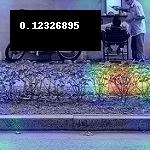

[[-73.97413   65.997856]]
predicted class:  NOT DAMAGED
DSI Score:  0.0905185


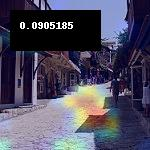

[[-521.9562  467.8962]]
predicted class:  NOT DAMAGED
DSI Score:  0.0


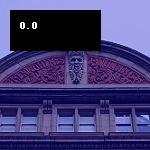

[[-158.23727  136.02614]]
predicted class:  NOT DAMAGED
DSI Score:  0.021010336


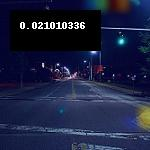

[[-47.834244  42.115047]]
predicted class:  NOT DAMAGED
DSI Score:  0.06519526


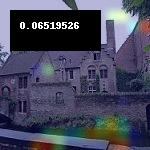

[[-165.52856  145.39832]]
predicted class:  NOT DAMAGED
DSI Score:  0.03621957


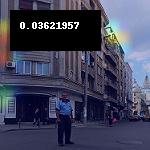

[[-232.6228   206.82687]]
predicted class:  NOT DAMAGED
DSI Score:  0.020762317


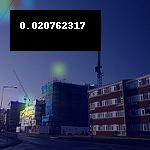

[[-162.57399  146.98856]]
predicted class:  NOT DAMAGED
DSI Score:  0.014878711


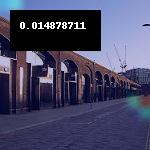

[[-7.8104897 12.182397 ]]
predicted class:  NOT DAMAGED
DSI Score:  0.10463662


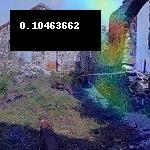

[[-124.42121   111.376076]]
predicted class:  NOT DAMAGED
DSI Score:  0.03834455


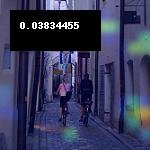

[[-417.93625  369.03598]]
predicted class:  NOT DAMAGED
DSI Score:  0.0071826116


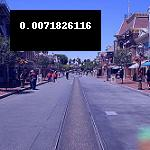

[[-120.33282  106.57907]]
predicted class:  NOT DAMAGED
DSI Score:  0.052920934


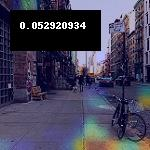

[[-255.13928  231.85724]]
predicted class:  NOT DAMAGED
DSI Score:  0.008555914


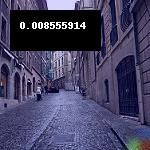

[[-171.08752  155.49048]]
predicted class:  NOT DAMAGED
DSI Score:  0.046771336


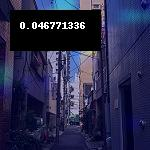

[[-207.33852  182.67201]]
predicted class:  NOT DAMAGED
DSI Score:  0.01928382


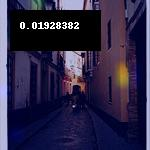

[[-205.64017  188.22818]]
predicted class:  NOT DAMAGED
DSI Score:  0.066252


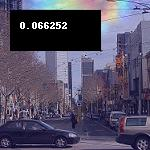

[[-339.7347  310.3296]]
predicted class:  NOT DAMAGED
DSI Score:  0.0076550804


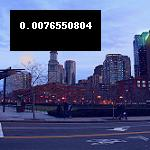

[[-216.54184  189.25246]]
predicted class:  NOT DAMAGED
DSI Score:  0.050252803


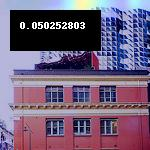

[[-399.24573  371.1909 ]]
predicted class:  NOT DAMAGED
DSI Score:  0.0051020407


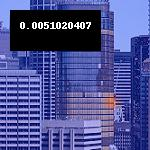

[[-254.81276  237.32556]]
predicted class:  NOT DAMAGED
DSI Score:  0.049174815


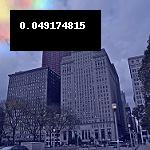

[[-277.82584  247.14362]]
predicted class:  NOT DAMAGED
DSI Score:  0.0056808987


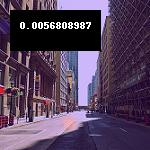

[[-94.34523   86.304726]]
predicted class:  NOT DAMAGED
DSI Score:  0.048858788


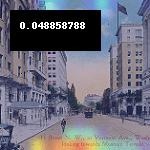

[[-220.00145  194.76015]]
predicted class:  NOT DAMAGED
DSI Score:  0.0


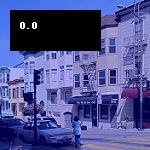

[[-229.97592  211.15039]]
predicted class:  NOT DAMAGED
DSI Score:  0.0051020407


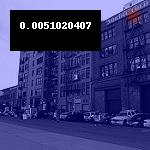

[[-418.85834  385.02982]]
predicted class:  NOT DAMAGED
DSI Score:  0.03543083


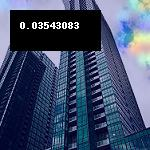

[[-254.62851  232.6433 ]]
predicted class:  NOT DAMAGED
DSI Score:  0.05919607


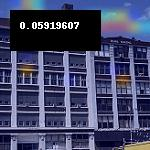

[[-245.91585  226.14629]]
predicted class:  NOT DAMAGED
DSI Score:  0.011114098


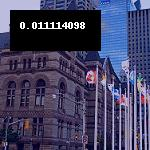

[[-148.26367  129.36865]]
predicted class:  NOT DAMAGED
DSI Score:  0.14205721


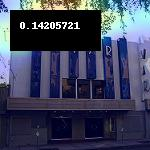

[[-348.9641   309.58975]]
predicted class:  NOT DAMAGED
DSI Score:  0.08042308


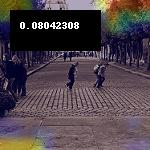

[[-31.829006  32.316284]]
predicted class:  NOT DAMAGED
DSI Score:  0.06606878


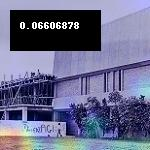

[[-254.41238  236.9687 ]]
predicted class:  NOT DAMAGED
DSI Score:  0.031642195


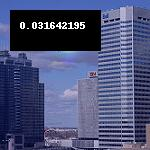

[[-72.013596  66.49543 ]]
predicted class:  NOT DAMAGED
DSI Score:  0.08723459


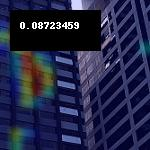

[[-220.17914  199.82884]]
predicted class:  NOT DAMAGED
DSI Score:  0.012919883


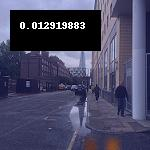

[[-182.43253  169.41058]]
predicted class:  NOT DAMAGED
DSI Score:  0.0063024894


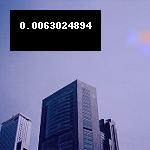

[[-233.28668  225.68245]]
predicted class:  NOT DAMAGED
DSI Score:  0.017733783


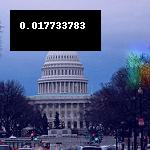

[[-226.75691  208.64247]]
predicted class:  NOT DAMAGED
DSI Score:  0.00939898


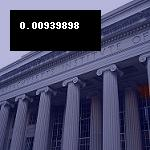

[[-351.82593  321.90396]]
predicted class:  NOT DAMAGED
DSI Score:  0.016566843


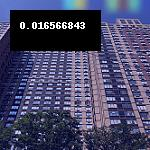

[[-307.2744  293.0625]]
predicted class:  NOT DAMAGED
DSI Score:  0.0


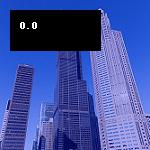

[[-220.27441  199.9892 ]]
predicted class:  NOT DAMAGED
DSI Score:  0.0059148814


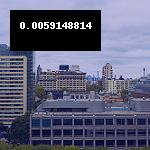

[[-177.7872   159.11827]]
predicted class:  NOT DAMAGED
DSI Score:  0.10194393


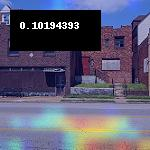

[[-160.32364  144.35999]]
predicted class:  NOT DAMAGED
DSI Score:  0.013509865


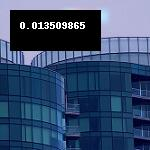

[[-373.43228  326.61755]]
predicted class:  NOT DAMAGED
DSI Score:  0.023701278


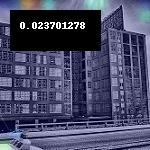

[[-232.62872  210.44687]]
predicted class:  NOT DAMAGED
DSI Score:  0.06384537


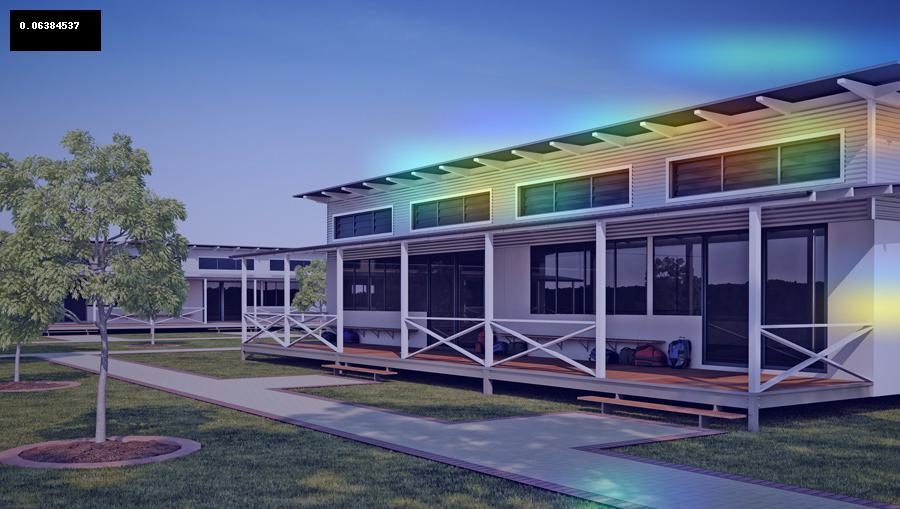

[[-475.48544  428.21753]]
predicted class:  NOT DAMAGED
DSI Score:  0.04755409


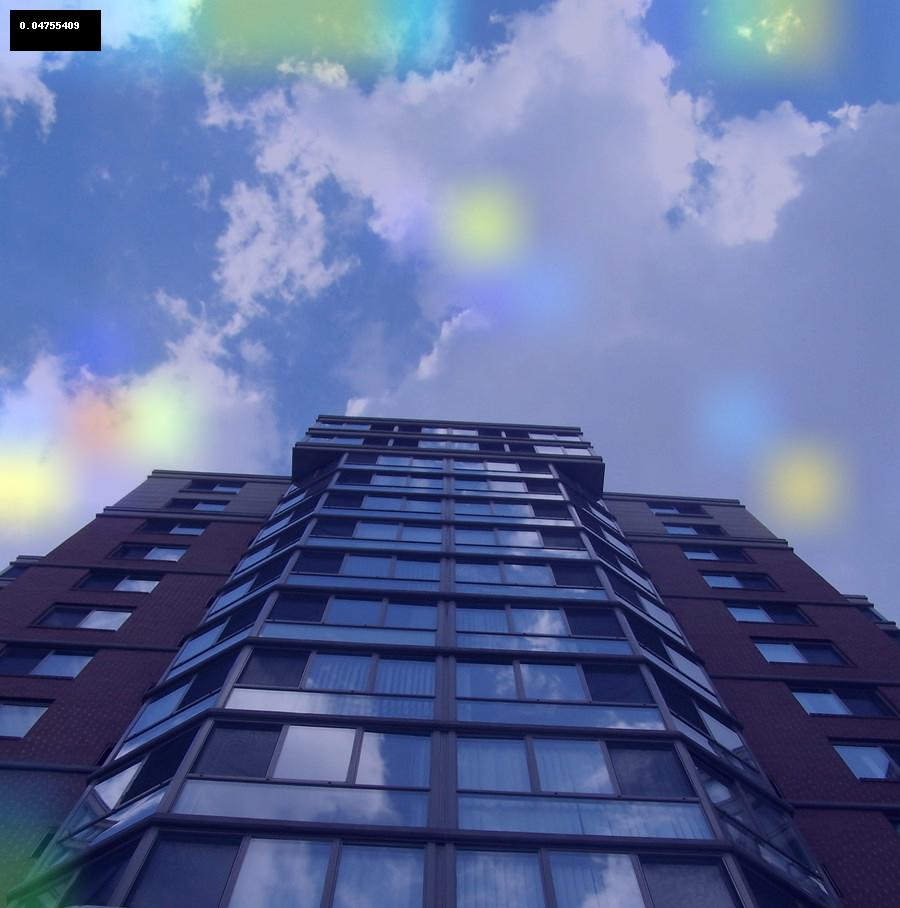

[[-125.02756  114.35549]]
predicted class:  NOT DAMAGED
DSI Score:  0.08820525


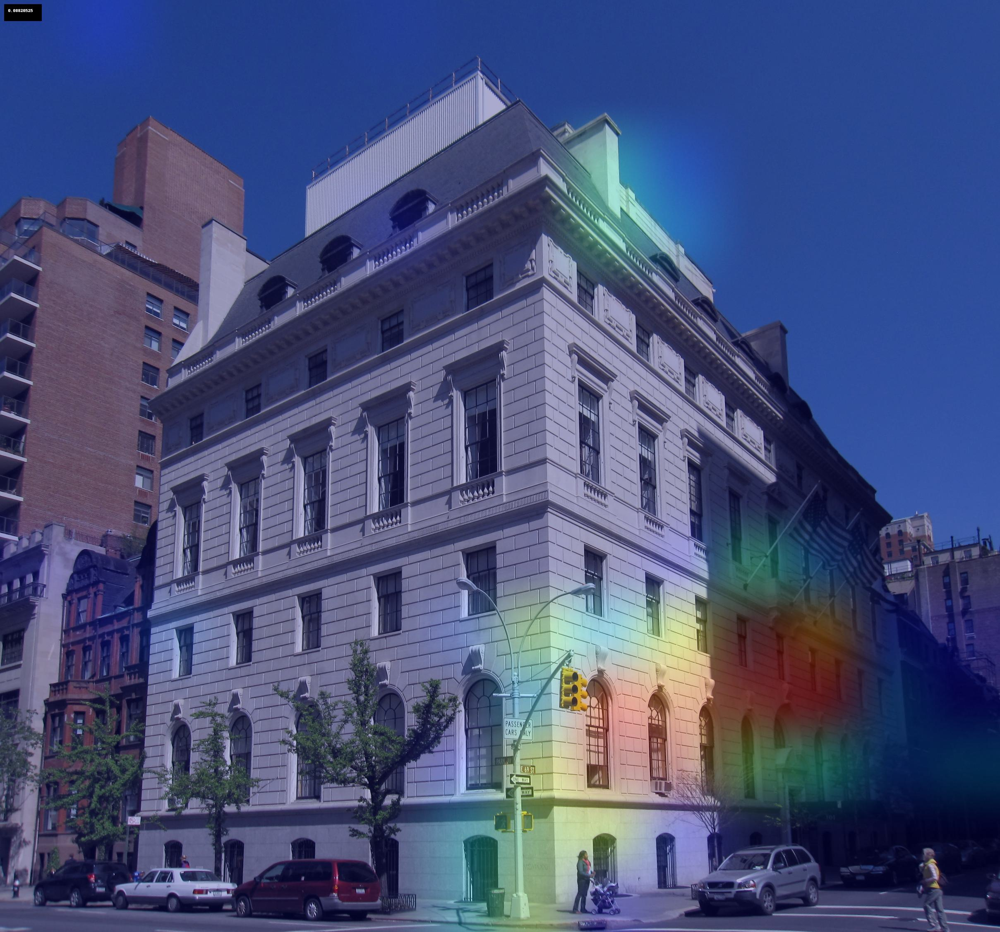

[[-430.51367  395.71255]]
predicted class:  NOT DAMAGED
DSI Score:  0.013865555


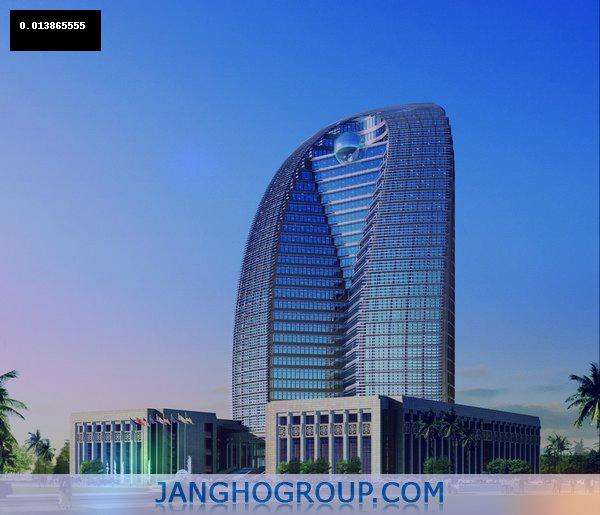

[[-196.99106  178.74997]]
predicted class:  NOT DAMAGED
DSI Score:  0.018746004


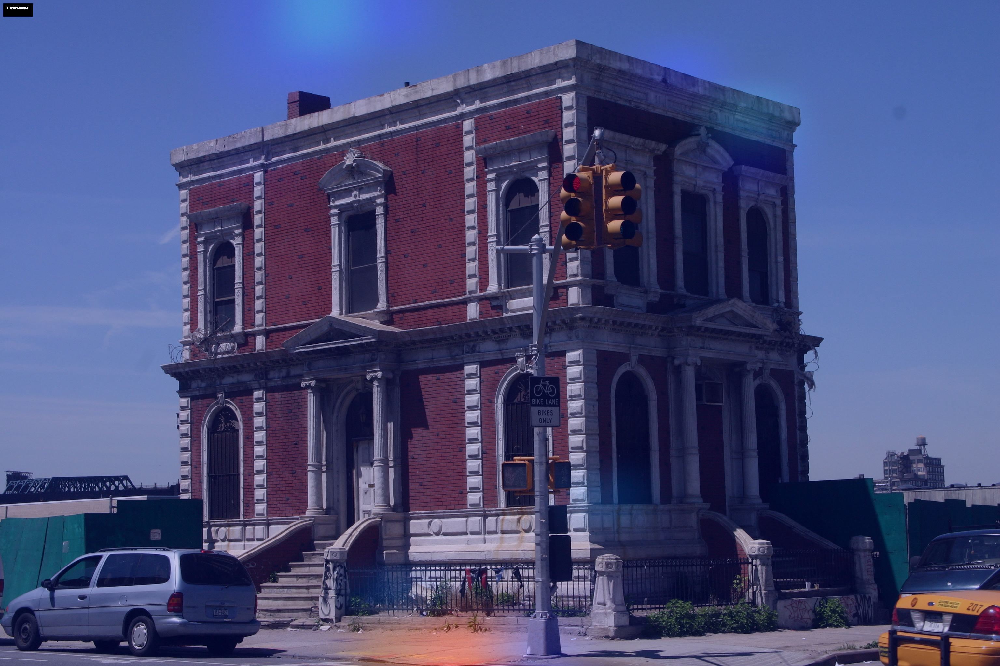

[[-165.06984  145.21483]]
predicted class:  NOT DAMAGED
DSI Score:  0.029724391


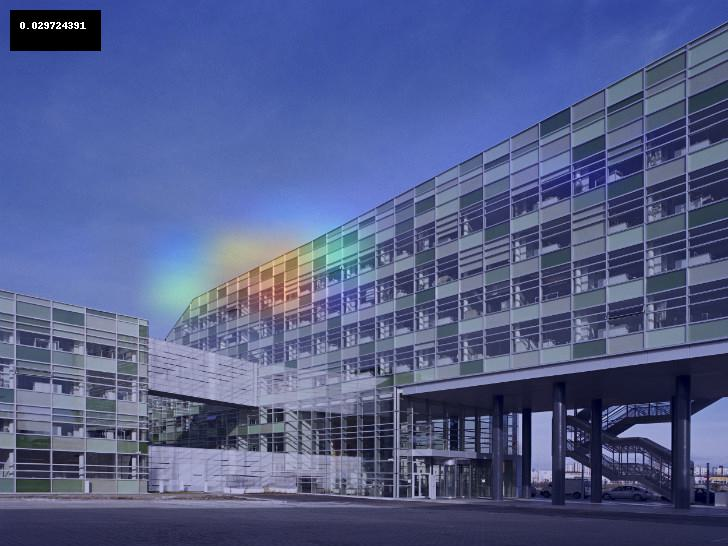

[[-19.695063  16.454193]]
predicted class:  NOT DAMAGED
DSI Score:  0.09613533


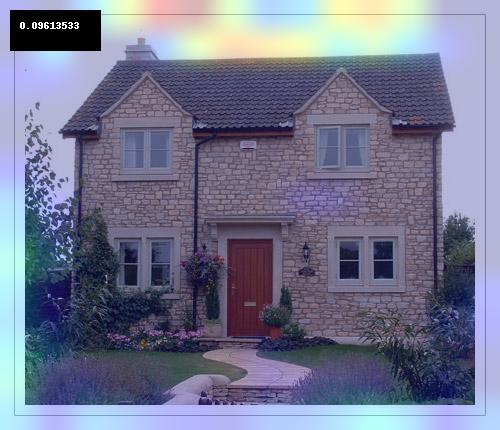

[[-215.58417  198.28148]]
predicted class:  NOT DAMAGED
DSI Score:  0.016680053


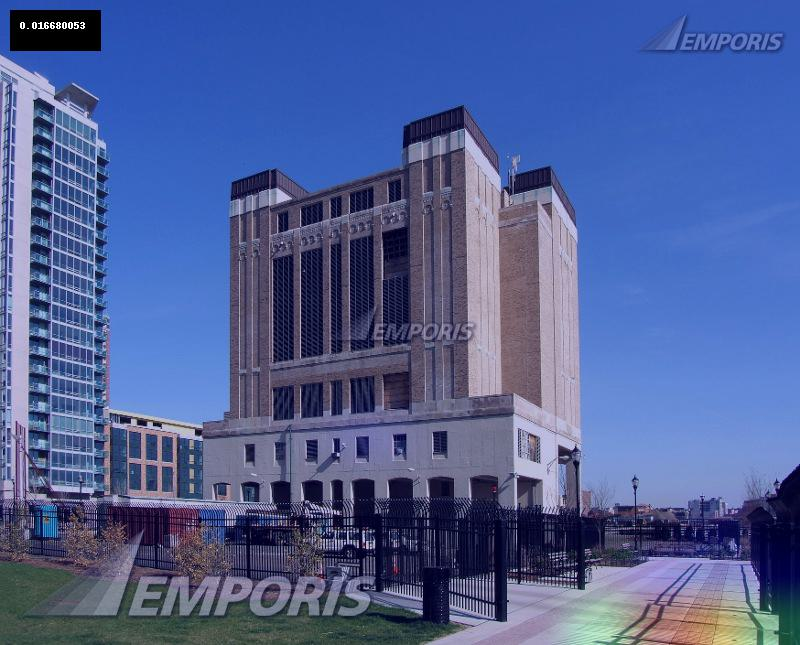

[[-227.22856  210.71414]]
predicted class:  NOT DAMAGED
DSI Score:  0.06581658


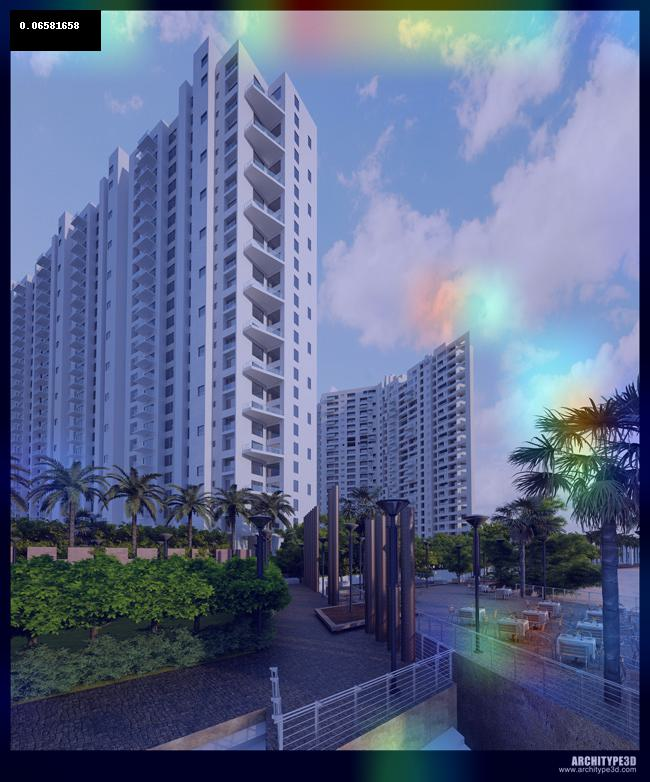

[[-141.00728  122.69263]]
predicted class:  NOT DAMAGED
DSI Score:  0.038175944


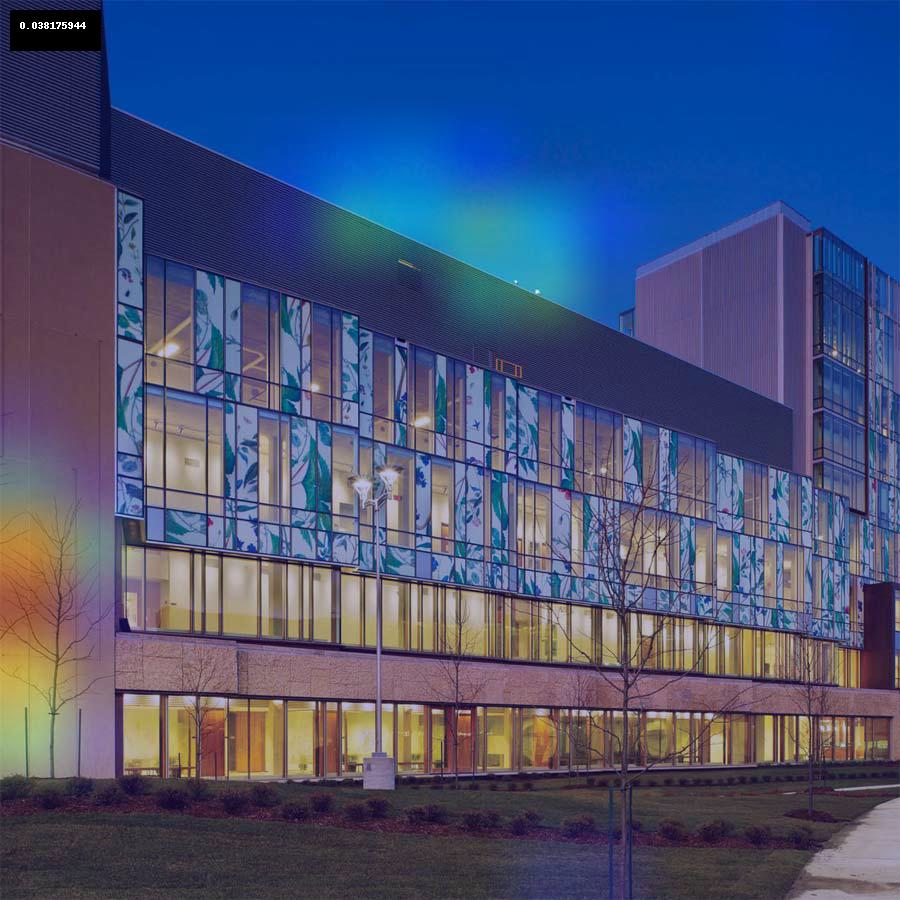

[[-295.28665  256.02975]]
predicted class:  NOT DAMAGED
DSI Score:  0.018343203


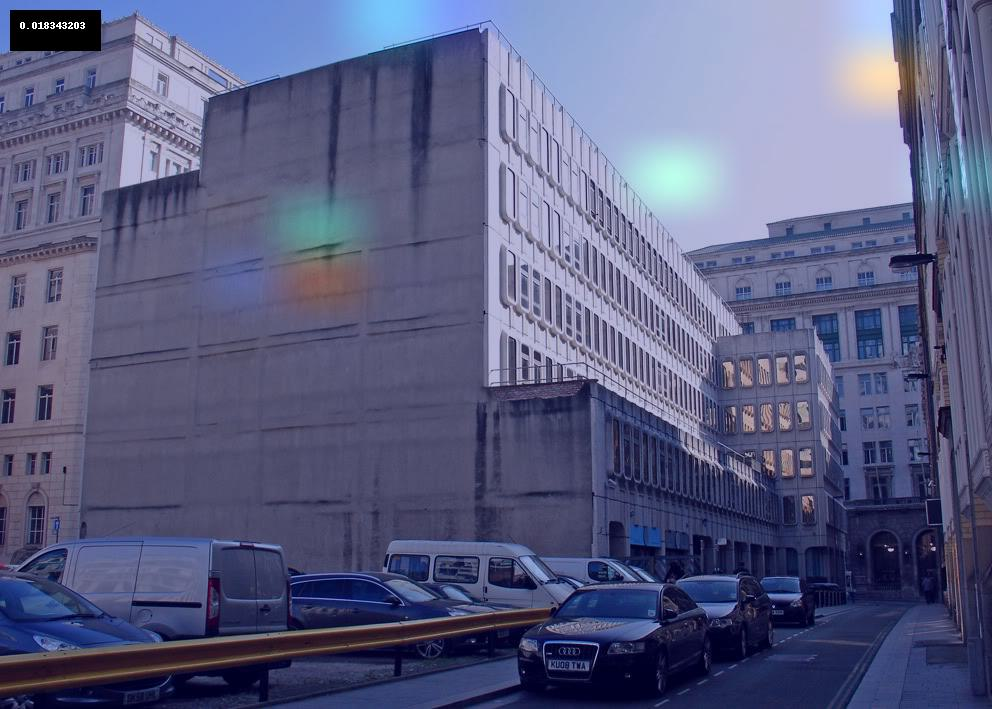

[[-647.69037  591.7464 ]]
predicted class:  NOT DAMAGED
DSI Score:  0.0


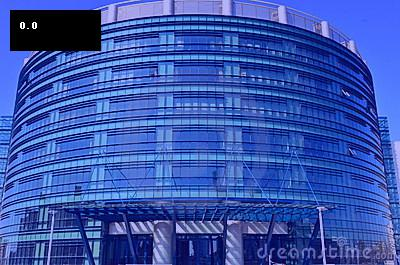

[[-260.0388   233.90549]]
predicted class:  NOT DAMAGED
DSI Score:  0.0


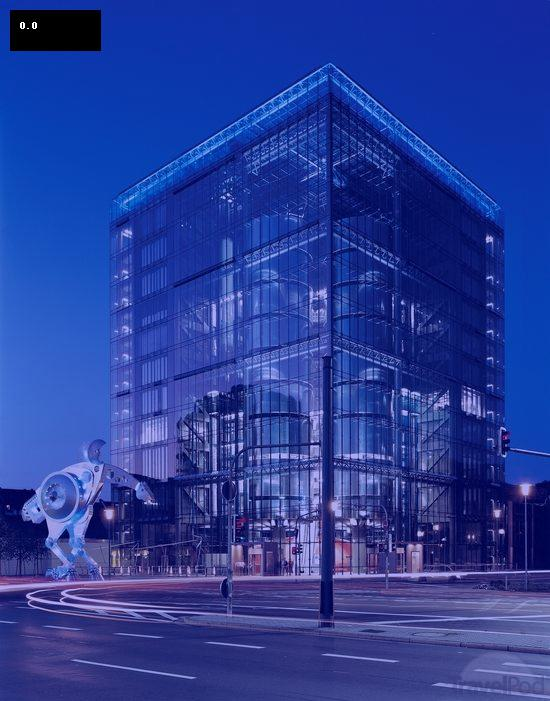

[[-180.67795  167.16016]]
predicted class:  NOT DAMAGED
DSI Score:  0.0083451895


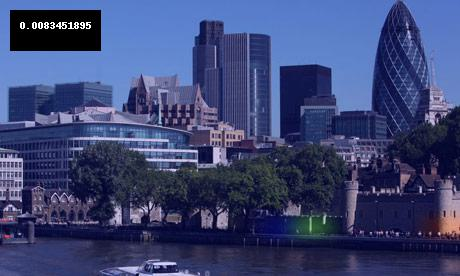

[[-213.03372  193.95088]]
predicted class:  NOT DAMAGED
DSI Score:  0.05270096


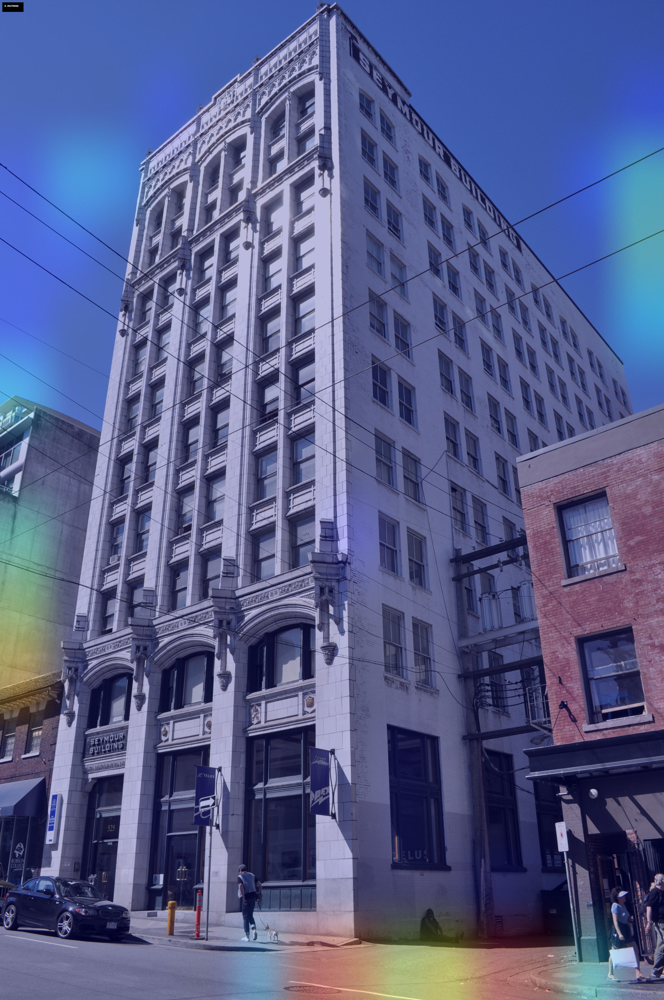

[[-199.96732  183.21982]]
predicted class:  NOT DAMAGED
DSI Score:  0.029592898


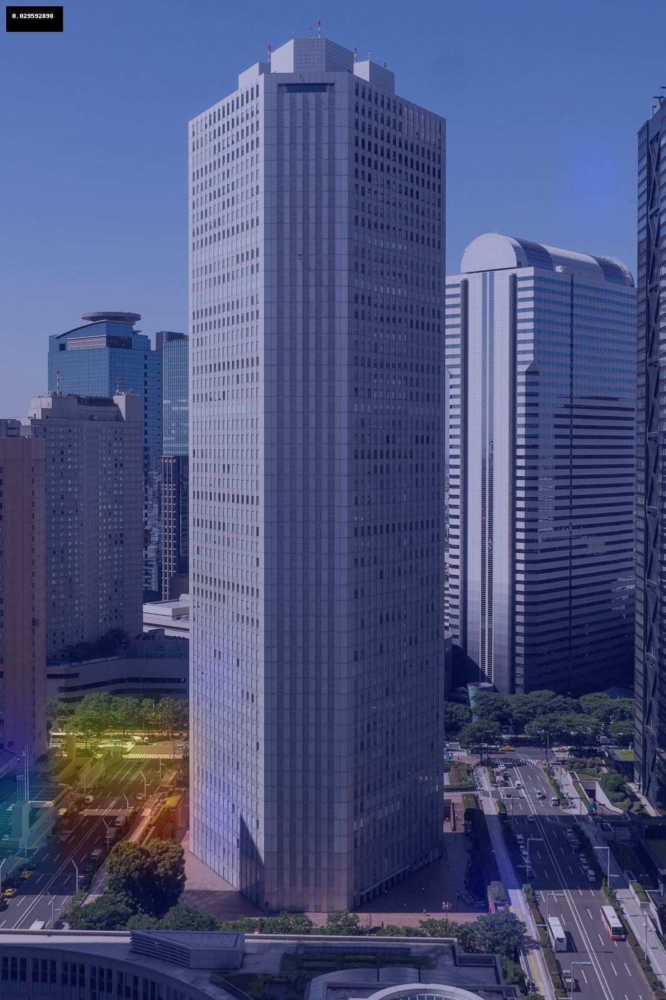

In [196]:
from pathlib import Path
import random

test_damage_images = [file for file in glob('final_dataset/test/damage/*')]
test_no_damage_images = [file for file in glob('final_dataset/test/no_damage/*')]
# test_damage_images = random.sample(test_damage_images, 1)
print(len(test_damage_images))
for image in test_damage_images:
    generate_grad_cam(image, should_save=True)
    
for image in test_no_damage_images:
    generate_grad_cam(image, should_save=True)

In [164]:
!echo %cd%

C:\Users\dskzr\Documents\vgg19-model
